In [2]:
import loompy
from numba import jit
from collections import Counter

import random
import os
import numpy as np
import pandas as pd
import scanpy as sc
import scipy
from skmisc.loess import loess
import matplotlib.pyplot as plt
import sklearn.preprocessing as preprocessing
import seaborn as sns
from sklearn.neighbors import NearestNeighbors, KDTree

from benchmark_scripts.metrics import calculate_metrics

import torch
import torch.autograd
import torch.nn as nn
from torch.autograd import Variable
import torch.nn.functional as F
from torch.utils.data import DataLoader
import torch.utils.data as data_utils

from annoy import AnnoyIndex

import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings('ignore')

# ACProp
from adabelief_pytorch import AdaBelief # Details of this optimizer can be found in: https://github.com/juntang-zhuang/Adabelief-Optimizer
import math
from torch.optim.optimizer import Optimizer 
from tabulate import tabulate
from colorama import Fore, Back, Style

version_higher = ( torch.__version__ >= "1.5.0" )


# Details of this optimizer can be found in: https://github.com/juntang-zhuang/ACProp-Optimizer
class ACProp(Optimizer):
    r"""Implements ACProp algorithm. Modified from AdaBelief in PyTorch
    Arguments:
        params (iterable): iterable of parameters to optimize or dicts defining
            parameter groups
        lr (float, optional): learning rate (default: 1e-3)
        betas (Tuple[float, float], optional): coefficients used for computing
            running averages of gradient and its square (default: (0.9, 0.999))
        eps (float, optional): term added to the denominator to improve
            numerical stability (default: 1e-16)
        weight_decay (float, optional): weight decay (L2 penalty) (default: 0)
        amsgrad (boolean, optional): whether to use the AMSGrad variant of this
            algorithm from the paper `On the Convergence of Adam and Beyond`_
            (default: False)
        weight_decouple (boolean, optional): ( default: True) If set as True, then
            the optimizer uses decoupled weight decay as in AdamW
        fixed_decay (boolean, optional): (default: False) This is used when weight_decouple
            is set as True.
            When fixed_decay == True, the weight decay is performed as
            $W_{new} = W_{old} - W_{old} \times decay$.
            When fixed_decay == False, the weight decay is performed as
            $W_{new} = W_{old} - W_{old} \times decay \times lr$. Note that in this case, the
            weight decay ratio decreases with learning rate (lr).
        rectify (boolean, optional): (default: True) If set as True, then perform the rectified
            update similar to RAdam
        degenerated_to_sgd (boolean, optional) (default:True) If set as True, then perform SGD update
            when variance of gradient is high
        print_change_log (boolean, optional) (default: True) If set as True, print the modifcation to
            default hyper-parameters
    """

    def __init__(self, params, lr=1e-3, betas=(0.9, 0.999), eps=1e-16,
                 weight_decay=0, amsgrad=False, weight_decouple=True, fixed_decay=False, rectify=True,
                 degenerated_to_sgd=True, momentum_update=False, bias_correction = False):

        
        if not 0.0 <= lr:
            raise ValueError("Invalid learning rate: {}".format(lr))
        if not 0.0 <= eps:
            raise ValueError("Invalid epsilon value: {}".format(eps))
        if not 0.0 <= betas[0] < 1.0:
            raise ValueError("Invalid beta parameter at index 0: {}".format(betas[0]))
        if not 0.0 <= betas[1] < 1.0:
            raise ValueError("Invalid beta parameter at index 1: {}".format(betas[1]))

        self.degenerated_to_sgd = degenerated_to_sgd
        if isinstance(params, (list, tuple)) and len(params) > 0 and isinstance(params[0], dict):
            for param in params:
                if 'betas' in param and (param['betas'][0] != betas[0] or param['betas'][1] != betas[1]):
                    param['buffer'] = [[None, None, None] for _ in range(10)]

        defaults = dict(lr=lr, betas=betas, eps=eps,
                        weight_decay=weight_decay, amsgrad=amsgrad, buffer=[[None, None, None] for _ in range(10)])
        super(ACProp, self).__init__(params, defaults)

        self.degenerated_to_sgd = degenerated_to_sgd
        self.weight_decouple = weight_decouple
        self.rectify = rectify
        self.fixed_decay = fixed_decay
        self.momentum_update = momentum_update
        if self.weight_decouple:
            print('Weight decoupling enabled in AdaBelief')
            if self.fixed_decay:
                print('Weight decay fixed')
        if self.rectify:
            print('Rectification enabled in AdaBelief')
        if amsgrad:
            print('AMSGrad enabled in AdaBelief')

    def __setstate__(self, state):
        super(ACProp, self).__setstate__(state)
        for group in self.param_groups:
            group.setdefault('amsgrad', False)

    def step(self, closure=None):
        """Performs a single optimization step.
        Arguments:
            closure (callable, optional): A closure that reevaluates the model
                and returns the loss.
        """
        loss = None
        if closure is not None:
            loss = closure()

        for group in self.param_groups:
            for p in group['params']:
                if p.grad is None:
                    continue
                
                # cast data type
                half_precision = False
                if p.data.dtype == torch.float16:
                    half_precision = True
                    p.data = p.data.float()
                    p.grad = p.grad.float()

                grad = p.grad.data
                if grad.is_sparse:
                    raise RuntimeError(
                        'ACProp does not support sparse gradients, please consider SparseAdam instead')
                amsgrad = group['amsgrad']

                state = self.state[p]

                beta1, beta2 = group['betas']

                # State initialization
                if len(state) == 0:
                    state['step'] = 0
                    # Exponential moving average of gradient values
                    state['exp_avg'] = torch.zeros_like(p.data,memory_format=torch.preserve_format) \
                        if version_higher else torch.zeros_like(p.data)
                    # Exponential moving average of squared gradient values
                    state['exp_avg_var'] = torch.zeros_like(p.data,memory_format=torch.preserve_format) \
                        if version_higher else torch.zeros_like(p.data)
                    if amsgrad:
                        # Maintains max of all exp. moving avg. of sq. grad. values
                        state['max_exp_avg_var'] = torch.zeros_like(p.data,memory_format=torch.preserve_format) \
                            if version_higher else torch.zeros_like(p.data)
                
                # perform weight decay, check if decoupled weight decay
                if self.weight_decouple:
                    if not self.fixed_decay:
                        p.data.mul_(1.0 - group['lr'] * group['weight_decay'])
                    else:
                        p.data.mul_(1.0 - group['weight_decay'])
                else:
                    if group['weight_decay'] != 0:
                        grad.add_(p.data, alpha=group['weight_decay'])

                # get current state variable
                exp_avg, exp_avg_var = state['exp_avg'], state['exp_avg_var']

                state['step'] += 1
                bias_correction1 = 1 - beta1 ** state['step']
                bias_correction2 = 1 - beta2 ** (state['step']-1)

                # Update first and second moment running average
                exp_avg.mul_(beta1).add_(grad, alpha=1 - beta1)

                if amsgrad:
                    max_exp_avg_var = state['max_exp_avg_var']
                    # Maintains the maximum of all 2nd moment running avg. till now
                    torch.max(max_exp_avg_var, exp_avg_var.add_(group['eps']), out=max_exp_avg_var)

                    # Use the max. for normalizing running avg. of gradient
                    denom = (max_exp_avg_var.sqrt() / math.sqrt(bias_correction2)).add_(group['eps'])
                else:
                    if state['step']>1:
                        denom = (exp_avg_var.add_(group['eps']).sqrt() / math.sqrt(bias_correction2)).add_(group['eps'])
                
                # update
                if state['step']<=1:
                    p.data.add_(exp_avg/bias_correction1, alpha=-group['lr'])

                elif not self.rectify:
                    numerator = exp_avg if self.momentum_update else grad * bias_correction1
                    # Default update
                    step_size = group['lr'] / bias_correction1
                    p.data.addcdiv_( numerator, denom, value=-step_size)

                else:  # Rectified update, forked from RAdam
                    buffered = group['buffer'][int(state['step'] % 10)]
                    if state['step'] == buffered[0]:
                        N_sma, step_size = buffered[1], buffered[2]
                    else:
                        buffered[0] = state['step']
                        beta2_t = beta2 ** state['step']
                        N_sma_max = 2 / (1 - beta2) - 1
                        N_sma = N_sma_max - 2 * state['step'] * beta2_t / (1 - beta2_t)
                        buffered[1] = N_sma

                        # more conservative since it's an approximated value
                        if N_sma >= 5:
                            step_size = math.sqrt(
                                (1 - beta2_t) * (N_sma - 4) / (N_sma_max - 4) * (N_sma - 2) / N_sma * N_sma_max / (
                                        N_sma_max - 2)) / (1 - beta1 ** state['step'])
                        elif self.degenerated_to_sgd:
                            step_size = 1.0 / (1 - beta1 ** state['step'])
                        else:
                            step_size = -1
                        buffered[2] = step_size

                    if N_sma >= 5:
                        numerator = exp_avg if self.momentum_update else grad * bias_correction1
                        denom = exp_avg_var.sqrt().add_(group['eps'])
                        p.data.addcdiv_(numerator, denom, value=-step_size * group['lr'])
                    elif step_size > 0:
                        p.data.add_( exp_avg, alpha=-step_size * group['lr'])

                grad_residual = grad - exp_avg
                exp_avg_var.mul_(beta2).addcmul_( grad_residual, grad_residual, value=1 - beta2)

                if half_precision:
                    p.data = p.data.half()
                    p.grad = p.grad.half() 

        return loss

class Mish(nn.Module):
    def __init__(self):
        super().__init__()

    def forward(self,x):
        return x*torch.tanh(F.softplus(x))

#WGAN model, and it does not need to use bath normalization based on WGAN paper.
class discriminator(nn.Module):
    def __init__(self, N = 2000):
        super(discriminator, self).__init__()
        self.dis = nn.Sequential(
            nn.Linear(N, 1024),  
            Mish(),
            nn.Linear(1024, 512),  
            Mish(),
            nn.Linear(512, 256),  
            Mish(),
            nn.Linear(256, 128),  
            Mish(),
            nn.Linear(128, 1)

        )

    def forward(self, x):
        x = self.dis(x)
        return x
 
 
# WGAN generator
# Require batch normalization
class generator(nn.Module):
    def __init__(self, N=2000):
        super(generator, self).__init__()
        self.relu_f = nn.ReLU(True)
        self.mish_f = Mish()
        self.gen1 = nn.Sequential(
                    nn.Linear(N, 1024),
                    nn.BatchNorm1d(1024),
                    Mish())
        self.gen2 = nn.Sequential(
                    nn.Linear(1024, 512),
                    nn.BatchNorm1d(512),
                    Mish())
        self.gen3 = nn.Sequential(
                    nn.Linear(512, 256),
                    nn.BatchNorm1d(256),
                    Mish())
        self.gen4 = nn.Linear(256, 512)
        self.gen5 = nn.Linear(512, 1024)
        self.gen6 = nn.Linear(1024, N)
        
#         self.gen = nn.Sequential(
#             nn.Linear(N, 1024),
#             nn.BatchNorm1d(1024),
#             Mish(),

#             #nn.Dropout(0.5),
#             nn.Linear(1024, 512),  
#             nn.BatchNorm1d(512),
#             Mish(),
    

#             nn.Linear(512, 256),  
#             nn.BatchNorm1d(256),
#             Mish(),


#             nn.Linear(256, 512),  
#             nn.BatchNorm1d(512),
#             Mish(),

#             nn.Linear(512, 1024),  
#             nn.BatchNorm1d(1024),
#             Mish(),

#             nn.Linear(1024, N),
#             #nn.Dropout(0.5)
#         )

    def forward(self, x):
        x1 = self.gen1(x)
        x2 = self.gen2(x1)
        x3 = self.gen3(x2)
        x4 = self.mish_f(self.gen4(x3) + x2)
        x5 = self.mish_f(self.gen5(x4) + x1)
        gre = self.gen6(x5)
        
        return self.relu_f(gre+x)    #residual network
    
class generator(nn.Module):
    def __init__(self, N=2000):
        super(generator, self).__init__()
        self.relu_f = nn.ReLU(True)
        self.mish_f = Mish()
        self.gen1 = nn.Sequential(
                    nn.Linear(N, 1024),
                    nn.BatchNorm1d(1024),
                    Mish())
        self.gen2 = nn.Sequential(
                    nn.Linear(1024, 512),
                    nn.BatchNorm1d(512),
                    Mish())
        self.gen3 = nn.Sequential(
                    nn.Linear(512, 256),
                    nn.BatchNorm1d(256),
                    Mish())
        self.gen4 = nn.Sequential(
                    nn.Linear(256, 512),
                    nn.BatchNorm1d(512),
                    )
        self.gen5 = nn.Sequential(
                    nn.Linear(512, 1024),
                    nn.BatchNorm1d(1024),
                    )
        self.gen6 = nn.Linear(1024, N)

    def forward(self, x):
        x1 = self.gen1(x)
        x2 = self.gen2(x1)
        x3 = self.gen3(x2)
        x4 = self.mish_f(self.gen4(x3) + x2)
        x5 = self.mish_f(self.gen5(x4) + x1)
        gre = self.gen6(x5)
        
        return self.relu_f(gre+x)    #residual network

# calculate gradient penalty
def calculate_gradient_penalty(real_data, fake_data, D, center=1, p=2): 
    eta = torch.FloatTensor(real_data.size(0),1).uniform_(0,1) 
    eta = eta.expand(real_data.size(0), real_data.size(1)) 
    cuda = True if torch.cuda.is_available() else False 
    if cuda: 
        eta = eta.cuda() 
    else: 
        eta = eta 
    interpolated = eta * real_data + ((1 - eta) * fake_data) 
    if cuda: 
        interpolated = interpolated.cuda() 
    else: 
        interpolated = interpolated 
    # define it to calculate gradient 
    interpolated = Variable(interpolated, requires_grad=True) 
    # calculate probability of interpolated examples 
    prob_interpolated = D(interpolated) 
    # calculate gradients of probabilities with respect to examples 
    gradients = torch.autograd.grad(outputs=prob_interpolated, inputs=interpolated, 
                                grad_outputs=torch.ones( 
                                  prob_interpolated.size()).cuda() if cuda else torch.ones( 
                                  prob_interpolated.size()), 
                                create_graph=True, retain_graph=True)[0] 
    grad_penalty = ((gradients.norm(2, dim=1) - center) ** p).mean() 
    return grad_penalty

@jit(nopython = True)
def determine_batch(val1):
    val_list =[1024,512,256,128,64,32]
    for i in val_list:
        if val1%i !=1:
            return i
        else:
            continue
    return val1

def weights_init_normal(m):
    classname = m.__class__.__name__
    if classname.find("Linear") != -1:
        torch.nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find("BatchNorm") != -1:
        torch.nn.init.normal_(m.weight.data, 1.0, 0.02)
        torch.nn.init.constant_(m.bias.data, 0.0)

from sklearn.utils import shuffle
def WGAN_train(label_data, train_data, epoch, batch, lambda_1, query_data, n_critic=100, 
               b1=0.5, b2=0.9, lr=0.0001, opt='AdamW'):

    D = discriminator(N=2000)
    G = generator(N=2000)

    if torch.cuda.is_available():
        D = D.cuda()
        G = G.cuda()

    lr = lr
#     D.apply(weights_init_normal)
#     G.apply(weights_init_normal)
    
    if opt == 'ACProp':
        d_optimizer = ACProp(D.parameters(), lr=lr, betas=(b1, b2))
        g_optimizer = ACProp(G.parameters(), lr=lr, betas=(b1, b2)) 
    elif opt == 'AdaBelief':
        d_optimizer = AdaBelief(D.parameters(), lr=lr, betas=(b1, b2))
        g_optimizer = AdaBelief(G.parameters(), lr=lr, betas=(b1, b2))
    else:
        d_optimizer = torch.optim.AdamW(D.parameters(), lr=lr, betas=(b1, b2))
        g_optimizer = torch.optim.AdamW(G.parameters(), lr=lr, betas=(b1, b2))  
    G.train()
    D.train()
    
    #batch = determine_batch(MAX_ITER)

    for epoch in range(epoch):
        
        sample_index = np.random.choice(len(label_data), size=min(10*1024, len(label_data)), replace=False)
        label_data_sample = label_data[sample_index]
        train_data_sample = train_data[sample_index]
        
#         batch = determine_batch(train_data_sample.shape[0])

#         MAX_ITER = train_data_sample.shape[0]
#         print(MAX_ITER)

        label_data_sample = torch.FloatTensor(label_data_sample).cuda()
        train_data_sample = torch.FloatTensor(train_data_sample).cuda()
        
        training_set = data_utils.TensorDataset(train_data_sample, label_data_sample)
        dataloader = DataLoader(training_set, batch_size=batch)
        
        for i, (false_data, true_data) in enumerate(dataloader):
            # train D

            d_optimizer.zero_grad()

            real_out = D(true_data)
            real_loss = -torch.mean(real_out)

            fake_data = G(false_data)
            fake_out = D(fake_data)
            fake_loss = torch.mean(fake_out)

            div = calculate_gradient_penalty(true_data, fake_data, D, center = 1)    # sample from G(fake)

            D_loss = real_loss + fake_loss + div/lambda_1
            D_loss.backward()

            # err_D.append(label_loss.cpu().item())

            d_optimizer.step()

            # train G
            
            if i % n_critic == 0:
#                 print('Train G for batch ', i)

                fake_data = G(false_data)
                fake_out = D(fake_data)
                
                G_loss = -torch.mean(fake_out)
                    
                # err_G.append(real_loss1.cpu().item())

                g_optimizer.zero_grad()
                G_loss.backward()
                g_optimizer.step()

        if epoch % 50 == 0:
            print("This is epoch: ", epoch)
            print("d step loss: ", D_loss)
            print("g step loss: ", G_loss)

    print("Train step finished")
    G.eval()
    test_data = torch.FloatTensor(query_data).cuda()
    test_list = G(test_data).detach().cpu().numpy()    
    return test_list, G

# dimensional reduction tools
from sklearn import preprocessing
def cca_seurat(X, Y, n_components=20, normalization=True):
    X = preprocessing.scale(X, axis=0)
    Y = preprocessing.scale(Y, axis=0)
    X = preprocessing.scale(X, axis=1)
    Y = preprocessing.scale(Y, axis=1)
    mat = X @ Y.T
#     if normalization:
#         mat = preprocessing.scale(mat)
    k = n_components
    u,sig,v = np.linalg.svd(mat,full_matrices=False)
    sigma = np.diag(sig)
    return np.dot(u[:,:k],np.sqrt(sigma[:k,:k])), np.dot(v.T[:,:k], np.sqrt(sigma[:k,:k]))

from sklearn.decomposition import PCA #same as probabilistc pca
def pca_reduction(X, Y, n_components=20, normalization=True):
    mat = np.vstack([X,Y])
    L1 = len(X)
    if normalization:
        mat = preprocessing.scale(mat)
    model = PCA(n_components=n_components)
    pca_fit = model.fit_transform(mat)
    return pca_fit[0:L1,:],pca_fit[L1:,:]

from sklearn.decomposition import KernelPCA
def kpca_reduction(X, Y, n_components=20, kernel='cosine', normalization=True):
    mat = np.vstack([X,Y])
    L1 = len(X)
    if normalization:
        mat = preprocessing.scale(mat)
    kpca = KernelPCA(n_components = n_components, kernel=kernel)
    kpca_fit = kpca.fit_transform(mat)
    return kpca_fit[0:L1,:],kpca_fit[L1:,:]

def rpca_reduction(X, Y, n_components=20, normalization=True):
    if normalization:
        X = preprocessing.scale(X)
        Y = preprocessing.scale(Y)
    U1,S1,V1 = np.linalg.svd(X)
    U2,S2,V2 = np.linalg.svd(Y)
    results1 = []
    results2 = []
    # Project X onto X's PCA space
    results1.append(X@V1[0:n_components,:].T)
    # Project X onto Y's PCA space
    results1.append(X@V2[0:n_components,:].T)
    # Project Y onto X's PCA space
    results2.append(Y@V1[0:n_components,:].T)
    # Project Y onto Y's PCA space
    results2.append(Y@V2[0:n_components,:].T)
    return results1, results2

#NNP or MNN
def acquire_pairs(X, Y, ref_data, query_data, mode='MNN', metric='angular', k=None, 
                  filtering = True, k_filter=100):
    X = preprocessing.normalize(X,axis=1)
    Y = preprocessing.normalize(Y,axis=1)
    t1 = KDTree(X)
    t2 = KDTree(Y)
    
    ref_index = []
    query_index = []

    if mode == 'NNP':
        # If mode is NNP find k NNPs in X for each cell in Y
        if not k:
            k = 1
        sorted_mat2 = t1.query(Y,k,return_distance=False) #x index
        for i in range(len(sorted_mat2)):
            for j in sorted_mat2[i]:
                ref_index.append(j)
                query_index.append(i)
    elif mode == 'MNN':
        # If mode is MNN find cell pairs with one cell in X and another Y that
        # are within each other's kNN set.
        if not k:
            k = int(min(X.shape[0], Y.shape[0])/200)
        sorted_mat2 = np.array(t1.query(Y,k,return_distance=False)) #x index
        sorted_mat1 = np.array(t2.query(X,k,return_distance=False)) #y index
        for i in range(len(sorted_mat2)):
            for j in sorted_mat2[i]:
                if i in sorted_mat1[j]:
                    ref_index.append(j)
                    query_index.append(i)
    else:
        print('Mode should be either NNP or MNN.')
    print('Number of %s pairs is %d' % (mode, len(ref_index)))
        
    if filtering and reduction is not None:
        print('Start filtering of selected pairs')
        pairs = [(x,y) for x,y in zip(ref_index, query_index)]
        pairs = filter_pairs(ref_data, query_data, pairs, k=k_filter, reduction=reduction, 
                             ref_reduced=X, query_reduced=Y)
        print('Number of pairs after filtering is %d.' % len(pairs))
        ref_index = [x for x,y in pairs]
        query_index = [y for x,y in pairs]
        
    return ref_index, query_index

# def acquire_pairs(X, Y, mode='MNN', metric='angular', k=None):
    
#     if isinstance(X, list):     
#         f = X[0].shape[1]
#         t1 = AnnoyIndex(f, metric)
#         t2 = AnnoyIndex(f, metric)
#         for i in range(len(X[0])):
#             t1.add_item(i, X[0][i])
#         for i in range(len(Y[1])):
#             t2.add_item(i, Y[1][i])
#         X = X[1]
#         Y = Y[0]
#     else:
#         f = X.shape[1]
#         t1 = AnnoyIndex(f, metric)
#         t2 = AnnoyIndex(f, metric)
#         for i in range(len(X)):
#             t1.add_item(i, X[i])
#         for i in range(len(Y)):
#             t2.add_item(i, Y[i])
            
#     t1.build(10)
#     t2.build(10)
    
#     ref_index = []
#     query_index = []

#     if mode == 'NNP':
#         # If mode is NNP find k NNPs in X for each cell in Y
#         if not k:
#             k = 1
#         sorted_mat2 = np.array([t1.get_nns_by_vector(item, k) for item in Y]) #x index
#         for i in range(len(sorted_mat2)):
#             for j in sorted_mat2[i]:
#                 ref_index.append(j)
#                 query_index.append(i)
#     elif mode == 'MNN':
#         # If mode is MNN find cell pairs with one cell in X and another Y that
#         # are within each other's kNN set.
#         if not k:
#             k = int(min(X.shape[0], Y.shape[0])/200)
#         sorted_mat2 = np.array([t1.get_nns_by_vector(item, k) for item in Y]) #x index
#         sorted_mat1 = np.array([t2.get_nns_by_vector(item, k) for item in X]) #y index
#         for i in range(len(sorted_mat2)):
#             for j in sorted_mat2[i]:
#                 if i in sorted_mat1[j]:
#                     ref_index.append(j)
#                     query_index.append(i)
#     else:
#         print('Mode should be either NNP or MNN.')
        
#     return ref_index, query_index

def create_pairs_dict(pairs):
    pairs_dict = {}
    for x,y in pairs:
        if x not in pairs_dict.keys():
            pairs_dict[x] = [y]
        else:
            pairs_dict[x].append(y)
    return pairs_dict

# def acquire_rwmnn_pairs(X, Y, k, metric):
#     f = X.shape[1]
#     t1 = AnnoyIndex(f, metric)
#     t2 = AnnoyIndex(f, metric)
#     for i in range(len(X)):
#         t1.add_item(i, X[i])
#     for i in range(len(Y)):
#         t2.add_item(i, Y[i])
#     t1.build(10)
#     t2.build(10)

#     mnn_mat = np.bool8(np.zeros((len(X), len(Y))))
#     sorted_mat = np.array([t2.get_nns_by_vector(item, k) for item in X])
#     for i in range(len(sorted_mat)):
#         mnn_mat[i,sorted_mat[i]] = True
#     _ = np.bool8(np.zeros((len(X), len(Y))))
#     sorted_mat = np.array([t1.get_nns_by_vector(item, k) for item in Y])
#     for i in range(len(sorted_mat)):
#         _[sorted_mat[i],i] = True
#     mnn_mat = np.logical_and(_, mnn_mat)
#     pairs = [(x, y) for x, y in zip(*np.where(mnn_mat>0))]
#     return pairs

def acquire_rwmnn_pairs(X, Y, k, metric):
    X = preprocessing.normalize(X,axis=1)
    Y = preprocessing.normalize(Y,axis=1)
    t1 = KDTree(X)
    t2 = KDTree(Y)
    mnn_mat = np.bool8(np.zeros((len(X), len(Y))))
    sorted_mat = np.array(t2.query(X,k,return_distance=False))
    for i in range(len(sorted_mat)):
        mnn_mat[i,sorted_mat[i]] = True
    _ = np.bool8(np.zeros((len(X), len(Y))))
    sorted_mat = np.array(t1.query(Y,k,return_distance=False))
    for i in range(len(sorted_mat)):
        _[sorted_mat[i],i] = True
    mnn_mat = np.logical_and(_, mnn_mat)
    pairs = [(x, y) for x, y in zip(*np.where(mnn_mat>0))]
    return pairs

# def calculate_rwmnn_pairs(X, Y, ref_data, query_data, metric='angular', k1 = None, k2 = None):
#     tmp = np.arange(len(X))
#     np.random.shuffle(tmp)
#     tmp2 = np.arange(len(Y))
#     np.random.shuffle(tmp2)
    
#     X = X[tmp]
#     Y = Y[tmp2]
#     if k2 is None:
#         k2 = max(int(min(len(ref_data), len(query_data))/100), 1)
#     if k1 is None:
#         k1 = max(int(k2/2), 1)

#     print('Calculating Anchor Pairs...')
#     anchor_pairs = acquire_rwmnn_pairs(X,X, k2, metric)
#     print('Calculating Query Pairs...')
#     query_pairs = acquire_rwmnn_pairs(Y,Y, k2, metric)
#     print('Calculating KNN Pairs...')
#     pairs = acquire_rwmnn_pairs(X,Y, k1, metric)
#     print('Number of MNN pairs is %d' % len(pairs))
#     print('Calculating Random Walk Pairs...')
#     anchor_pairs_dict = create_pairs_dict(anchor_pairs)
#     query_pairs_dict = create_pairs_dict(query_pairs)
#     pair_plus = []
#     for x, y in pairs:
#         start = (x, y)
#         for i in range(50):
#             pair_plus.append(start)
#             start = (np.random.choice(anchor_pairs_dict[start[0]]), np.random.choice(query_pairs_dict[start[1]]))

#     query_result = query_data[tmp2][[y for x,y in pair_plus], :]
#     reference_result = ref_data[tmp][[x for x,y in pair_plus], :]
#     print('Done.')
#     return reference_result, query_result

def top_features(X, Y, n_components=20, features_per_dim=10, normalization=True):
    mat = np.vstack([X,Y])
    if normalization:
        mat = preprocessing.scale(mat)
    model = PCA(n_components=n_components)
    pca_fit = model.fit_transform(mat)
    feature_loadings = model.components_[:n_components]
    top_features_index = np.unique((-np.abs(feature_loadings)).argsort(axis=1)[:,:features_per_dim])
    return top_features_index

def top_features_cca(X, Y, X_cca, Y_cca, n_components=20, features_per_dim=10, normalization=True):
    mat_cca = np.vstack([X_cca, Y_cca])
    if normalization:
        mat = np.vstack([preprocessing.scale(X),preprocessing.scale(Y)])
    else:
        mat = np.vstack([X,Y])
    feature_loadings = mat_cca.T @ mat
    top_features_index = np.unique((-np.abs(feature_loadings)).argsort(axis=1)[:,:features_per_dim])
    return top_features_index

def filter_pairs(ref, query, pairs, k=200, n_components=20, features_per_dim=10, reduction='pca', 
                ref_reduced = None, query_reduced=None):
    ref_index = [x for x,y in pairs]
    query_index = [y for x,y in pairs]
    if reduction == 'cca':
        top_features_index = top_features_cca(ref, query, ref_reduced, query_reduced,
                                              n_components=n_components, features_per_dim=features_per_dim)
    else:
        top_features_index = top_features(ref, query, n_components=n_components, features_per_dim=features_per_dim)
    ref = ref[:,top_features_index]
    query = query[:,top_features_index]
    ref = preprocessing.normalize(ref, axis=1)
    query = preprocessing.normalize(query, axis=1)
    t1 = KDTree(ref)
    sorted_mat = np.array(t1.query(query[query_index],k,return_distance=False))
    
    ref_index_filtered = []
    query_index_filtered = []
    pairs_filtered = []
    for i, j in zip(range(len(sorted_mat)), ref_index):
        if j in sorted_mat[i]:
            pairs_filtered.append((j, query_index[i]))

    return pairs_filtered

def score_pairs(ref, query, pairs, k=30):
    ref_index = [x for x,y in pairs]
    query_index = [y for x,y in pairs]
    ref = preprocessing.normalize(ref,axis=1)
    query = preprocessing.normalize(query,axis=1)
    t1 = KDTree(ref)
    t2 = KDTree(query)
    sorted_mat_11 = np.array(t1.query(ref[ref_index],k,return_distance=False))
    sorted_mat_12 = np.array(t1.query(query[query_index],k,return_distance=False))
    sorted_mat_22 = np.array(t2.query(query[query_index],k,return_distance=False))
    sorted_mat_21 = np.array(t2.query(ref[ref_index],k,return_distance=False))
    scores = []
    for i in range(len(pairs)):
        scores.append(len(set(sorted_mat_11[i]).intersection(sorted_mat_12[i])) + 
                      len(set(sorted_mat_21[i]).intersection(sorted_mat_22[i])))
    scores = np.array(scores)
    print(scores.min(), scores.max())
    min_score = np.quantile(scores, 0.01)
    max_score = np.quantile(scores, 0.9)
    scores = (scores - min_score)/(max_score - min_score)
    scores[scores > 1] = 1
    scores[scores < 0] = 0
    return scores

def calculate_rwmnn_pairs(X, Y, ref_data, query_data, metric='angular', k1 = None, k2 = None, 
                          filtering = True, k_filter=100, reduction='pca'):

    if k2 is None:
        k2 = max(int(min(len(ref_data), len(query_data))/100), 1)
    if k1 is None:
        k1 = max(int(k2/2), 1)

    print('Calculating Anchor Pairs...')
    anchor_pairs = acquire_rwmnn_pairs(X,X, k2, metric)
    print('Calculating Query Pairs...')
    query_pairs = acquire_rwmnn_pairs(Y,Y, k2, metric)
    print('Calculating KNN Pairs...')
    pairs = acquire_rwmnn_pairs(X,Y, k1, metric)
    print('Number of MNN pairs is %d' % len(pairs))
    
    print('Calculating Random Walk Pairs...')
    anchor_pairs_dict = create_pairs_dict(anchor_pairs)
    query_pairs_dict = create_pairs_dict(query_pairs)
    pair_plus = []
    for x, y in pairs:
        start = (x, y)
        for i in range(50):
            pair_plus.append(start)
            start = (np.random.choice(anchor_pairs_dict[start[0]]), np.random.choice(query_pairs_dict[start[1]]))
    
    if filtering and reduction is not None:
        print('Start filtering of selected pairs')
        pair_plus = filter_pairs(ref_data, query_data, pair_plus, k=k_filter, reduction=reduction, 
                             ref_reduced=X, query_reduced=Y)
        print('Number of rwMNN pairs after filtering is %d.' % len(pair_plus))
        
#     query_result = query_data[[y for x,y in pair_plus], :]
#     reference_result = ref_data[[x for x,y in pair_plus], :]
    ref_index = [x for x,y in pair_plus]
    query_index = [y for x,y in pair_plus]
    print('Done.')
    return ref_index, query_index

def training_set_generator(ref, query, reduction=None, mode='MNN', metric='angular', subsample=None,
                           k=None, k1=None, k2=None, norm=True, filtering=True):
    ref_reduced, query_reduced = None,None
    if subsample:
        len_ref = len(ref)
        len_query = len(query)
        thre = max(len_ref, len_query)
        if thre>subsample:
            tmp = np.arange(len_ref)
            np.random.shuffle(tmp)
            tmp2 = np.arange(len_query)
            np.random.shuffle(tmp2)
            ref = ref[tmp][:subsample]
            query = query[tmp2][:subsample]
        
    if reduction == 'cca':
        ref_reduced, query_reduced = cca_seurat(ref, query,normalization=norm)
    elif reduction == 'pca':
        ref_reduced, query_reduced = pca_reduction(ref, query,normalization=norm)
    elif reduction == 'kpca':
        ref_reduced, query_reduced = kpca_reduction(ref, query,normalization=norm)
    elif reduction == 'rpca':
        ref_reduced, query_reduced = rpca_reduction(ref, query,normalization=norm)
    elif reduction is None:
        ref_reduced, query_reduced = ref, query
        
    if mode == 'rwMNN':
        ref_index, query_index = calculate_rwmnn_pairs(ref_reduced, query_reduced, ref, query, k1=k1, k2=k2, 
                                                       filtering=filtering, reduction=reduction)
    else:
        ref_index, query_index = acquire_pairs(ref_reduced, query_reduced, ref, query, mode=mode, metric=metric, 
                                               k=k, filtering=filtering, reduction=reduction)
    print('Dimension of paired data is %d.' % len(ref_index))
    
    return ref[ref_index], query[query_index]

def order_selection(adata, key='batch', orders=None):
    if orders == None:
        batch_list = list(set(adata.obs[key].values))
        adata_values = [np.array(adata.X[adata.obs[key] == batch]) for batch in batch_list]
        std_ = [np.sum(np.std(item, axis=0)) for item in adata_values]
        orders = np.argsort(std_)[::-1]
        return [batch_list[i] for i in orders] 
    else:
        return orders

def generate_target_dataset(adata, batch_list):
    adata0 = adata[adata.obs['batch'] == batch_list[0]]
    for i in batch_list[1:]:
        adata0 = adata0.concatenate(adata[adata.obs['batch'] == i], batch_key='batch_key', index_unique=None)
    return adata0

def sequencing_train(adata, key='batch', order=None, epoch=300, batch=1024,
                     lambda_1=1/10, mode='MNN', metric='angular', 
                     reduction='pca', subsample=3000, k=None, k1=None, k2=None,
                     n_critic=100, seed=999, b1=0.9, b2=0.999, lr=0.0001, opt='AdamW',
                     filtering=True):
    
    # Set a seed
    random.seed(seed)
    np.random.seed(seed)
    os.environ['PYTHONHASHEED'] = str(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True # for CNN
    
    if not order:
        order = order_selection(adata, key=key)
    print('The sequential mapping order will be: ', order)
        
    adata = generate_target_dataset(adata, order)
    ref_data_ori = adata[adata.obs['batch'] == order[0]].X

    for bat in order[1:]:
        print("##########################Training %s#####################"%(bat))
        batch_data_ori = adata[adata.obs['batch'] == bat].X
        label_data, train_data = training_set_generator(ref_data_ori, batch_data_ori, reduction=reduction,
                                                       mode=mode, metric=metric, subsample=subsample, 
                                                        k=k, k1=k1, k2=k2, filtering=filtering)
        print("#################Finish Pair finding##########################")
        remove_batch_data, G_tar = WGAN_train(label_data, train_data, epoch, batch, lambda_1, batch_data_ori,
                                             n_critic=n_critic, b1=b1, b2=b2, lr=lr, opt=opt)
        ref_data_ori = np.vstack([ref_data_ori, remove_batch_data])
    print("###################### Finish Training ###########################")
    
    adata_new = sc.AnnData(ref_data_ori)
    adata_new.obs['batch'] = list(adata.obs['batch'])
    if adata.obs.columns.str.contains('celltype').any():
        adata_new.obs['celltype'] = list(adata.obs['celltype'])
    adata_new.var_names = adata.var_names
    adata_new.var_names.name = 'Gene'
    adata_new.obs_names = adata.obs_names
    adata_new.obs_names.name = 'CellID'
    
    return adata_new


# adata

# adata = data_preprocess(adata,'batch')

# data_correct = sequencing_train(adata, mode='MNN', k=30, reduction=None, epoch=300, 
#                                 recon=True, sim=True, knn_sim=True, k_sim=10)

# adata_correct.write_h5ad('CL_wgan.h5ad')


['Sim2']




baseline Sim2




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)


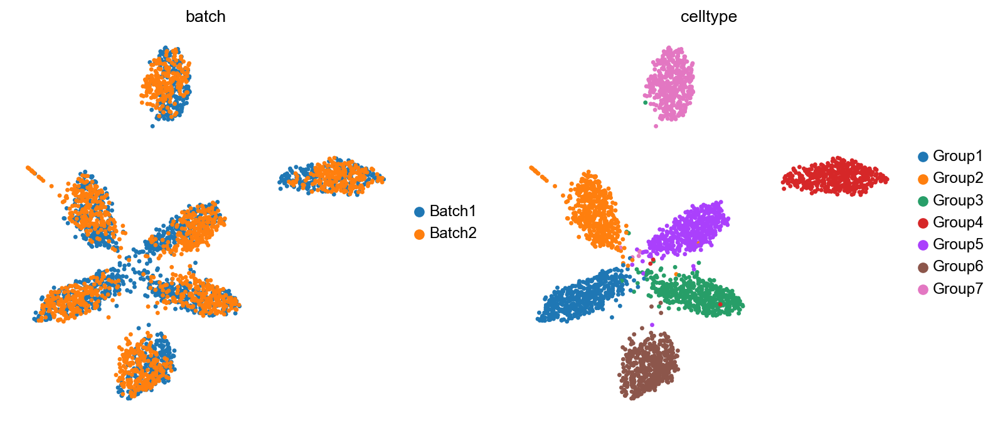

15


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.387479
cASW                        0.608060
F1 ASW                      0.473333
bLISI                       0.583653
1-cLISI                     0.984671
F1 LISI                     0.732892
kBET Accept Rate            0.312751
graph connectivity          0.997789
ARI                         0.965916
NMI                         0.954225
CC score                         NaN
HVG score                   0.659000
knn sim                     0.079069
cell-cell sim preservation  0.684715
exp sim                     0.836560
pos rate                    0.987910
true pos rate               0.596564
DEG precision               0.465102
DEG recall                  0.066786
DEG F1                      0.116452
Avg score (batch)           0.575647
Avg score (bio)             0.687658
Weighted score              0.642854




rare1_0.5 Sim2




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)


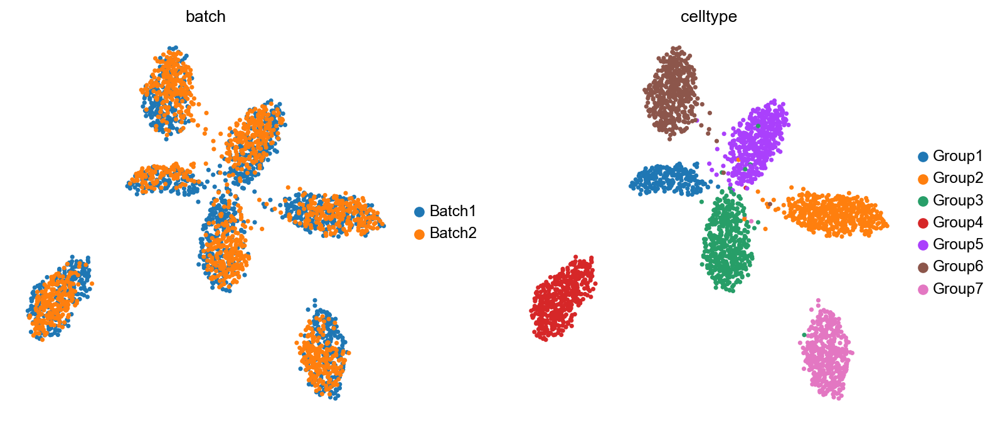

14


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.386802
cASW                        0.613244
F1 ASW                      0.474386
bLISI                       0.545937
1-cLISI                     0.982876
F1 LISI                     0.701967
kBET Accept Rate            0.295471
graph connectivity          0.998436
ARI                         0.971279
NMI                         0.959563
CC score                         NaN
HVG score                   0.651000
knn sim                     0.080723
cell-cell sim preservation  0.685532
exp sim                     0.839885
pos rate                    0.990055
true pos rate               0.548697
DEG precision               0.484235
DEG recall                  0.064807
DEG F1                      0.113761
Avg score (batch)           0.555068
Avg score (bio)             0.688792
Weighted score              0.635303




rare1_0.2 Sim2




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)


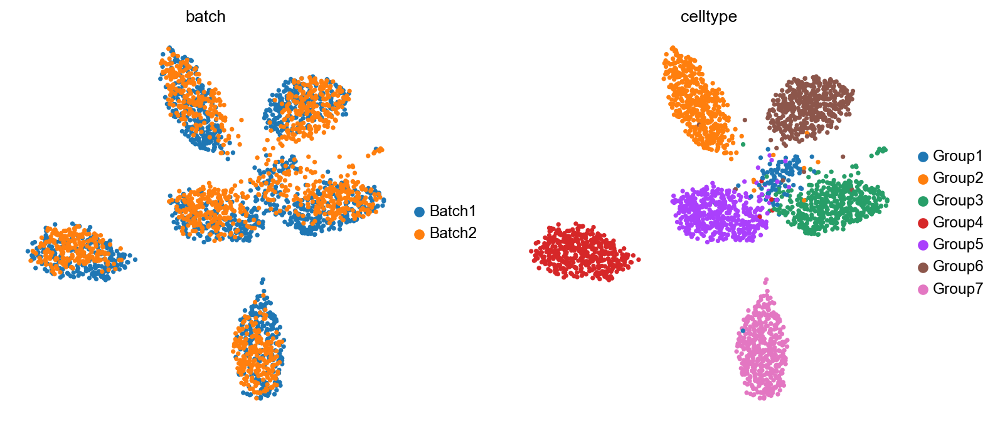

13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.386494
cASW                        0.573870
F1 ASW                      0.461903
bLISI                       0.540556
1-cLISI                     0.974714
F1 LISI                     0.695437
kBET Accept Rate            0.289799
graph connectivity          0.994343
ARI                         0.945004
NMI                         0.921460
CC score                         NaN
HVG score                   0.645000
knn sim                     0.071402
cell-cell sim preservation  0.685968
exp sim                     0.830085
pos rate                    0.969773
true pos rate               0.544440
DEG precision               0.503187
DEG recall                  0.061328
DEG F1                      0.106597
Avg score (batch)           0.551127
Avg score (bio)             0.672387
Weighted score              0.623883




rare1_0.1 Sim2




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)


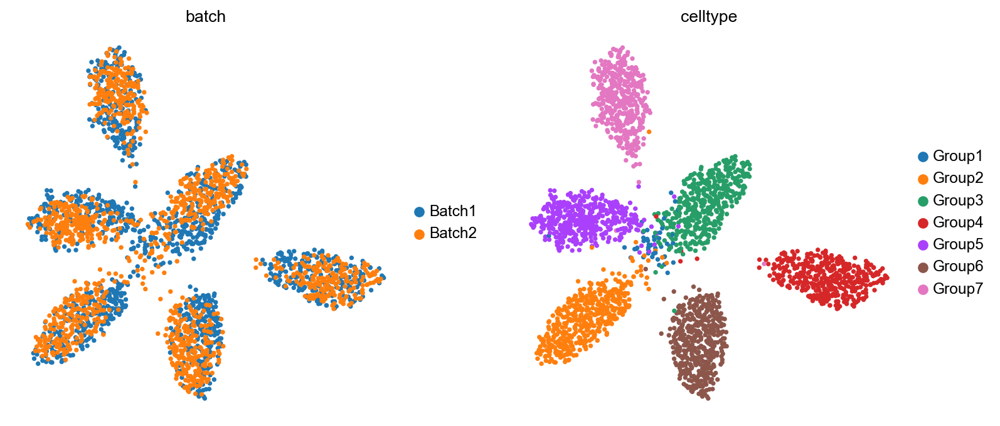

13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.386108
cASW                        0.570074
F1 ASW                      0.460394
bLISI                       0.516463
1-cLISI                     0.973809
F1 LISI                     0.674959
kBET Accept Rate            0.271268
graph connectivity          0.986591
ARI                         0.953979
NMI                         0.931322
CC score                         NaN
HVG score                   0.662000
knn sim                     0.069304
cell-cell sim preservation  0.685173
exp sim                     0.828108
pos rate                    0.970373
true pos rate               0.540600
DEG precision               0.539292
DEG recall                  0.060195
DEG F1                      0.104557
Avg score (batch)           0.540206
Avg score (bio)             0.674870
Weighted score              0.621004




common_5 Sim2




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)


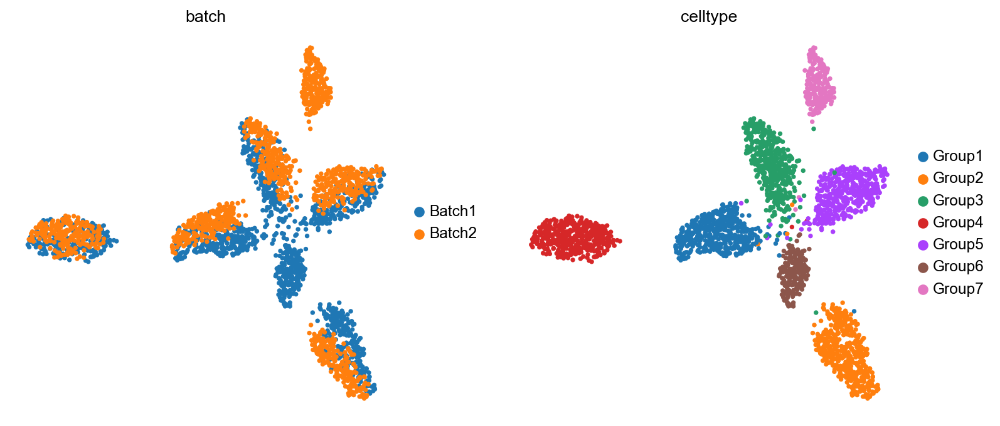

Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.370681
cASW                        0.610445
F1 ASW                      0.461267
bLISI                       0.362457
1-cLISI                     0.985017
F1 LISI                     0.529919
kBET Accept Rate            0.213614
graph connectivity          0.998101
ARI                         0.965439
NMI                         0.950892
CC score                         NaN
HVG score                   0.699000
knn sim                     0.085012
cell-cell sim preservation  0.703830
exp sim                     0.496165
pos rate                    0.984404
true pos rate               0.418492
DEG precision               0.298682
DEG recall                  0.069821
DEG F1                      0.110655
Avg score (batch)           0.472669
Avg score (bio)             0.659086
Weighted score              0.584519




common_3 Sim2




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)


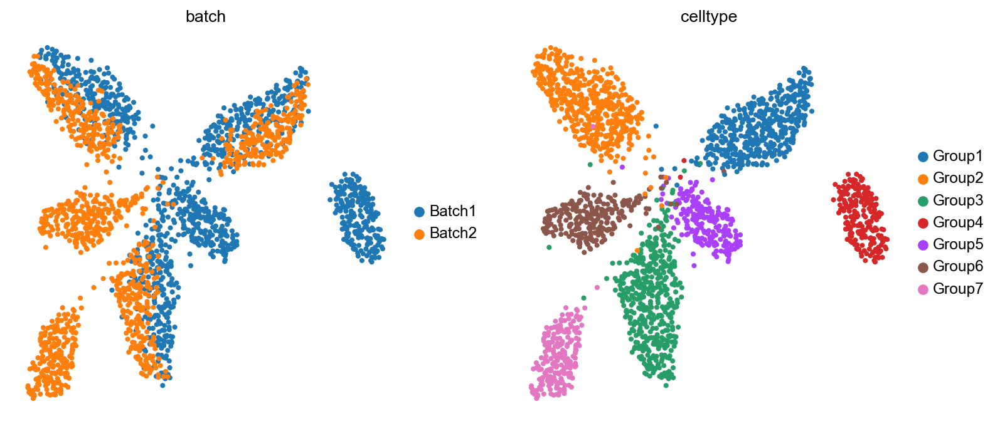

Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group5 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group4 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
11


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.371896
cASW                        0.569994
F1 ASW                      0.450113
bLISI                       0.378718
1-cLISI                     0.974284
F1 LISI                     0.545423
kBET Accept Rate            0.194732
graph connectivity          0.996156
ARI                         0.943462
NMI                         0.923711
CC score                         NaN
HVG score                   0.709000
knn sim                     0.076328
cell-cell sim preservation  0.710563
exp sim                     0.512430
pos rate                    0.979700
true pos rate               0.588261
DEG precision               0.249459
DEG recall                  0.068007
DEG F1                      0.105199
Avg score (batch)           0.505953
Avg score (bio)             0.650467
Weighted score              0.592661




common_1 Sim2




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)


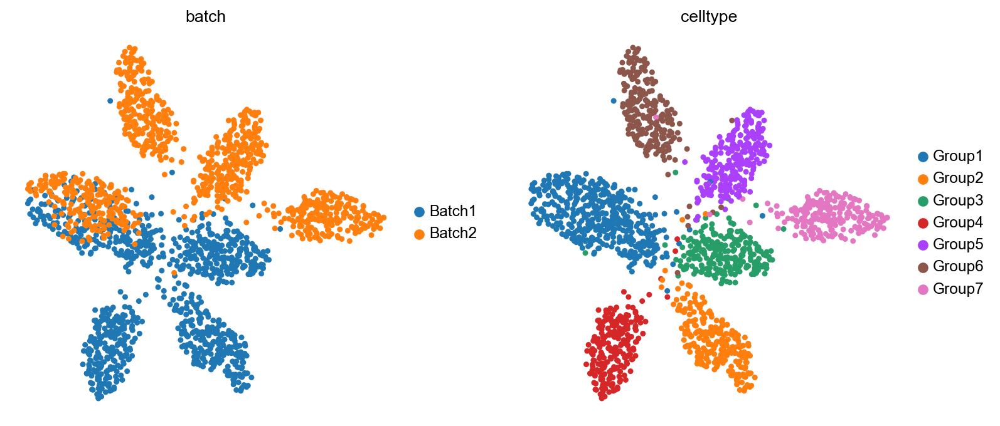

Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group5 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group4 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group3 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group2 contains only one batch or has less than 10 cells. Skip.
9


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.376771
cASW                        0.567836
F1 ASW                      0.452980
bLISI                       0.427422
1-cLISI                     0.962660
F1 LISI                     0.591997
kBET Accept Rate            0.224783
graph connectivity          0.998148
ARI                         0.927741
NMI                         0.910847
CC score                         NaN
HVG score                   0.718812
knn sim                     0.062050
cell-cell sim preservation  0.726167
exp sim                     0.469119
pos rate                    0.981552
true pos rate               0.842648
DEG precision               0.174188
DEG recall                  0.070257
DEG F1                      0.097801
Avg score (batch)           0.573954
Avg score (bio)             0.642458
Weighted score              0.615057




batch1_1000 Sim2




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)


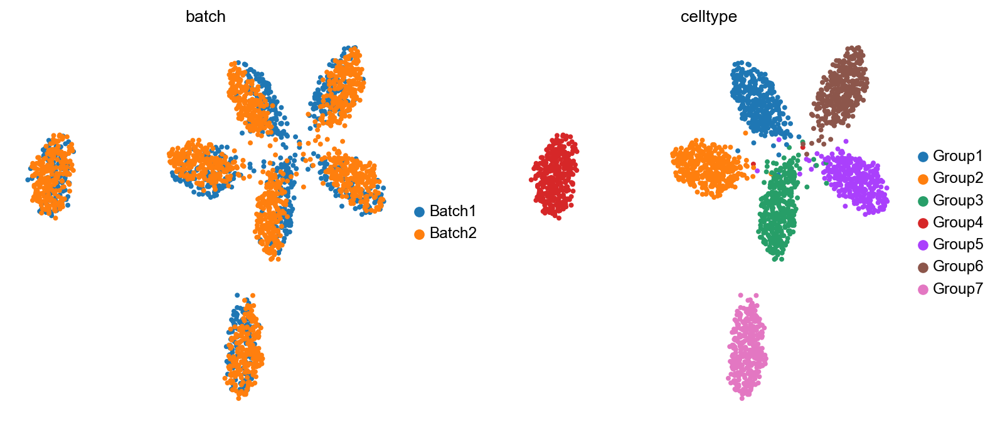

7


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.355501
cASW                        0.604114
F1 ASW                      0.447603
bLISI                       0.280385
1-cLISI                     0.981485
F1 LISI                     0.436168
kBET Accept Rate            0.236207
graph connectivity          0.998738
ARI                         0.961449
NMI                         0.950509
CC score                         NaN
HVG score                   0.701000
knn sim                     0.060881
cell-cell sim preservation  0.712880
exp sim                     0.856760
pos rate                    0.987675
true pos rate               0.487888
DEG precision               0.300320
DEG recall                  0.064200
DEG F1                      0.105665
Avg score (batch)           0.471744
Avg score (bio)             0.692242
Weighted score              0.604043




batch1_500 Sim2




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)


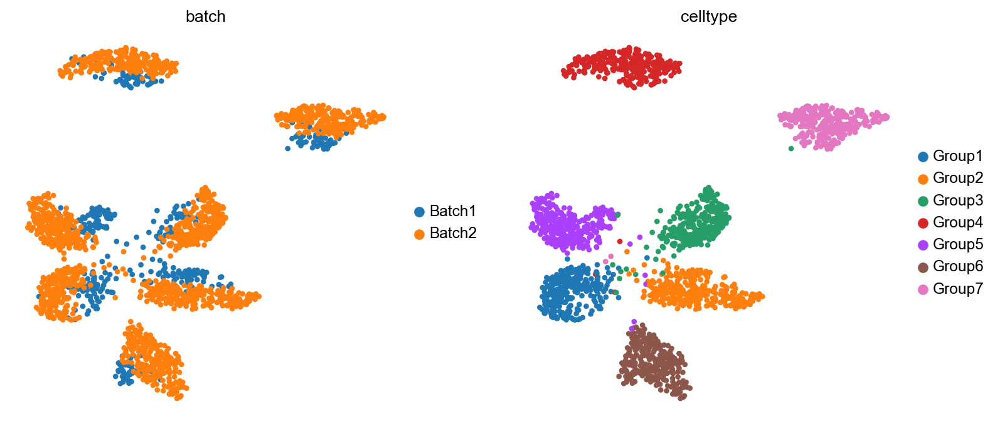

5


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.246441
cASW                        0.623083
F1 ASW                      0.353189
bLISI                       0.126631
1-cLISI                     0.985138
F1 LISI                     0.224416
kBET Accept Rate            0.115459
graph connectivity          0.993729
ARI                         0.953178
NMI                         0.940313
CC score                         NaN
HVG score                   0.732000
knn sim                     0.072338
cell-cell sim preservation  0.751615
exp sim                     0.883024
pos rate                    0.978550
true pos rate               0.134831
DEG precision               0.233499
DEG recall                  0.060635
DEG F1                      0.095995
Avg score (batch)           0.323419
Avg score (bio)             0.701523
Weighted score              0.550281




batch1_250 Sim2




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)


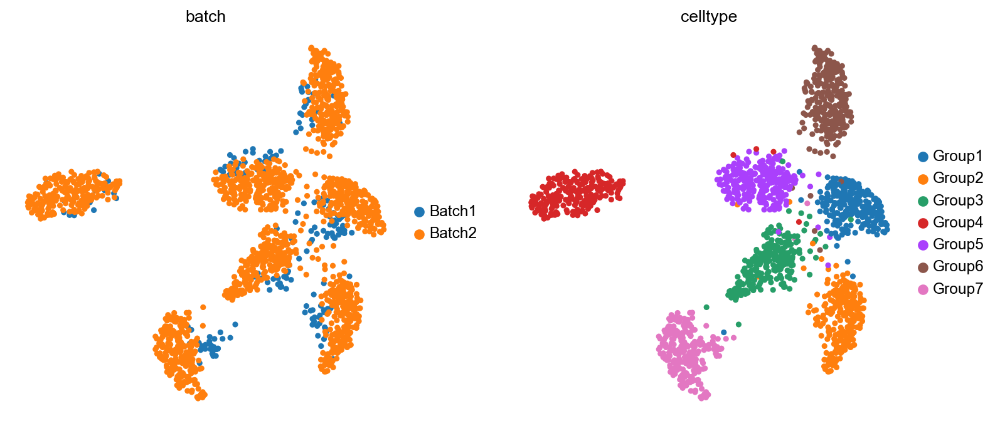

5


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.191032
cASW                        0.611466
F1 ASW                      0.291115
bLISI                       0.056670
1-cLISI                     0.976458
F1 LISI                     0.107122
kBET Accept Rate            0.355045
graph connectivity          0.991513
ARI                         0.933441
NMI                         0.914754
CC score                         NaN
HVG score                   0.764000
knn sim                     0.081903
cell-cell sim preservation  0.761449
exp sim                     0.902967
pos rate                    0.967064
true pos rate               0.471323
DEG precision               0.251790
DEG recall                  0.045346
DEG F1                      0.076544
Avg score (batch)           0.413116
Avg score (bio)             0.699005
Weighted score              0.584649


In [5]:
# 2022.5.10
folders = ['baseline', 'rare1_0.5', 'rare1_0.2', 'rare1_0.1', 'common_5', 'common_3', 'common_1', 'batch1_1000', 'batch1_500', 'batch1_250']
simulation_list = ['Sim2']
print(simulation_list)
method = 'wgan_resnet'
for dataname in simulation_list:
    for folder in folders:
        
            print('\n')
            print('\n')
            print(folder, dataname)
            print('\n')
            if folder == 'baseline':
                adata_raw = sc.read_loom('/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/Sim/%s/%s_raw.loom' % (dataname, dataname), 
                                     sparse=False)  #Load cell line dataset(-> count data). 
            else:
                adata_raw = sc.read_loom('/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/Sim/%s/%s/%s_raw.loom' % (dataname, folder, dataname), 
                                     sparse=False)
            sc.pp.normalize_per_cell(adata_raw, counts_per_cell_after=1e4)
            sc.pp.log1p(adata_raw)
            adata_raw.raw = adata_raw
            sc.pp.scale(adata_raw, max_value=10)
            sc.tl.pca(adata_raw, 20, svd_solver='arpack')
            
            if folder == 'baseline':
                adata_new = sc.read_h5ad('/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/Sim/%s/%s_%s.h5ad' % (dataname, dataname, method))
            else:
                adata_new = sc.read_h5ad('/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/Sim/%s/%s/%s_%s.h5ad' % (dataname, folder, dataname, method))
            sc.pp.neighbors(adata_new)
            sc.tl.umap(adata_new)
            sc.set_figure_params(figsize=(5,5),fontsize=12)
            sc.pl.umap(adata_new, color=['batch', 'celltype'], frameon=False)

            savepath = None
            DEGpath = '/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/Sim/%s/geneinfo.txt' % (dataname)
            res = calculate_metrics(adata_new, adata_raw=adata_raw, savepath=savepath, is_raw=False, is_embed=False, 
                                    embed='X_pca', is_simul=True, org='human', dataname=dataname, DEGpath=DEGpath,
                                   verbose=False)

            batch_metrics = ['1-bASW', 'bLISI', 'kBET Accept Rate', 'graph connectivity', 'true pos rate']
            bio_metrics = ['cASW', '1-cLISI', 'ARI', 'NMI', 'HVG score', 'knn sim', 
                           'cell-cell sim preservation', 'exp sim', 'pos rate', 'DEG F1']
            res['Avg score (batch)'] = res[batch_metrics].mean(1)
            res['Avg score (bio)'] = res[bio_metrics].mean(1)
            res['Weighted score'] = 0.4*res['Avg score (batch)'] + 0.6*res['Avg score (bio)']
            print(res.T)

['Sim2']




baseline 300




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 3598
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 179900.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(8.2239, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0168, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-13.2468, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(9.5974, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-13.7629, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(4.9593, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-14.3898, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(2.5387, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  200
d step loss:  tensor(-13.9780, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tenso

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

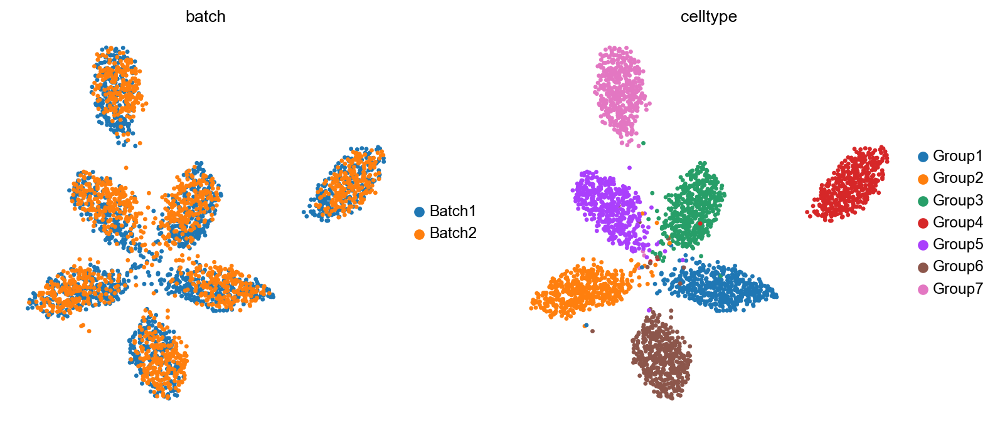

15


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.393855
cASW                        0.605973
F1 ASW                      0.477413
bLISI                       0.717529
1-cLISI                     0.978739
F1 LISI                     0.828022
kBET Accept Rate            0.486975
graph connectivity          0.997165
ARI                         0.944033
NMI                         0.926540
CC score                         NaN
HVG score                   0.651000
knn sim                     0.079226
cell-cell sim preservation  0.681119
exp sim                     0.828617
pos rate                    0.980274
true pos rate               0.842189
DEG precision               0.500821
DEG recall                  0.062294
DEG F1                      0.110577
Avg score (batch)           0.687543
Avg score (bio)             0.678610
Weighted score              0.682183




rare1_0.5 300




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 3504
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 175200.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(8.1545, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0126, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-13.6945, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(9.3533, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-14.3391, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(4.2754, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-14.6935, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(1.4193, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  200
d step loss:  tensor(-14.0841, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tenso

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

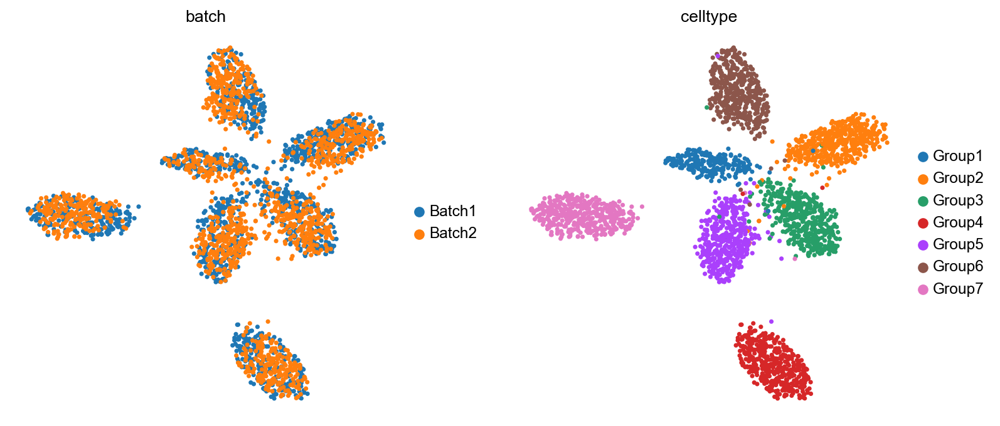

14


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.393249
cASW                        0.605932
F1 ASW                      0.476955
bLISI                       0.708621
1-cLISI                     0.977642
F1 LISI                     0.821672
kBET Accept Rate            0.460145
graph connectivity          0.996556
ARI                         0.946067
NMI                         0.927661
CC score                         NaN
HVG score                   0.658000
knn sim                     0.079378
cell-cell sim preservation  0.683384
exp sim                     0.832602
pos rate                    0.979767
true pos rate               0.823045
DEG precision               0.514224
DEG recall                  0.061694
DEG F1                      0.109927
Avg score (batch)           0.676323
Avg score (bio)             0.680036
Weighted score              0.678551




rare1_0.2 300




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 3382
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 169100.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(8.2135, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0086, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-13.9421, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(9.5606, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-14.4273, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(6.2363, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-14.9664, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(3.0872, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  200
d step loss:  tensor(-14.5169, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tenso

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

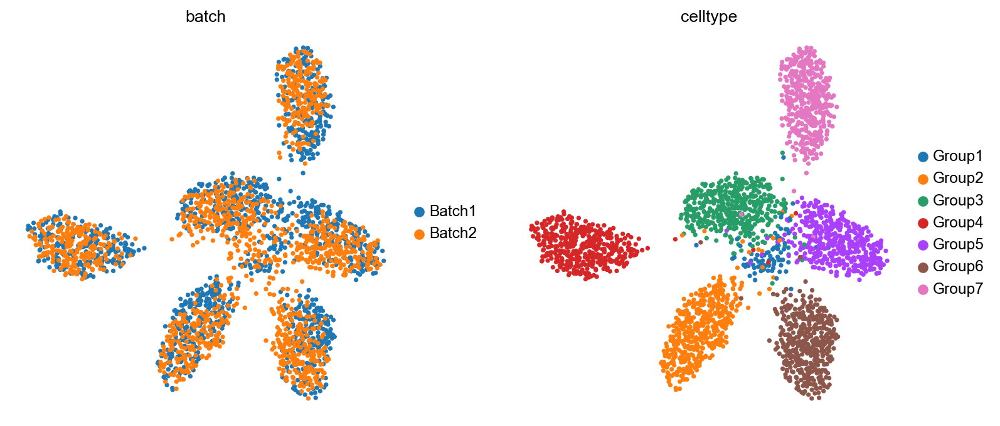

13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.393260
cASW                        0.593619
F1 ASW                      0.473101
bLISI                       0.699866
1-cLISI                     0.968652
F1 LISI                     0.812609
kBET Accept Rate            0.453436
graph connectivity          0.983364
ARI                         0.929462
NMI                         0.904621
CC score                         NaN
HVG score                   0.665000
knn sim                     0.069954
cell-cell sim preservation  0.682866
exp sim                     0.820698
pos rate                    0.966895
true pos rate               0.839511
DEG precision               0.526705
DEG recall                  0.057097
DEG F1                      0.101072
Avg score (batch)           0.673887
Avg score (bio)             0.670284
Weighted score              0.671725




rare1_0.1 300




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 3507
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 175350.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(8.1819, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0124, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-14.1132, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(9.8385, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-14.8343, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(5.0125, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-15.0504, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(1.9462, device='cuda:0', grad_fn=<Neg

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

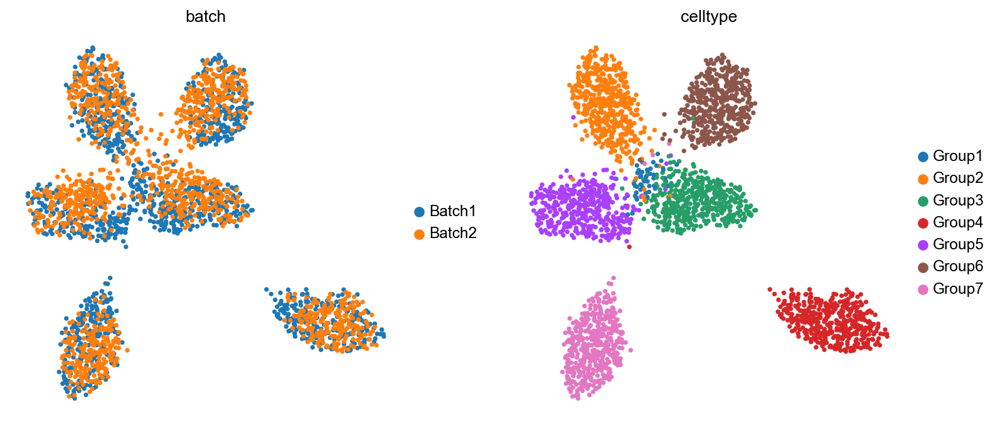

13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.392958
cASW                        0.570404
F1 ASW                      0.465339
bLISI                       0.654627
1-cLISI                     0.970995
F1 LISI                     0.782026
kBET Accept Rate            0.408633
graph connectivity          0.990912
ARI                         0.916605
NMI                         0.897504
CC score                         NaN
HVG score                   0.653000
knn sim                     0.066919
cell-cell sim preservation  0.682495
exp sim                     0.818866
pos rate                    0.973665
true pos rate               0.836869
DEG precision               0.559609
DEG recall                  0.056251
DEG F1                      0.099829
Avg score (batch)           0.656800
Avg score (bio)             0.665028
Weighted score              0.661737




common_5 50




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 2965
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 148250.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(8.1905, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0180, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

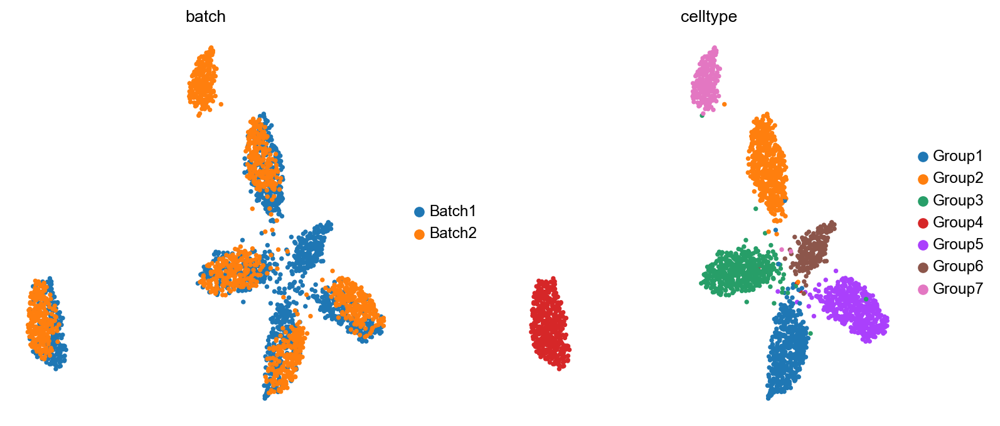

Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.376439
cASW                        0.605602
F1 ASW                      0.464282
bLISI                       0.402614
1-cLISI                     0.983185
F1 LISI                     0.571287
kBET Accept Rate            0.216145
graph connectivity          0.996756
ARI                         0.958680
NMI                         0.943856
CC score                         NaN
HVG score                   0.700000
knn sim                     0.082843
cell-cell sim preservation  0.694882
exp sim                     0.491579
pos rate                    0.982176
true pos rate               0.473078
DEG precision               0.280166
DEG recall                  0.068310
DEG F1                      0.107387
Avg score (batch)           0.493007
Avg score (bio)             0.655019
Weighted score              0.590214




common_3 50




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 2459
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 122950.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(8.1913, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0142, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

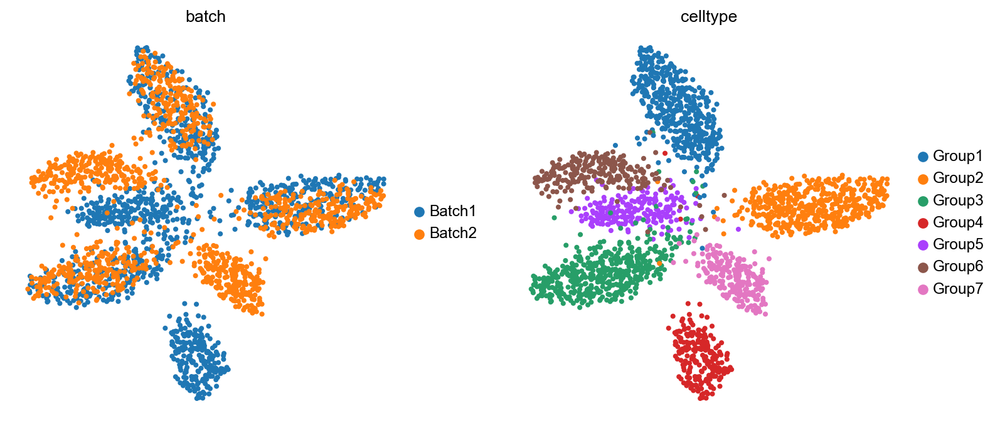

Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group5 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group4 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
11


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.380100
cASW                        0.554499
F1 ASW                      0.451028
bLISI                       0.421313
1-cLISI                     0.958115
F1 LISI                     0.585267
kBET Accept Rate            0.183818
graph connectivity          0.992602
ARI                         0.908595
NMI                         0.872789
CC score                         NaN
HVG score                   0.696000
knn sim                     0.071882
cell-cell sim preservation  0.689396
exp sim                     0.506819
pos rate                    0.962930
true pos rate               0.652251
DEG precision               0.222641
DEG recall                  0.064412
DEG F1                      0.098489
Avg score (batch)           0.526017
Avg score (bio)             0.631951
Weighted score              0.589578




common_1 50




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 1935
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 96750.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(8.2676, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0119, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

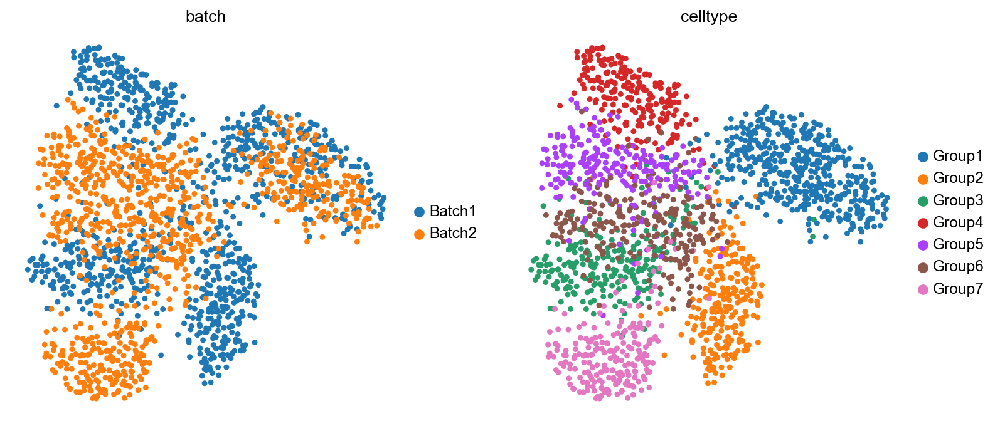

Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group5 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group4 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group3 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group2 contains only one batch or has less than 10 cells. Skip.
9


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.375398
cASW                        0.517819
F1 ASW                      0.435254
bLISI                       0.411819
1-cLISI                     0.894588
F1 LISI                     0.564003
kBET Accept Rate            0.210652
graph connectivity          0.984130
ARI                         0.655150
NMI                         0.646725
CC score                         NaN
HVG score                   0.698020
knn sim                     0.058163
cell-cell sim preservation  0.695499
exp sim                     0.464936
pos rate                    0.893109
true pos rate               0.767227
DEG precision               0.169898
DEG recall                  0.062235
DEG F1                      0.089263
Avg score (batch)           0.549845
Avg score (bio)             0.561327
Weighted score              0.556734




batch1_1000 100




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 3364
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 168200.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(8.1932, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0104, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-16.1189, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(11.5376, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

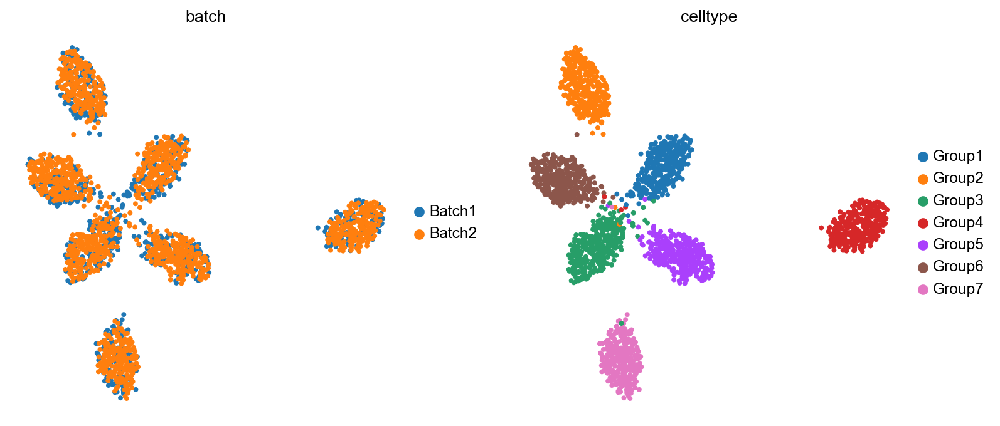

7


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.368019
cASW                        0.606356
F1 ASW                      0.458038
bLISI                       0.261096
1-cLISI                     0.982112
F1 LISI                     0.412523
kBET Accept Rate            0.203419
graph connectivity          0.997430
ARI                         0.963603
NMI                         0.952489
CC score                         NaN
HVG score                   0.697000
knn sim                     0.057054
cell-cell sim preservation  0.697092
exp sim                     0.844034
pos rate                    0.987250
true pos rate               0.837229
DEG precision               0.339522
DEG recall                  0.063237
DEG F1                      0.106209
Avg score (batch)           0.533439
Avg score (bio)             0.689320
Weighted score              0.626967




batch1_500 100




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 2557
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 127850.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(8.2187, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0167, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-21.7385, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.8951, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

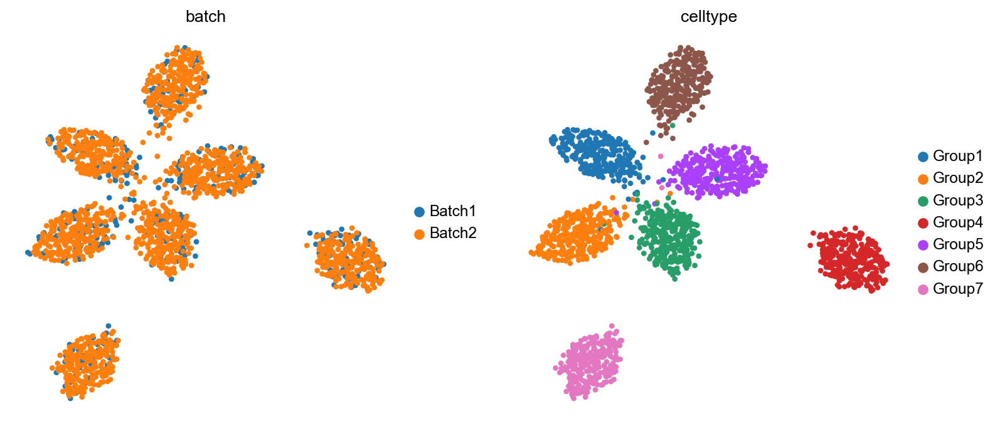

5


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.339809
cASW                        0.605418
F1 ASW                      0.435296
bLISI                       0.112514
1-cLISI                     0.978846
F1 LISI                     0.201829
kBET Accept Rate            0.323919
graph connectivity          0.998491
ARI                         0.957478
NMI                         0.945335
CC score                         NaN
HVG score                   0.685000
knn sim                     0.059011
cell-cell sim preservation  0.711897
exp sim                     0.805420
pos rate                    0.982125
true pos rate               0.895812
DEG precision               0.271324
DEG recall                  0.068553
DEG F1                      0.109272
Avg score (batch)           0.534109
Avg score (bio)             0.683980
Weighted score              0.624032




batch1_250 100




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 1767
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 88350.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(8.1964, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0099, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-26.4482, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(11.0560, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

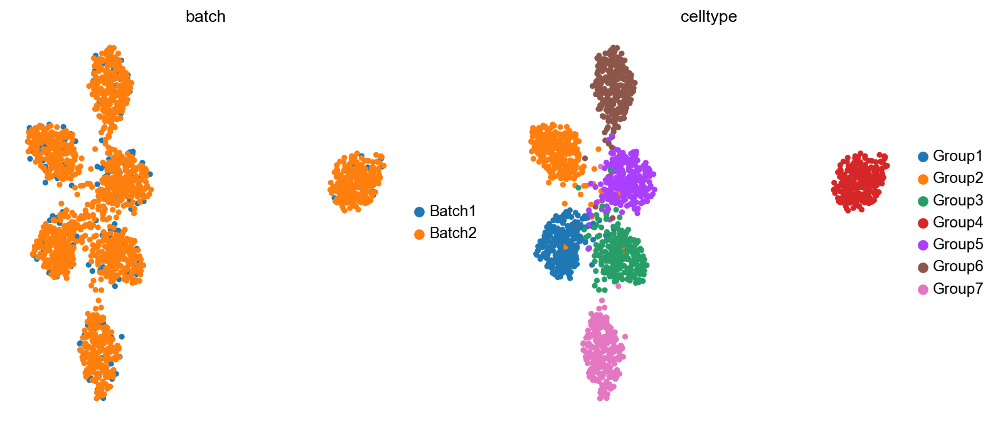

5


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.293921
cASW                        0.602722
F1 ASW                      0.395146
bLISI                       0.015634
1-cLISI                     0.965337
F1 LISI                     0.030769
kBET Accept Rate            0.467792
graph connectivity          0.993695
ARI                         0.905282
NMI                         0.889255
CC score                         NaN
HVG score                   0.698000
knn sim                     0.067924
cell-cell sim preservation  0.712643
exp sim                     0.772205
pos rate                    0.959114
true pos rate               0.948325
DEG precision               0.217264
DEG recall                  0.063975
DEG F1                      0.098684
Avg score (batch)           0.543873
Avg score (bio)             0.667117
Weighted score              0.617819


In [10]:
# 2022.5.10
from benchmark_scripts.wgan_resnet_standard import sequencing_train
folders = ['baseline', 'rare1_0.5', 'rare1_0.2', 'rare1_0.1', 'common_5', 'common_3', 'common_1', 'batch1_1000', 'batch1_500', 'batch1_250']
simulation_list = ['Sim2']
print(simulation_list)
for dataname in simulation_list:
    for folder in folders:
        # Parameters
        npcs = 20
        reduction='pca'
        mode='rwMNN'
        if folder.startswith('common'):
            epoch = 50
        elif folder.startswith('batch'):
            epoch = 100
        else:
            epoch = 300
        
        print('\n')
        print('\n')
        print(folder, epoch)
        print('\n')
        if folder == 'baseline':
            adata = sc.read_loom('/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/Sim/%s/%s_raw.loom' % (dataname, dataname), 
                                 sparse=False)  #Load cell line dataset(-> count data). 
        else:
            adata = sc.read_loom('/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/Sim/%s/%s/%s_raw.loom' % (dataname, folder, dataname), 
                                 sparse=False)
        sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
        sc.pp.log1p(adata)

        adata_raw = adata.copy()
        adata_raw.raw = adata_raw
        sc.pp.scale(adata_raw, max_value=10)
        sc.tl.pca(adata_raw, 20, svd_solver='arpack')

        sc.pp.highly_variable_genes(adata, n_top_genes=2000, batch_key='batch')
        adata = adata[:, adata.var['highly_variable']]

        adata_new = sequencing_train(adata, key='batch', epoch=epoch, batch=1024, k1=10, k2=20,
                                     lambda_1=1/10, reduction='pca', mode='rwMNN', seed=0, filtering=False)
#         adata_new = sequencing_train(adata, key='batch', epoch=epoch, batch=1024, reduction='pca', mode='rwMNN', 
#                                  metric='angular', k1=10, k2=20, subsample=3000, opt='AdamW',
#                                  filtering=False, lr=0.0001, b1=0.9)

        adata_new.raw = adata_new
        sc.pp.scale(adata_new, max_value=10)
        sc.tl.pca(adata_new, 20, svd_solver='arpack')
        sc.pp.neighbors(adata_new)
        sc.tl.umap(adata_new)
        sc.set_figure_params(figsize=(5,5),fontsize=12)
        sc.pl.umap(adata_new, color=['batch', 'celltype'], frameon=False)

        savepath = None
        DEGpath = '/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/Sim/%s/geneinfo.txt' % (dataname)
        res = calculate_metrics(adata_new, adata_raw=adata_raw, savepath=savepath, is_raw=False, is_embed=False, 
                                embed='X_pca', is_simul=True, org='human', dataname=dataname, DEGpath=DEGpath,
                               verbose=False)

        batch_metrics = ['1-bASW', 'bLISI', 'kBET Accept Rate', 'graph connectivity', 'true pos rate']
        bio_metrics = ['cASW', '1-cLISI', 'ARI', 'NMI', 'HVG score', 'knn sim', 
                       'cell-cell sim preservation', 'exp sim', 'pos rate', 'DEG F1']
        res['Avg score (batch)'] = res[batch_metrics].mean(1)
        res['Avg score (bio)'] = res[bio_metrics].mean(1)
        res['Weighted score'] = 0.4*res['Avg score (batch)'] + 0.6*res['Avg score (bio)']
        print(res.T)


['Sim2']




common_5 50




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 2913
Calculating Random Walk Pairs...
Start filtering of selected pairs


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Number of rwMNN pairs after filtering is 41784.
Done.
Dimension of paired data is 41784.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6714, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0014, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

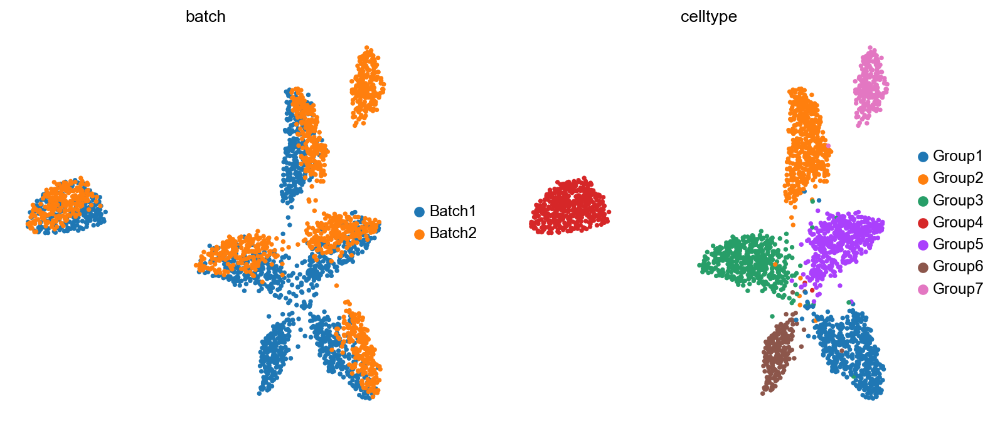

Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.372190
cASW                        0.607040
F1 ASW                      0.461453
bLISI                       0.346503
1-cLISI                     0.984006
F1 LISI                     0.512527
kBET Accept Rate            0.187116
graph connectivity          0.998054
ARI                         0.956962
NMI                         0.945488
CC score                         NaN
HVG score                   0.704000
knn sim                     0.084136
cell-cell sim preservation  0.704295
exp sim                     0.493567
pos rate                    0.984404
true pos rate               0.394356
DEG precision               0.289374
DEG recall                  0.072369
DEG F1                      0.113025
Avg score (batch)           0.459644
Avg score (bio)             0.657692
Weighted score              0.578473




common_3 50




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 2484
Calculating Random Walk Pairs...
Start filtering of selected pairs


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Number of rwMNN pairs after filtering is 15127.
Done.
Dimension of paired data is 15127.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.7152, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0031, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

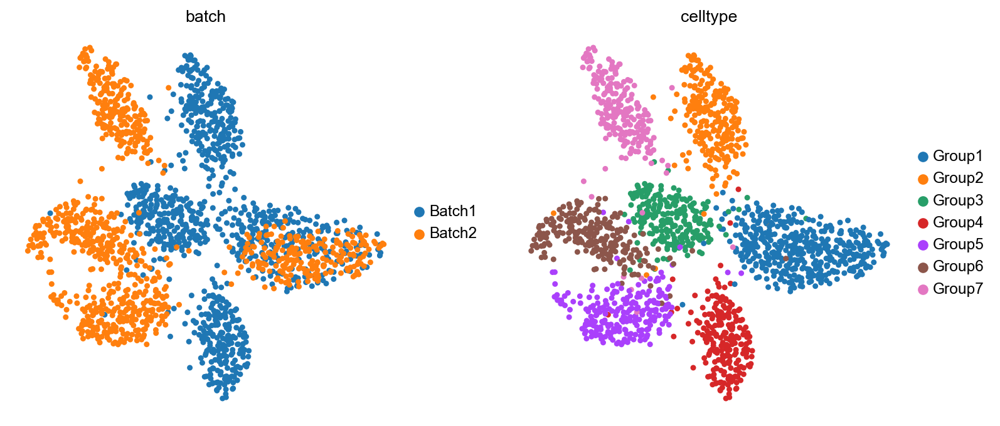

Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group5 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group4 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group3 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group2 contains only one batch or has less than 10 cells. Skip.
9


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.372920
cASW                        0.537944
F1 ASW                      0.440483
bLISI                       0.361077
1-cLISI                     0.938450
F1 LISI                     0.521501
kBET Accept Rate            0.142826
graph connectivity          0.991966
ARI                         0.892492
NMI                         0.863270
CC score                         NaN
HVG score                   0.704950
knn sim                     0.059928
cell-cell sim preservation  0.714725
exp sim                     0.471595
pos rate                    0.958763
true pos rate               0.809550
DEG precision               0.168211
DEG recall                  0.069119
DEG F1                      0.095636
Avg score (batch)           0.535668
Avg score (bio)             0.623775
Weighted score              0.588532




batch1_1000 100




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 3337
Calculating Random Walk Pairs...
Start filtering of selected pairs


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Number of rwMNN pairs after filtering is 65174.
Done.
Dimension of paired data is 65174.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6074, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0001, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-18.2387, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(8.0470, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

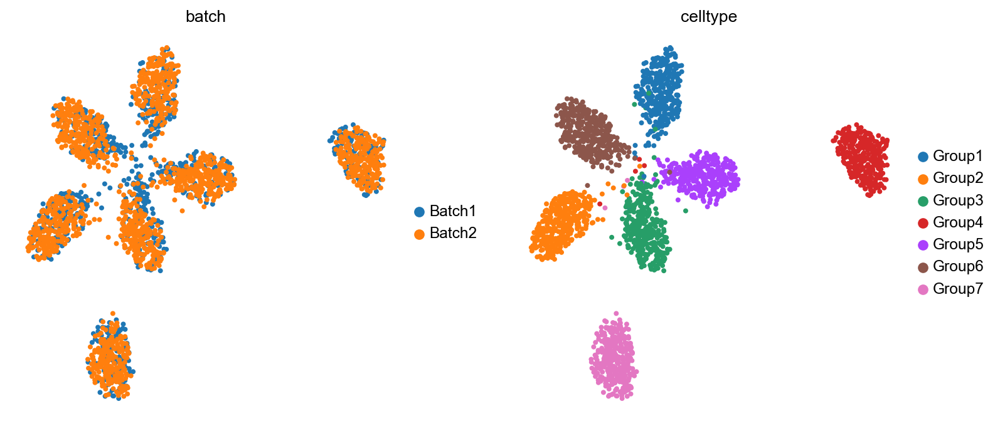

7


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.372698
cASW                        0.602909
F1 ASW                      0.460643
bLISI                       0.361472
1-cLISI                     0.980619
F1 LISI                     0.528230
kBET Accept Rate            0.336236
graph connectivity          0.998759
ARI                         0.957396
NMI                         0.945340
CC score                         NaN
HVG score                   0.685000
knn sim                     0.057358
cell-cell sim preservation  0.705189
exp sim                     0.851370
pos rate                    0.984700
true pos rate               0.701232
DEG precision               0.304928
DEG recall                  0.064595
DEG F1                      0.106383
Avg score (batch)           0.554079
Avg score (bio)             0.687627
Weighted score              0.634208




batch1_500 100




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 2553
Calculating Random Walk Pairs...
Start filtering of selected pairs


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Number of rwMNN pairs after filtering is 58539.
Done.
Dimension of paired data is 58539.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6751, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0057, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-21.9956, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(6.9968, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

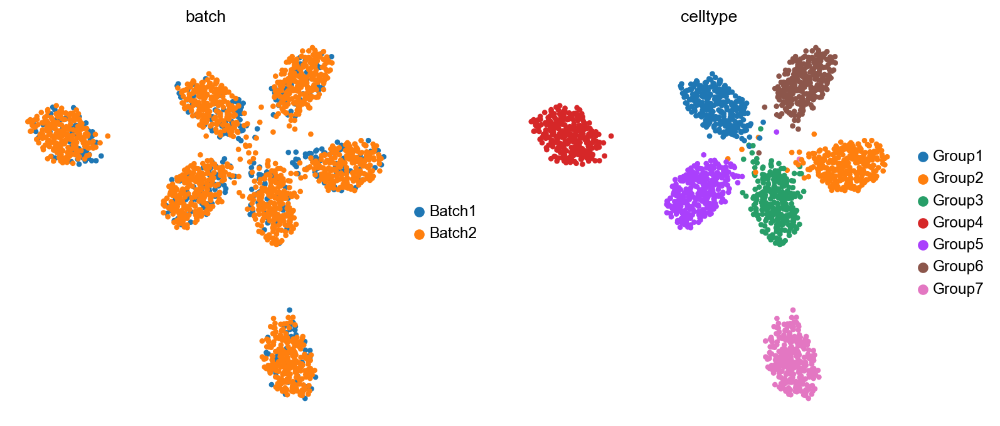

5


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.349185
cASW                        0.601692
F1 ASW                      0.441911
bLISI                       0.135603
1-cLISI                     0.977810
F1 LISI                     0.238176
kBET Accept Rate            0.384420
graph connectivity          0.997421
ARI                         0.957709
NMI                         0.945760
CC score                         NaN
HVG score                   0.683000
knn sim                     0.066432
cell-cell sim preservation  0.718031
exp sim                     0.810334
pos rate                    0.986210
true pos rate               0.843207
DEG precision               0.249638
DEG recall                  0.070835
DEG F1                      0.110240
Avg score (batch)           0.541967
Avg score (bio)             0.685722
Weighted score              0.628220




batch1_250 100




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 1752
Calculating Random Walk Pairs...
Start filtering of selected pairs


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Number of rwMNN pairs after filtering is 49018.
Done.
Dimension of paired data is 49018.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.5966, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0002, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-26.1323, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(9.2828, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

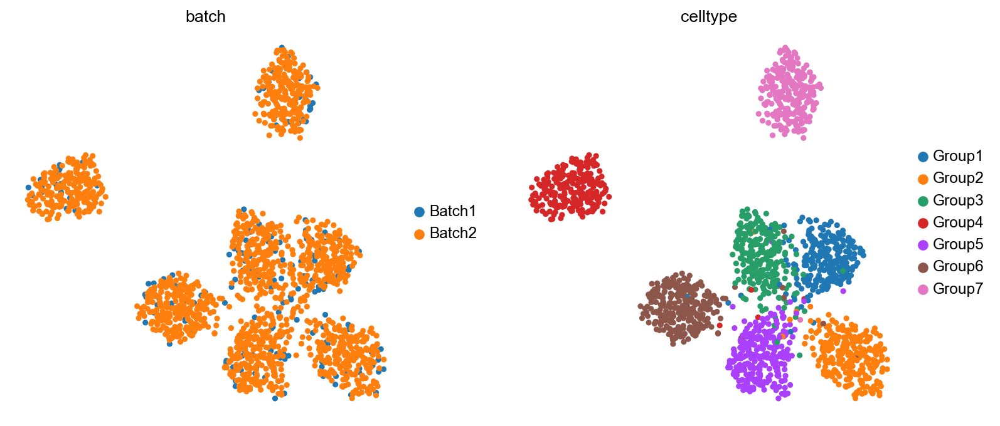

5


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.313381
cASW                        0.595438
F1 ASW                      0.410641
bLISI                       0.055784
1-cLISI                     0.958950
F1 LISI                     0.105435
kBET Accept Rate            0.694919
graph connectivity          0.995462
ARI                         0.903079
NMI                         0.889486
CC score                         NaN
HVG score                   0.679000
knn sim                     0.068235
cell-cell sim preservation  0.715401
exp sim                     0.776740
pos rate                    0.960818
true pos rate               0.952868
DEG precision               0.208392
DEG recall                  0.062658
DEG F1                      0.095845
Avg score (batch)           0.602483
Avg score (bio)             0.664299
Weighted score              0.639573




rare1_0.5 300




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 3601
Calculating Random Walk Pairs...
Start filtering of selected pairs


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Number of rwMNN pairs after filtering is 55257.
Done.
Dimension of paired data is 55257.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.5939, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0007, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-16.6691, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.1518, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-16.1557, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(2.5876, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-16.2985, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.2264, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  200
d step loss:  tensor(-16.1303, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.7265, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  250
d step loss:  tensor

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

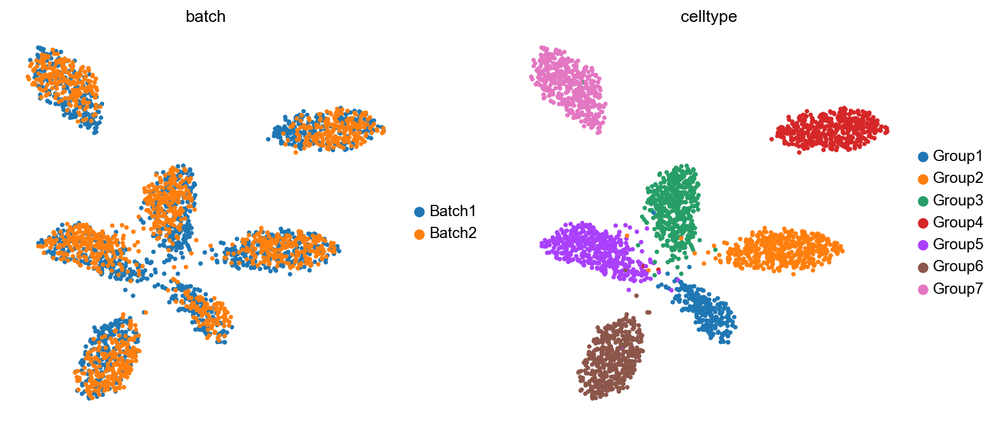

14


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.389746
cASW                        0.612161
F1 ASW                      0.476266
bLISI                       0.588301
1-cLISI                     0.984749
F1 LISI                     0.736567
kBET Accept Rate            0.303511
graph connectivity          0.998746
ARI                         0.962878
NMI                         0.949185
CC score                         NaN
HVG score                   0.658000
knn sim                     0.080376
cell-cell sim preservation  0.683867
exp sim                     0.841790
pos rate                    0.986968
true pos rate               0.631344
DEG precision               0.498548
DEG recall                  0.065119
DEG F1                      0.114715
Avg score (batch)           0.582330
Avg score (bio)             0.687469
Weighted score              0.645413




rare1_0.2 300




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 3373
Calculating Random Walk Pairs...
Start filtering of selected pairs


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Number of rwMNN pairs after filtering is 49547.
Done.
Dimension of paired data is 49547.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6773, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0096, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-17.2627, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.2326, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-16.3209, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(2.4207, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-17.0294, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.4886, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  200
d step loss:  tensor(-16.5807, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.3885, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  250
d step loss:  tensor(-

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

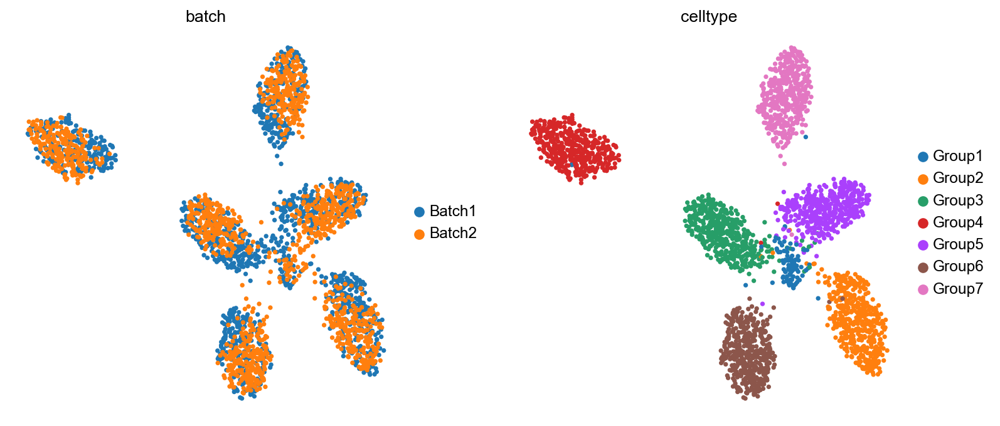

13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.387355
cASW                        0.581614
F1 ASW                      0.465012
bLISI                       0.552923
1-cLISI                     0.981174
F1 LISI                     0.707274
kBET Accept Rate            0.276329
graph connectivity          0.994350
ARI                         0.962817
NMI                         0.943387
CC score                         NaN
HVG score                   0.658000
knn sim                     0.072312
cell-cell sim preservation  0.685829
exp sim                     0.829343
pos rate                    0.982008
true pos rate               0.542281
DEG precision               0.525627
DEG recall                  0.062195
DEG F1                      0.108387
Avg score (batch)           0.550648
Avg score (bio)             0.680487
Weighted score              0.628551




rare1_0.1 300




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 3440
Calculating Random Walk Pairs...
Start filtering of selected pairs


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Number of rwMNN pairs after filtering is 51062.
Done.
Dimension of paired data is 51062.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.5895, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0055, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-16.9589, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(6.9746, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-16.8030, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(2.9522, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-17.1197, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.1455, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  200
d step loss:  tensor(-16.5749, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-1.3906, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  250
d step loss:  tensor

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

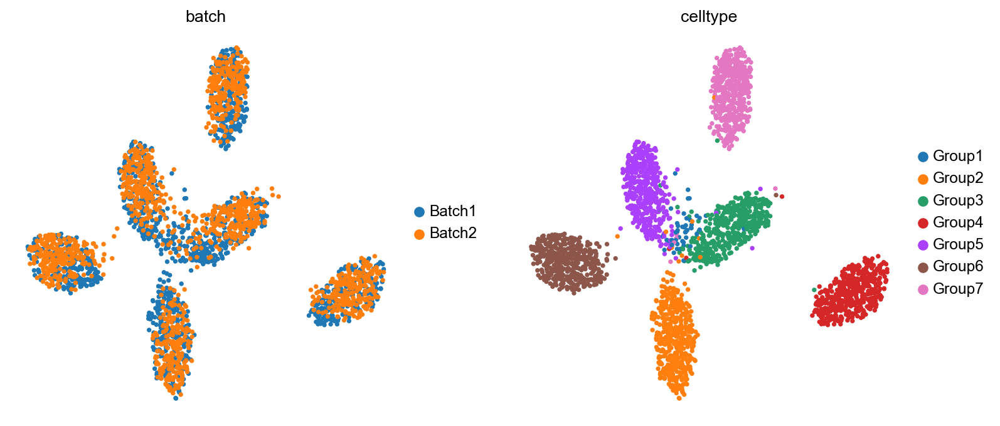

13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.389614
cASW                        0.559615
F1 ASW                      0.459391
bLISI                       0.539596
1-cLISI                     0.978456
F1 LISI                     0.695590
kBET Accept Rate            0.271565
graph connectivity          0.967683
ARI                         0.933131
NMI                         0.921297
CC score                         NaN
HVG score                   0.669000
knn sim                     0.067726
cell-cell sim preservation  0.684678
exp sim                     0.829620
pos rate                    0.971470
true pos rate               0.503292
DEG precision               0.502367
DEG recall                  0.061867
DEG F1                      0.107261
Avg score (batch)           0.534350
Avg score (bio)             0.672225
Weighted score              0.617075




baseline 300




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 3623
Calculating Random Walk Pairs...
Start filtering of selected pairs


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Number of rwMNN pairs after filtering is 51088.
Done.
Dimension of paired data is 51088.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.5727, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0019, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-16.2578, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.1900, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-16.0956, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(2.3274, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-16.3175, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.2828, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  200
d step loss:  tensor(-15.7143, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.8604, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  250
d step loss:  tensor(-

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

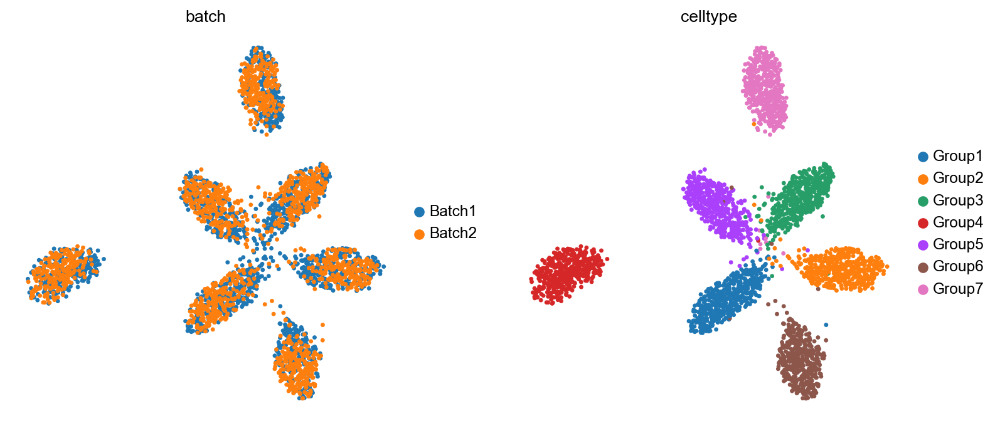

15


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.390653
cASW                        0.610655
F1 ASW                      0.476486
bLISI                       0.645992
1-cLISI                     0.983147
F1 LISI                     0.779682
kBET Accept Rate            0.370380
graph connectivity          0.997163
ARI                         0.953694
NMI                         0.938917
CC score                         NaN
HVG score                   0.652000
knn sim                     0.080137
cell-cell sim preservation  0.682866
exp sim                     0.838363
pos rate                    0.984092
true pos rate               0.687241
DEG precision               0.473655
DEG recall                  0.066738
DEG F1                      0.116838
Avg score (batch)           0.618286
Avg score (bio)             0.684071
Weighted score              0.657757


In [7]:
# 2022.5.10
folders = ['common_5', 'common_3', 'common_1', 'batch1_1000', 'batch1_500', 'batch1_250', 'rare1_0.5', 'rare1_0.2', 'rare1_0.1', 'baseline']
simulation_list = ['Sim2']
print(simulation_list)
for dataname in simulation_list:
    for folder in folders:
        # Parameters
        npcs = 20
        reduction='pca'
        mode='rwMNN'
        if folder.startswith('common'):
            epoch = 50
        elif folder.startswith('batch'):
            epoch = 100
        else:
            epoch = 300
        
        print('\n')
        print('\n')
        print(folder, epoch)
        print('\n')
        if folder == 'baseline':
            adata = sc.read_loom('/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/Sim/%s/%s_raw.loom' % (dataname, dataname), 
                                 sparse=False)  #Load cell line dataset(-> count data). 
        else:
            adata = sc.read_loom('/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/Sim/%s/%s/%s_raw.loom' % (dataname, folder, dataname), 
                                 sparse=False)
        sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
        sc.pp.log1p(adata)

        adata_raw = adata.copy()
        adata_raw.raw = adata_raw
        sc.pp.scale(adata_raw, max_value=10)
        sc.tl.pca(adata_raw, 20, svd_solver='arpack')

        sc.pp.highly_variable_genes(adata, n_top_genes=2000, batch_key='batch')
        adata = adata[:, adata.var['highly_variable']]

        adata_new = sequencing_train(adata, key='batch', epoch=epoch, batch=1024, reduction='pca', mode='rwMNN', 
                                 metric='angular', k1=10, k2=20, subsample=3000, opt='AdamW',
                                 filtering=True, lr=0.0001, b1=0.9)

        adata_new.raw = adata_new
        sc.pp.scale(adata_new, max_value=10)
        sc.tl.pca(adata_new, 20, svd_solver='arpack')
        sc.pp.neighbors(adata_new)
        sc.tl.umap(adata_new)
        sc.set_figure_params(figsize=(5,5),fontsize=12)
        sc.pl.umap(adata_new, color=['batch', 'celltype'], frameon=False)

        savepath = None
        DEGpath = '/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/Sim/%s/geneinfo.txt' % (dataname)
        res = calculate_metrics(adata_new, adata_raw=adata_raw, savepath=savepath, is_raw=False, is_embed=False, 
                                embed='X_pca', is_simul=True, org='human', dataname=dataname, DEGpath=DEGpath,
                               verbose=False)

        batch_metrics = ['1-bASW', 'bLISI', 'kBET Accept Rate', 'graph connectivity', 'true pos rate']
        bio_metrics = ['cASW', '1-cLISI', 'ARI', 'NMI', 'HVG score', 'knn sim', 
                       'cell-cell sim preservation', 'exp sim', 'pos rate', 'DEG F1']
        res['Avg score (batch)'] = res[batch_metrics].mean(1)
        res['Avg score (bio)'] = res[bio_metrics].mean(1)
        res['Weighted score'] = 0.4*res['Avg score (batch)'] + 0.6*res['Avg score (bio)']
        print(res.T)


['Sim2']




baseline 50




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 2166
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 108300.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6009, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0016, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

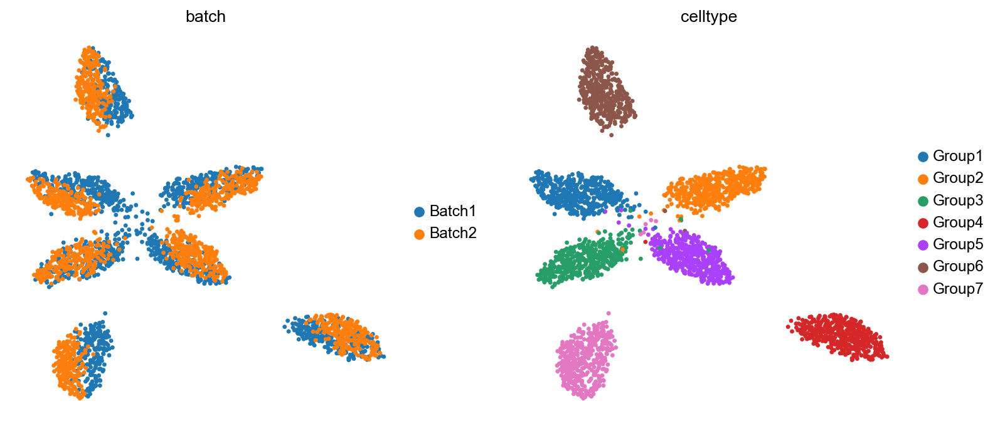

15


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.373848
cASW                        0.614991
F1 ASW                      0.465017
bLISI                       0.422069
1-cLISI                     0.987204
F1 LISI                     0.591324
kBET Accept Rate            0.248013
graph connectivity          0.998741
ARI                         0.965297
NMI                         0.953253
CC score                         NaN
HVG score                   0.688000
knn sim                     0.092604
cell-cell sim preservation  0.692540
exp sim                     0.913294
pos rate                    0.989182
true pos rate               0.386255
DEG precision               0.325967
DEG recall                  0.066727
DEG F1                      0.110563
Avg score (batch)           0.485785
Avg score (bio)             0.700693
Weighted score              0.614730




baseline 100




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 2166
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 108300.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6009, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0016, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-13.7972, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.7863, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

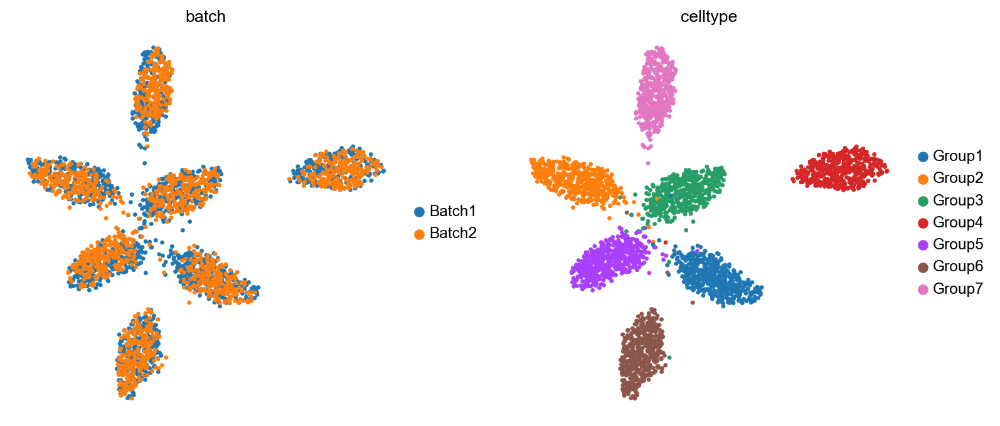

15


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.389931
cASW                        0.609372
F1 ASW                      0.475558
bLISI                       0.569027
1-cLISI                     0.985797
F1 LISI                     0.721555
kBET Accept Rate            0.265182
graph connectivity          0.997797
ARI                         0.966699
NMI                         0.955808
CC score                         NaN
HVG score                   0.683000
knn sim                     0.089367
cell-cell sim preservation  0.681021
exp sim                     0.887393
pos rate                    0.986001
true pos rate               0.765829
DEG precision               0.426336
DEG recall                  0.064923
DEG F1                      0.112390
Avg score (batch)           0.597554
Avg score (bio)             0.695685
Weighted score              0.656432




baseline 200




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 2166
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 108300.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6009, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0016, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-13.7972, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.7863, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-13.9215, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(3.3724, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-14.0421, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.9531, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

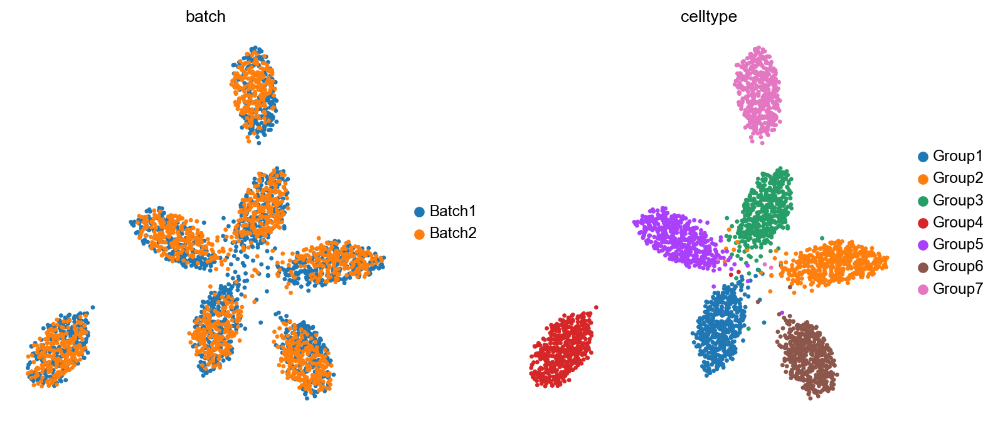

15


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.391388
cASW                        0.608301
F1 ASW                      0.476312
bLISI                       0.594359
1-cLISI                     0.983307
F1 LISI                     0.740889
kBET Accept Rate            0.268655
graph connectivity          0.998432
ARI                         0.955002
NMI                         0.940719
CC score                         NaN
HVG score                   0.671000
knn sim                     0.082649
cell-cell sim preservation  0.679606
exp sim                     0.853027
pos rate                    0.984728
true pos rate               0.796691
DEG precision               0.483170
DEG recall                  0.063408
DEG F1                      0.111799
Avg score (batch)           0.609905
Avg score (bio)             0.687014
Weighted score              0.656170




baseline 300




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 2166
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 108300.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6009, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0016, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-13.7972, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.7863, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-13.9215, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(3.3724, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-14.0421, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.9531, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  200
d step loss:  tensor(-13.2289, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tenso

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

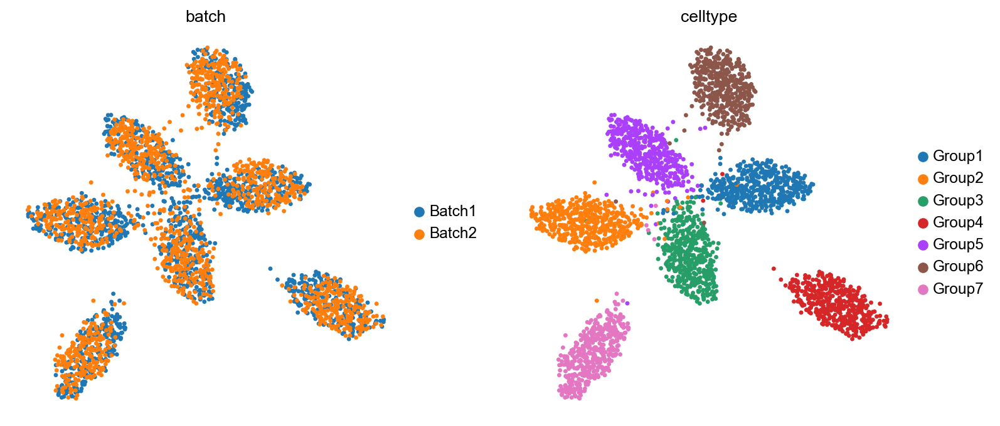

15


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.393819
cASW                        0.603944
F1 ASW                      0.476756
bLISI                       0.740985
1-cLISI                     0.978064
F1 LISI                     0.843176
kBET Accept Rate            0.525070
graph connectivity          0.998729
ARI                         0.952903
NMI                         0.937319
CC score                         NaN
HVG score                   0.648000
knn sim                     0.079706
cell-cell sim preservation  0.681140
exp sim                     0.832062
pos rate                    0.982183
true pos rate               0.841234
DEG precision               0.511002
DEG recall                  0.062581
DEG F1                      0.111240
Avg score (batch)           0.699968
Avg score (bio)             0.680656
Weighted score              0.688381




rare1_0.5 50




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 2149
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 107450.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6207, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0011, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

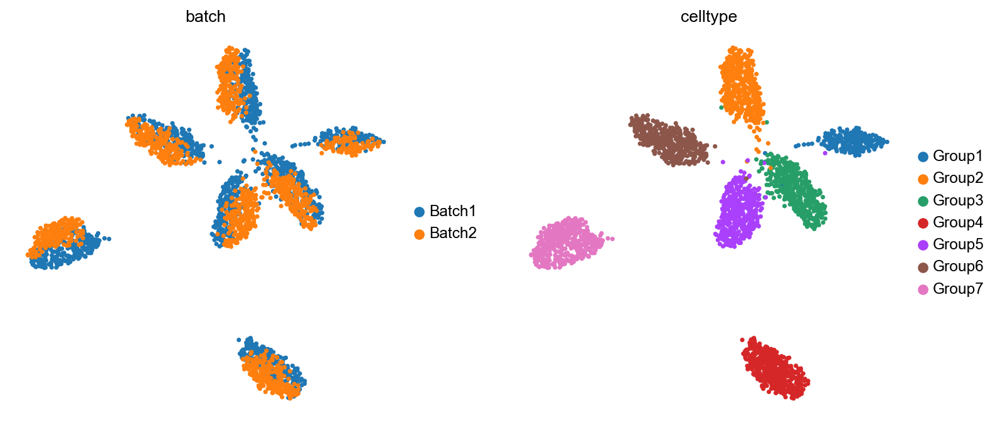

14


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.371689
cASW                        0.617035
F1 ASW                      0.463921
bLISI                       0.413251
1-cLISI                     0.987922
F1 LISI                     0.582740
kBET Accept Rate            0.263952
graph connectivity          0.998741
ARI                         0.973924
NMI                         0.965249
CC score                         NaN
HVG score                   0.708000
knn sim                     0.097031
cell-cell sim preservation  0.693639
exp sim                     0.917534
pos rate                    0.991427
true pos rate               0.410837
DEG precision               0.353578
DEG recall                  0.065927
DEG F1                      0.110173
Avg score (batch)           0.491694
Avg score (bio)             0.706193
Weighted score              0.620393




rare1_0.5 100




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 2149
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 107450.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6207, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0011, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-14.1208, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.0141, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

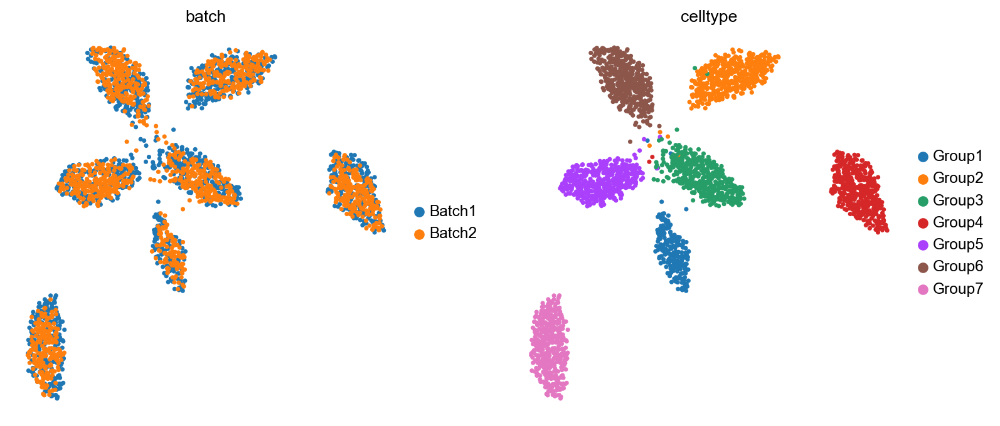

14


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.385687
cASW                        0.612730
F1 ASW                      0.473394
bLISI                       0.515638
1-cLISI                     0.988506
F1 LISI                     0.677742
kBET Accept Rate            0.241163
graph connectivity          0.999060
ARI                         0.982225
NMI                         0.975580
CC score                         NaN
HVG score                   0.695000
knn sim                     0.093084
cell-cell sim preservation  0.684392
exp sim                     0.889659
pos rate                    0.991427
true pos rate               0.692387
DEG precision               0.444378
DEG recall                  0.062837
DEG F1                      0.109670
Avg score (batch)           0.566787
Avg score (bio)             0.702227
Weighted score              0.648051




rare1_0.5 200




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 2149
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 107450.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6207, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0011, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-14.1208, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.0141, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-14.1013, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(3.6307, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-14.1590, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(2.6910, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

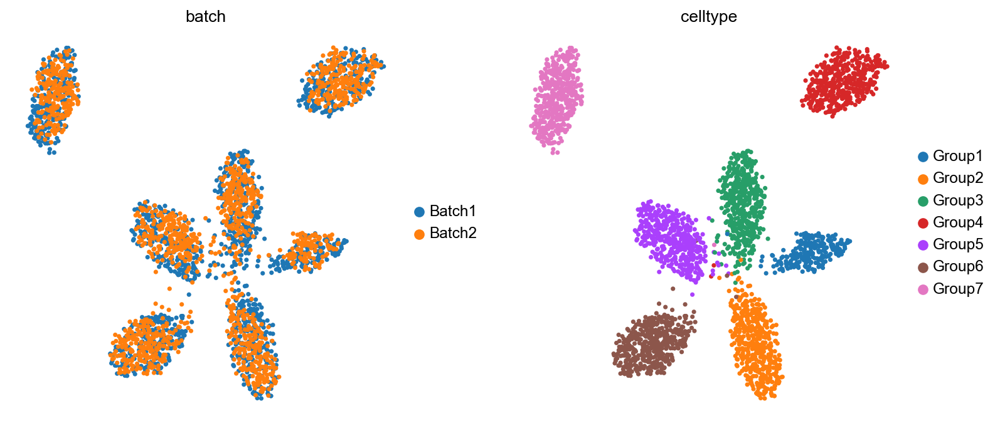

14


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.390929
cASW                        0.609716
F1 ASW                      0.476404
bLISI                       0.588435
1-cLISI                     0.984215
F1 LISI                     0.736523
kBET Accept Rate            0.285813
graph connectivity          0.999375
ARI                         0.964410
NMI                         0.951226
CC score                         NaN
HVG score                   0.666000
knn sim                     0.081790
cell-cell sim preservation  0.680880
exp sim                     0.856044
pos rate                    0.987311
true pos rate               0.828189
DEG precision               0.494831
DEG recall                  0.062394
DEG F1                      0.110373
Avg score (batch)           0.618548
Avg score (bio)             0.689197
Weighted score              0.660937




rare1_0.5 300




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 2149
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 107450.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6207, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0011, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-14.1208, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.0141, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-14.1013, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(3.6307, device='cuda:0', grad_fn=<NegBackward0>)


KeyboardInterrupt: 

In [8]:
# 2022.5.10
from benchmark_scripts.wgan_resnet_standard import sequencing_train
folders = ['baseline', 'rare1_0.5', 'rare1_0.2', 'rare1_0.1', 'common_5', 'common_3', 'common_1', 'batch1_1000', 'batch1_500', 'batch1_250']
simulation_list = ['Sim2']
epochs = [50, 100, 200, 300]
print(simulation_list)
for dataname in simulation_list:
    for folder in folders:
        # Parameters
        npcs = 20
        reduction='pca'
        mode='rwMNN'
        for epoch in epochs:
            print('\n')
            print('\n')
            print(folder, epoch)
            print('\n')
            if folder == 'baseline':
                adata = sc.read_loom('/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/Sim/%s/%s_raw.loom' % (dataname, dataname), 
                                     sparse=False)  #Load cell line dataset(-> count data). 
            else:
                adata = sc.read_loom('/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/Sim/%s/%s/%s_raw.loom' % (dataname, folder, dataname), 
                                     sparse=False)
            sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
            sc.pp.log1p(adata)

            adata_raw = adata.copy()
            adata_raw.raw = adata_raw
            sc.pp.scale(adata_raw, max_value=10)
            sc.tl.pca(adata_raw, 20, svd_solver='arpack')

            sc.pp.highly_variable_genes(adata, n_top_genes=2000, batch_key='batch')
            adata = adata[:, adata.var['highly_variable']]
            
#             if folder.startswith('common'):
#                 epoch = 200
#             elif folder == 'real':
#                 epoch = 300
#             else:
#                 epoch = 600
            adata_new = sequencing_train(adata, key='batch', epoch=epoch, batch=1024, reduction='pca', mode='rwMNN', 
                                     metric='angular', subsample=3000, opt='AdamW',
                                     filtering=False, lr=0.0001, b1=0.9)

            adata_new.raw = adata_new
            sc.pp.scale(adata_new, max_value=10)
            sc.tl.pca(adata_new, 20, svd_solver='arpack')
            sc.pp.neighbors(adata_new)
            sc.tl.umap(adata_new)
            sc.set_figure_params(figsize=(5,5),fontsize=12)
            sc.pl.umap(adata_new, color=['batch', 'celltype'], frameon=False)

            savepath = None
            DEGpath = '/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/Sim/%s/geneinfo.txt' % (dataname)
            res = calculate_metrics(adata_new, adata_raw=adata_raw, savepath=savepath, is_raw=False, is_embed=False, 
                                    embed='X_pca', is_simul=True, org='human', dataname=dataname, DEGpath=DEGpath,
                                   verbose=False)

            batch_metrics = ['1-bASW', 'bLISI', 'kBET Accept Rate', 'graph connectivity', 'true pos rate']
            bio_metrics = ['cASW', '1-cLISI', 'ARI', 'NMI', 'HVG score', 'knn sim', 
                           'cell-cell sim preservation', 'exp sim', 'pos rate', 'DEG F1']
            res['Avg score (batch)'] = res[batch_metrics].mean(1)
            res['Avg score (bio)'] = res[bio_metrics].mean(1)
            res['Weighted score'] = 0.4*res['Avg score (batch)'] + 0.6*res['Avg score (bio)']
            print(res.T)

['Sim2']




rare1_0.2 50




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 1590
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 79500.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.7078, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0086, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

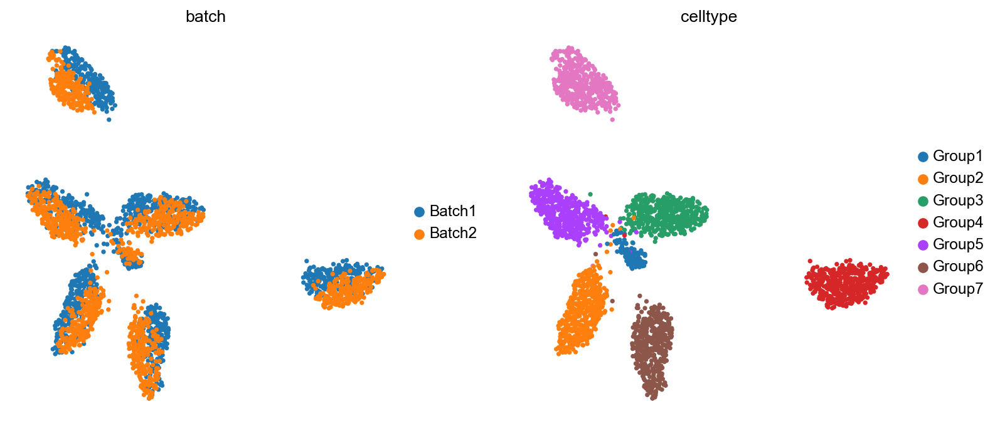

13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.372964
cASW                        0.602866
F1 ASW                      0.460833
bLISI                       0.408289
1-cLISI                     0.985240
F1 LISI                     0.577329
kBET Accept Rate            0.255460
graph connectivity          0.998419
ARI                         0.970574
NMI                         0.955425
CC score                         NaN
HVG score                   0.699000
knn sim                     0.087986
cell-cell sim preservation  0.693448
exp sim                     0.912936
pos rate                    0.984887
true pos rate               0.395466
DEG precision               0.358017
DEG recall                  0.062216
DEG F1                      0.101850
Avg score (batch)           0.486119
Avg score (bio)             0.699421
Weighted score              0.614100




rare1_0.2 100




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 1590
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 79500.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.7078, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0086, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-14.1465, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(8.2166, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

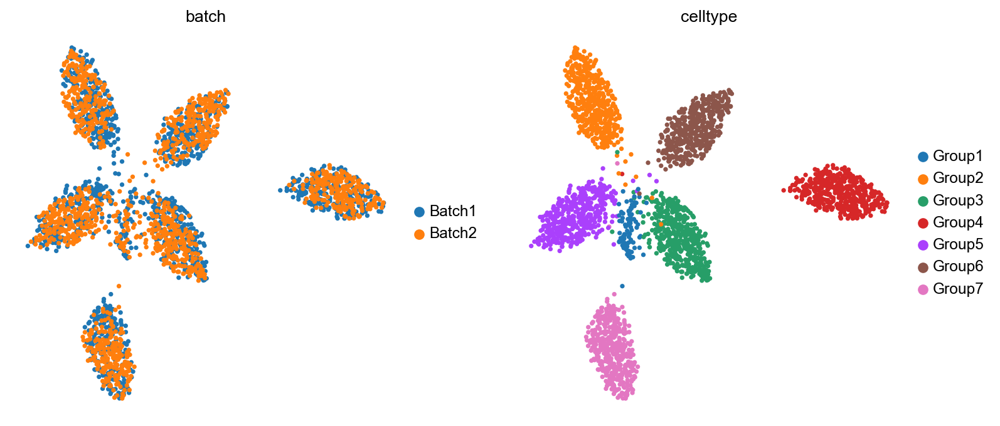

13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.387963
cASW                        0.599930
F1 ASW                      0.471206
bLISI                       0.542207
1-cLISI                     0.982680
F1 LISI                     0.698826
kBET Accept Rate            0.263911
graph connectivity          0.991200
ARI                         0.972948
NMI                         0.957098
CC score                         NaN
HVG score                   0.696000
knn sim                     0.083683
cell-cell sim preservation  0.683812
exp sim                     0.885101
pos rate                    0.984887
true pos rate               0.703850
DEG precision               0.444231
DEG recall                  0.061200
DEG F1                      0.105933
Avg score (batch)           0.577826
Avg score (bio)             0.695207
Weighted score              0.648255




rare1_0.2 200




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 1590
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 79500.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.7078, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0086, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-14.1465, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(8.2166, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-14.2937, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(3.9583, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-14.1881, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(2.2989, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

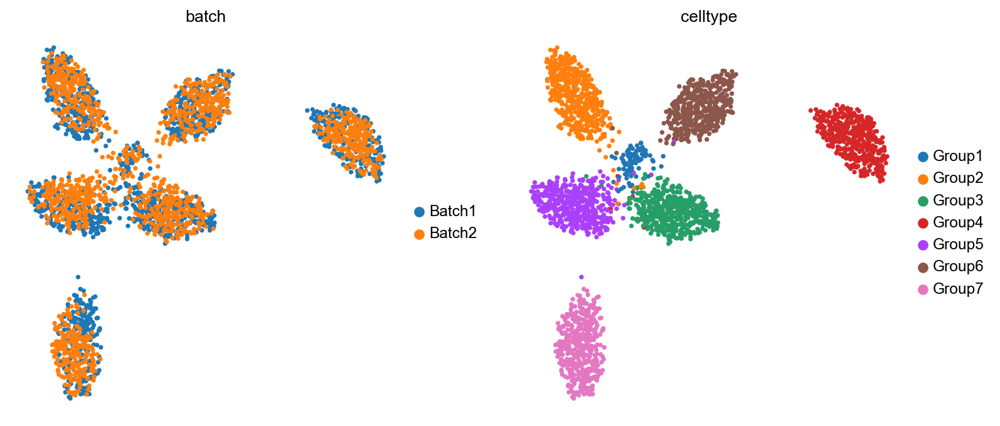

13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.389695
cASW                        0.594850
F1 ASW                      0.470898
bLISI                       0.556435
1-cLISI                     0.977874
F1 LISI                     0.709275
kBET Accept Rate            0.241049
graph connectivity          0.995590
ARI                         0.959493
NMI                         0.940831
CC score                         NaN
HVG score                   0.667000
knn sim                     0.077516
cell-cell sim preservation  0.681181
exp sim                     0.848608
pos rate                    0.980569
true pos rate               0.801367
DEG precision               0.516326
DEG recall                  0.057142
DEG F1                      0.100861
Avg score (batch)           0.596827
Avg score (bio)             0.682878
Weighted score              0.648458




rare1_0.2 300




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 1590
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 79500.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.7078, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0086, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-14.1465, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(8.2166, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-14.2937, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(3.9583, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-14.1881, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(2.2989, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  200
d step loss:  tensor(-13.8673, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tenso

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

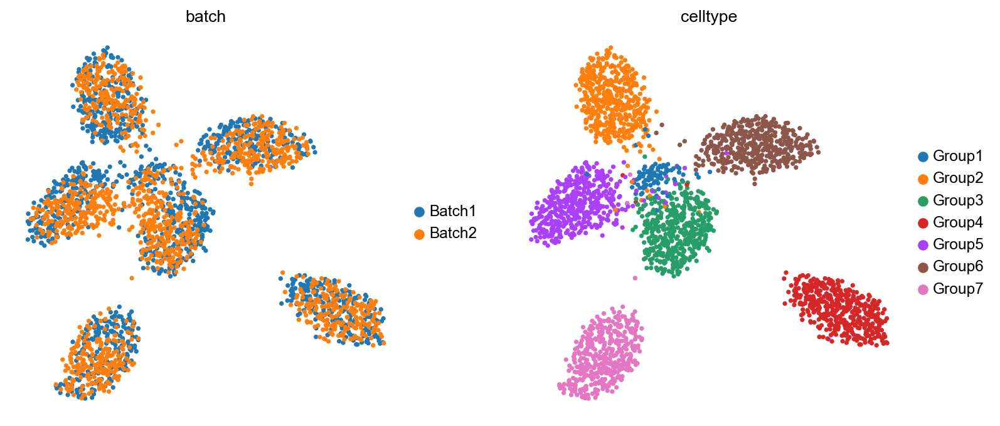

13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.394031
cASW                        0.586502
F1 ASW                      0.471376
bLISI                       0.699065
1-cLISI                     0.970171
F1 LISI                     0.812602
kBET Accept Rate            0.453282
graph connectivity          0.981448
ARI                         0.931078
NMI                         0.903973
CC score                         NaN
HVG score                   0.662000
knn sim                     0.071361
cell-cell sim preservation  0.681336
exp sim                     0.823116
pos rate                    0.972652
true pos rate               0.866139
DEG precision               0.539474
DEG recall                  0.057342
DEG F1                      0.101785
Avg score (batch)           0.678793
Avg score (bio)             0.670397
Weighted score              0.673756




rare1_0.1 50




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 1698
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 84900.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6106, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0053, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

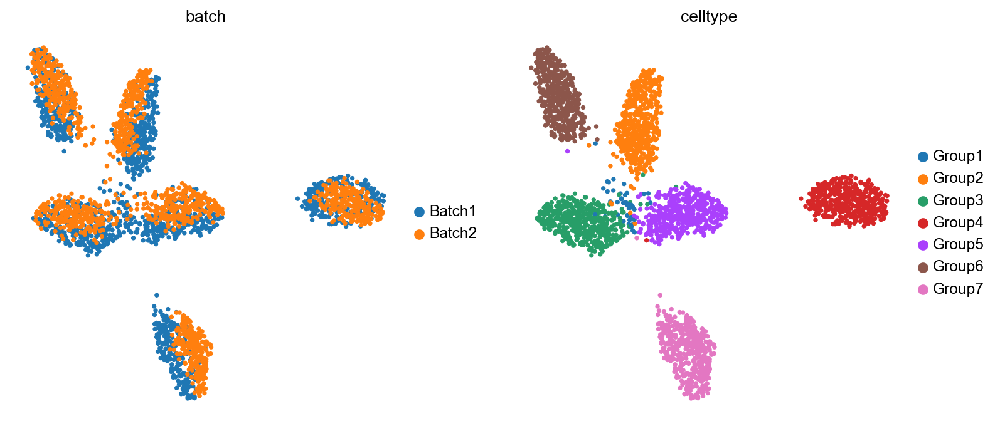

13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.373696
cASW                        0.601128
F1 ASW                      0.460882
bLISI                       0.415627
1-cLISI                     0.983205
F1 LISI                     0.584268
kBET Accept Rate            0.253420
graph connectivity          0.984167
ARI                         0.971649
NMI                         0.953755
CC score                         NaN
HVG score                   0.700000
knn sim                     0.084309
cell-cell sim preservation  0.692889
exp sim                     0.913478
pos rate                    0.979517
true pos rate               0.378932
DEG precision               0.384099
DEG recall                  0.060124
DEG F1                      0.099263
Avg score (batch)           0.481169
Avg score (bio)             0.697919
Weighted score              0.611219




rare1_0.1 100




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 1698
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 84900.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6106, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0053, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-14.1850, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(8.3925, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

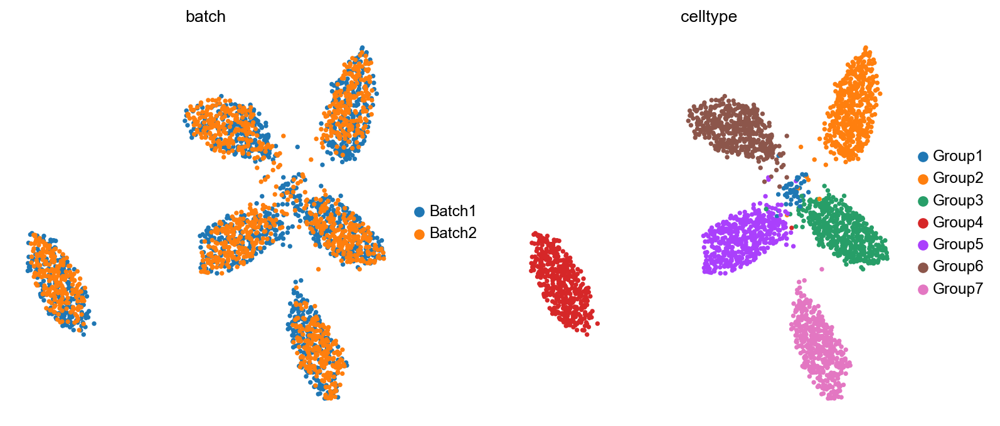

13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.388083
cASW                        0.590064
F1 ASW                      0.468220
bLISI                       0.527770
1-cLISI                     0.981458
F1 LISI                     0.686422
kBET Accept Rate            0.248854
graph connectivity          0.987254
ARI                         0.964174
NMI                         0.943496
CC score                         NaN
HVG score                   0.707000
knn sim                     0.077256
cell-cell sim preservation  0.683593
exp sim                     0.885621
pos rate                    0.982078
true pos rate               0.702268
DEG precision               0.513692
DEG recall                  0.058610
DEG F1                      0.101277
Avg score (batch)           0.570846
Avg score (bio)             0.691602
Weighted score              0.643299




rare1_0.1 200




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 1698
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 84900.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6106, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0053, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-14.1850, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(8.3925, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-13.9815, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(4.5557, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-14.3491, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(2.0045, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

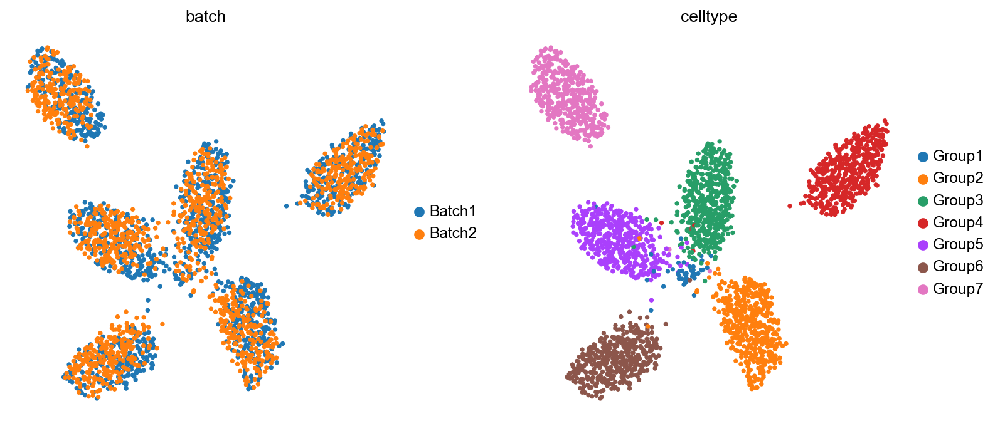

13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.390853
cASW                        0.589782
F1 ASW                      0.470141
bLISI                       0.569548
1-cLISI                     0.978734
F1 LISI                     0.720071
kBET Accept Rate            0.260921
graph connectivity          0.983184
ARI                         0.955217
NMI                         0.934022
CC score                         NaN
HVG score                   0.683000
knn sim                     0.070821
cell-cell sim preservation  0.681253
exp sim                     0.848046
pos rate                    0.982078
true pos rate               0.782370
DEG precision               0.506251
DEG recall                  0.059330
DEG F1                      0.103774
Avg score (batch)           0.597375
Avg score (bio)             0.682673
Weighted score              0.648554




rare1_0.1 300




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 1698
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 84900.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6106, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0053, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-14.1850, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(8.3925, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-13.9815, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(4.5557, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-14.3491, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(2.0045, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  200
d step loss:  tensor(-13.2577, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tenso

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

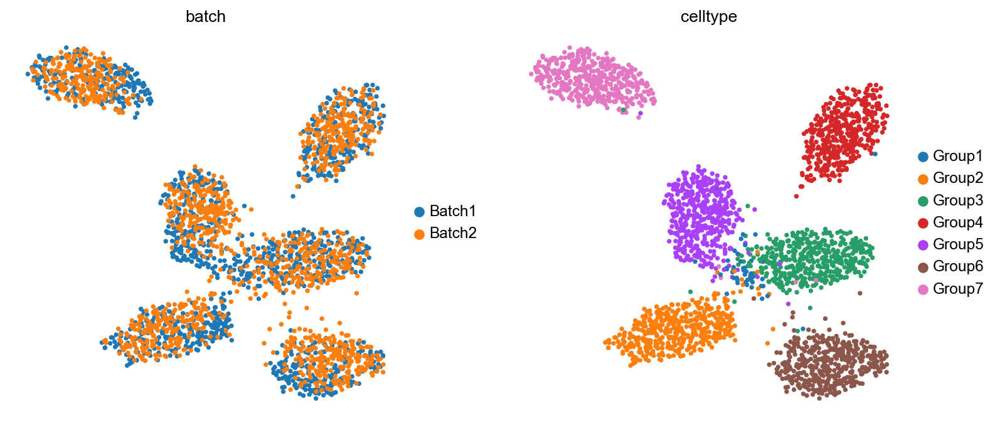

13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.394034
cASW                        0.578230
F1 ASW                      0.468684
bLISI                       0.679945
1-cLISI                     0.972921
F1 LISI                     0.800468
kBET Accept Rate            0.410288
graph connectivity          0.979457
ARI                         0.937845
NMI                         0.918561
CC score                         NaN
HVG score                   0.666000
knn sim                     0.066921
cell-cell sim preservation  0.681230
exp sim                     0.823430
pos rate                    0.971105
true pos rate               0.861010
DEG precision               0.546745
DEG recall                  0.056382
DEG F1                      0.099777
Avg score (batch)           0.664947
Avg score (bio)             0.671602
Weighted score              0.668940




common_5 50




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 1360
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 68000.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6750, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0020, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

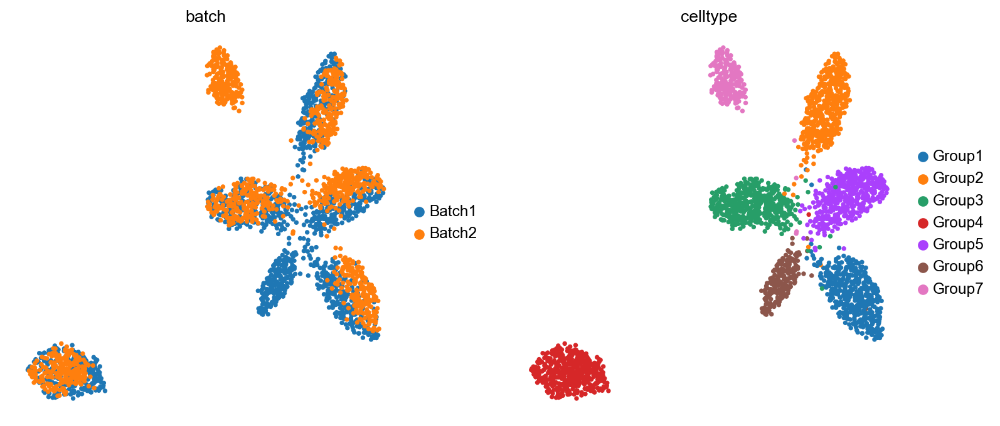

Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.375926
cASW                        0.606053
F1 ASW                      0.464024
bLISI                       0.404449
1-cLISI                     0.981888
F1 LISI                     0.572910
kBET Accept Rate            0.221339
graph connectivity          0.997731
ARI                         0.966234
NMI                         0.952233
CC score                         NaN
HVG score                   0.707000
knn sim                     0.082907
cell-cell sim preservation  0.696762
exp sim                     0.490705
pos rate                    0.981805
true pos rate               0.477906
DEG precision               0.283664
DEG recall                  0.071337
DEG F1                      0.111220
Avg score (batch)           0.495470
Avg score (bio)             0.657681
Weighted score              0.592796




common_5 100




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 1360
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 68000.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6750, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0020, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-15.3594, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(8.2529, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

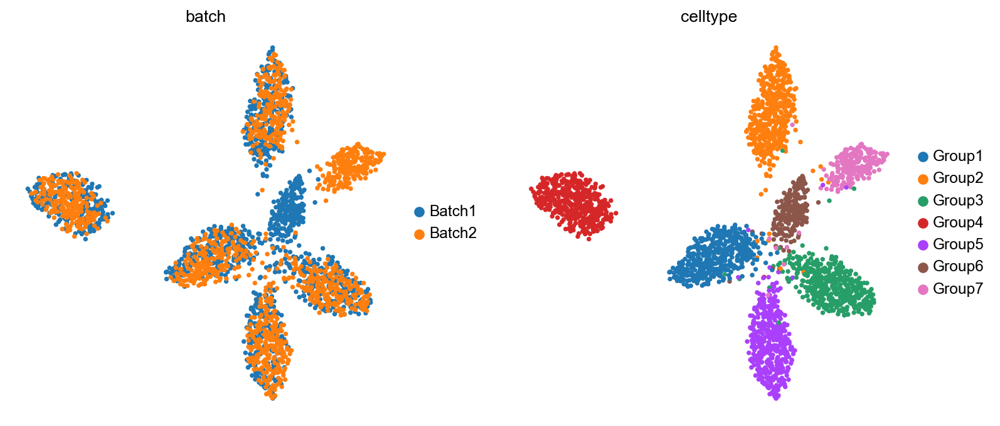

Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.387825
cASW                        0.585351
F1 ASW                      0.466542
bLISI                       0.480557
1-cLISI                     0.977058
F1 LISI                     0.644247
kBET Accept Rate            0.178519
graph connectivity          0.992527
ARI                         0.942506
NMI                         0.915995
CC score                         NaN
HVG score                   0.704000
knn sim                     0.078675
cell-cell sim preservation  0.685876
exp sim                     0.487796
pos rate                    0.978091
true pos rate               0.716673
DEG precision               0.351434
DEG recall                  0.067175
DEG F1                      0.108982
Avg score (batch)           0.551220
Avg score (bio)             0.646433
Weighted score              0.608348




common_5 200




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 1360
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 68000.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6750, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0020, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-15.3594, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(8.2529, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-14.8631, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(3.7517, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-15.2644, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.2941, device='cuda:0', grad_fn=<NegB

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

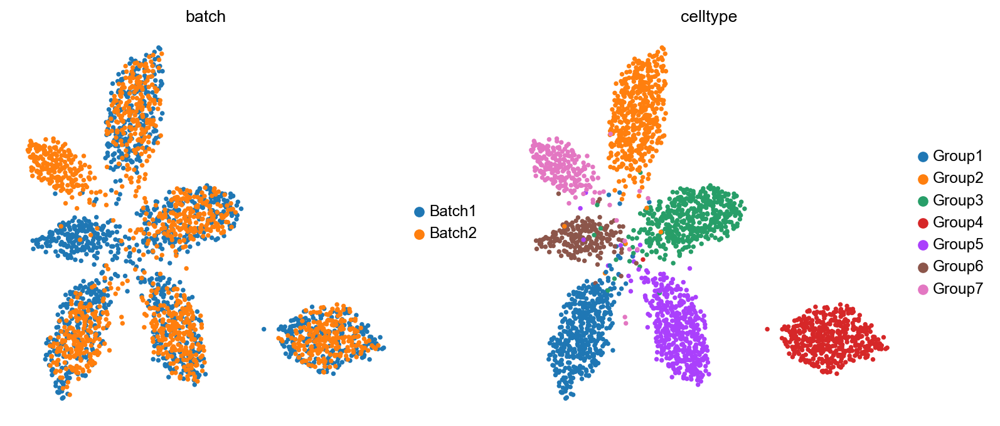

Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.389383
cASW                        0.574255
F1 ASW                      0.464086
bLISI                       0.509971
1-cLISI                     0.969460
F1 LISI                     0.668360
kBET Accept Rate            0.206424
graph connectivity          0.994214
ARI                         0.935950
NMI                         0.909814
CC score                         NaN
HVG score                   0.672000
knn sim                     0.068961
cell-cell sim preservation  0.684493
exp sim                     0.486550
pos rate                    0.970293
true pos rate               0.746751
DEG precision               0.387501
DEG recall                  0.065739
DEG F1                      0.108358
Avg score (batch)           0.569349
Avg score (bio)             0.638013
Weighted score              0.610547




common_5 300




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 1360
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 68000.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6750, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0020, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-15.3594, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(8.2529, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-14.8631, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(3.7517, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-15.2644, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.2941, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  200
d step loss:  tensor(-14.8638, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

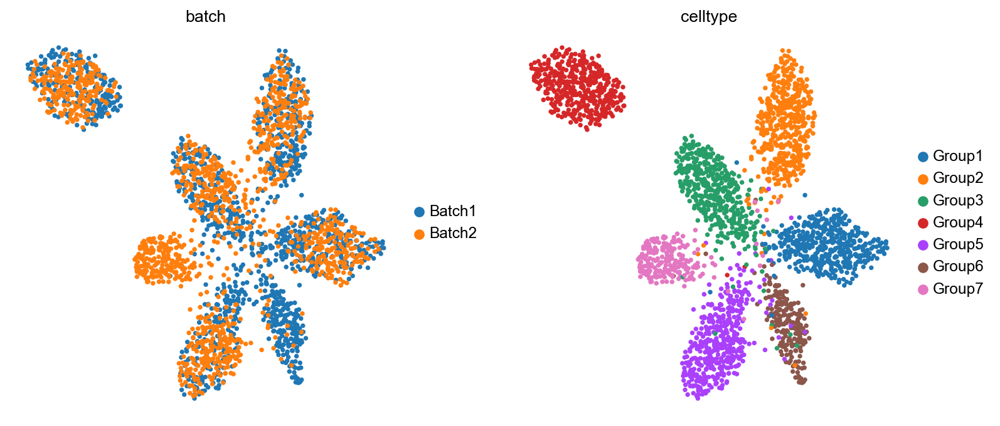

Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.394640
cASW                        0.576657
F1 ASW                      0.468594
bLISI                       0.652764
1-cLISI                     0.963925
F1 LISI                     0.778400
kBET Accept Rate            0.347151
graph connectivity          0.990586
ARI                         0.911392
NMI                         0.882594
CC score                         NaN
HVG score                   0.661000
knn sim                     0.066502
cell-cell sim preservation  0.683031
exp sim                     0.484506
pos rate                    0.963609
true pos rate               0.855923
DEG precision               0.419161
DEG recall                  0.065279
DEG F1                      0.109415
Avg score (batch)           0.648213
Avg score (bio)             0.630263
Weighted score              0.637443




common_3 50




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 889
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 44450.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.7010, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0088, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

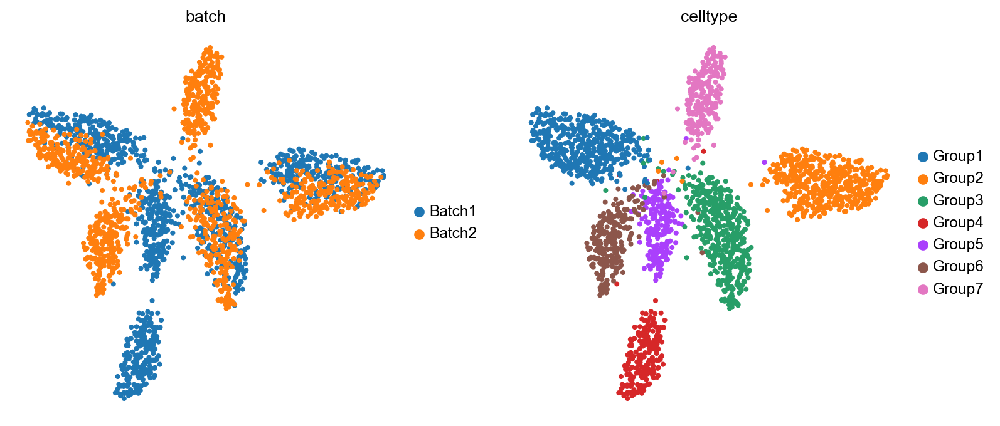

Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group5 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group4 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
11


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.377437
cASW                        0.565183
F1 ASW                      0.452613
bLISI                       0.408322
1-cLISI                     0.965383
F1 LISI                     0.573903
kBET Accept Rate            0.219870
graph connectivity          0.995703
ARI                         0.932826
NMI                         0.907692
CC score                         NaN
HVG score                   0.693000
knn sim                     0.073734
cell-cell sim preservation  0.697197
exp sim                     0.508350
pos rate                    0.973963
true pos rate               0.627096
DEG precision               0.225359
DEG recall                  0.068277
DEG F1                      0.102853
Avg score (batch)           0.525685
Avg score (bio)             0.642018
Weighted score              0.595485




common_3 100




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 889
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 44450.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.7010, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0088, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-17.0884, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(8.8466, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

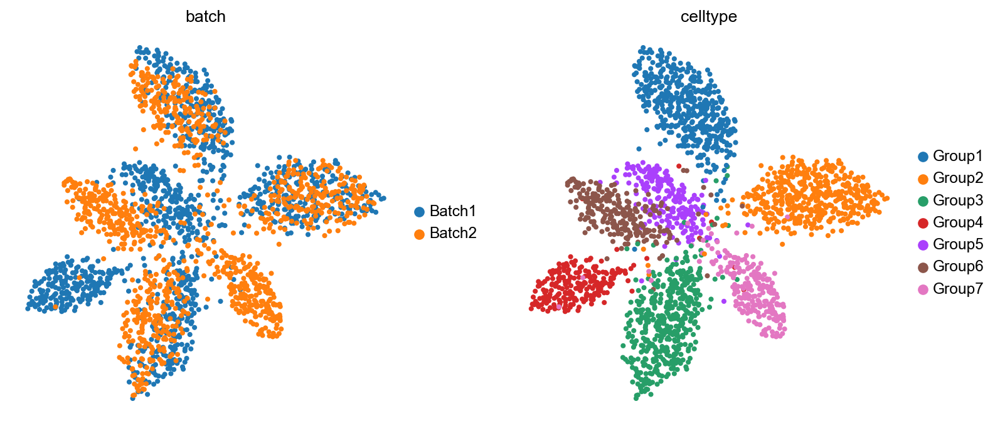

Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group5 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group4 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
11


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.385261
cASW                        0.552270
F1 ASW                      0.453890
bLISI                       0.463851
1-cLISI                     0.946435
F1 LISI                     0.622576
kBET Accept Rate            0.219288
graph connectivity          0.991166
ARI                         0.891898
NMI                         0.848419
CC score                         NaN
HVG score                   0.684000
knn sim                     0.068375
cell-cell sim preservation  0.688526
exp sim                     0.504901
pos rate                    0.937776
true pos rate               0.703001
DEG precision               0.249705
DEG recall                  0.068130
DEG F1                      0.103782
Avg score (batch)           0.552513
Avg score (bio)             0.622638
Weighted score              0.594588




common_3 200




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 889
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 44450.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.7010, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0088, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-17.0884, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(8.8466, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-16.0371, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(5.0438, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-16.4511, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(2.4957, device='cuda:0', grad_fn=<NegB

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

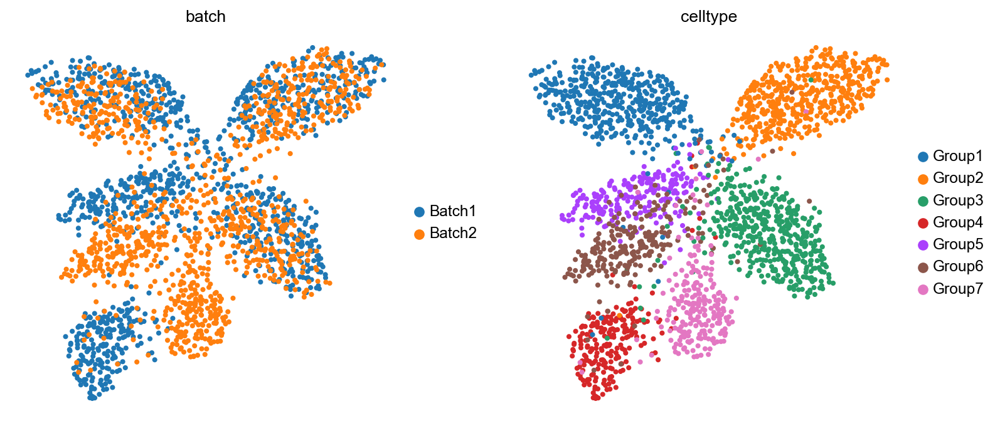

Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group5 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group4 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
11


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.388922
cASW                        0.550247
F1 ASW                      0.455729
bLISI                       0.485695
1-cLISI                     0.927945
F1 LISI                     0.637642
kBET Accept Rate            0.195079
graph connectivity          0.979801
ARI                         0.838567
NMI                         0.788020
CC score                         NaN
HVG score                   0.665000
knn sim                     0.060413
cell-cell sim preservation  0.682844
exp sim                     0.503420
pos rate                    0.902030
true pos rate               0.776699
DEG precision               0.267439
DEG recall                  0.067716
DEG F1                      0.103761
Avg score (batch)           0.565239
Avg score (bio)             0.602225
Weighted score              0.587430




common_3 300




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 889
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 44450.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.7010, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0088, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-17.0884, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(8.8466, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-16.0371, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(5.0438, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-16.4511, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(2.4957, device='cuda:0', grad_fn=<NegB

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

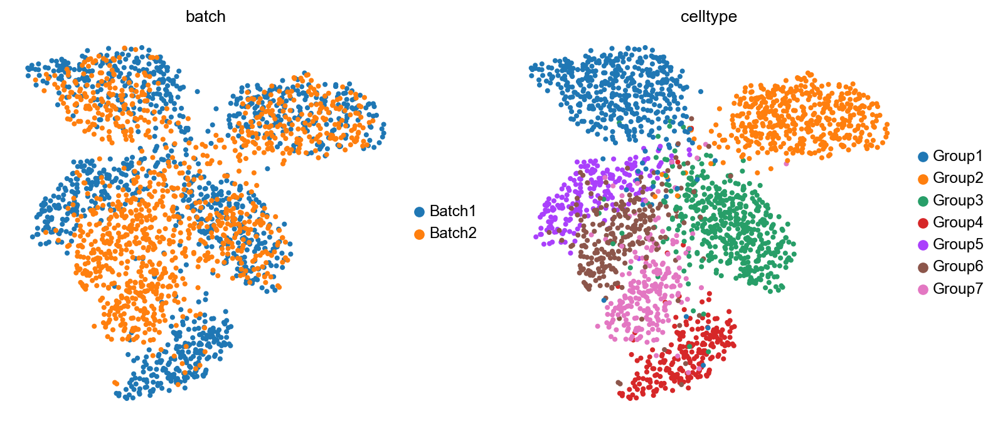

Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group5 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group4 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
11


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.394200
cASW                        0.551054
F1 ASW                      0.459613
bLISI                       0.608864
1-cLISI                     0.902495
F1 LISI                     0.727156
kBET Accept Rate            0.276451
graph connectivity          0.978994
ARI                         0.738071
NMI                         0.726281
CC score                         NaN
HVG score                   0.656000
knn sim                     0.054601
cell-cell sim preservation  0.678248
exp sim                     0.502067
pos rate                    0.869373
true pos rate               0.836275
DEG precision               0.283384
DEG recall                  0.063709
DEG F1                      0.099727
Avg score (batch)           0.618957
Avg score (bio)             0.577792
Weighted score              0.594258




common_1 50




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 522
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 26100.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.7149, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0021, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

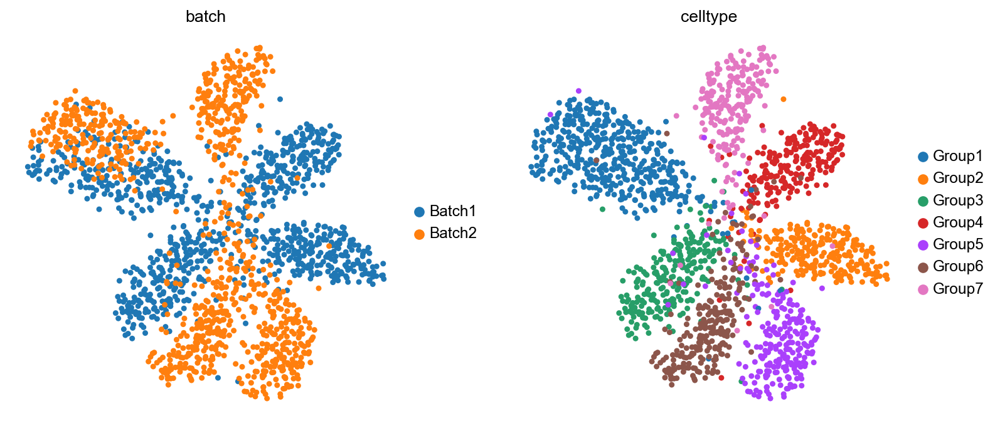

Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group5 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group4 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group3 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group2 contains only one batch or has less than 10 cells. Skip.
9


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.367978
cASW                        0.526814
F1 ASW                      0.433298
bLISI                       0.416196
1-cLISI                     0.909032
F1 LISI                     0.570974
kBET Accept Rate            0.265217
graph connectivity          0.992268
ARI                         0.812528
NMI                         0.767692
CC score                         NaN
HVG score                   0.700990
knn sim                     0.061456
cell-cell sim preservation  0.710521
exp sim                     0.467222
pos rate                    0.920239
true pos rate               0.768313
DEG precision               0.177427
DEG recall                  0.062925
DEG F1                      0.090608
Avg score (batch)           0.561994
Avg score (bio)             0.596710
Weighted score              0.582824




common_1 100




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 522
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 26100.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.7149, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0021, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-19.5033, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(6.9492, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

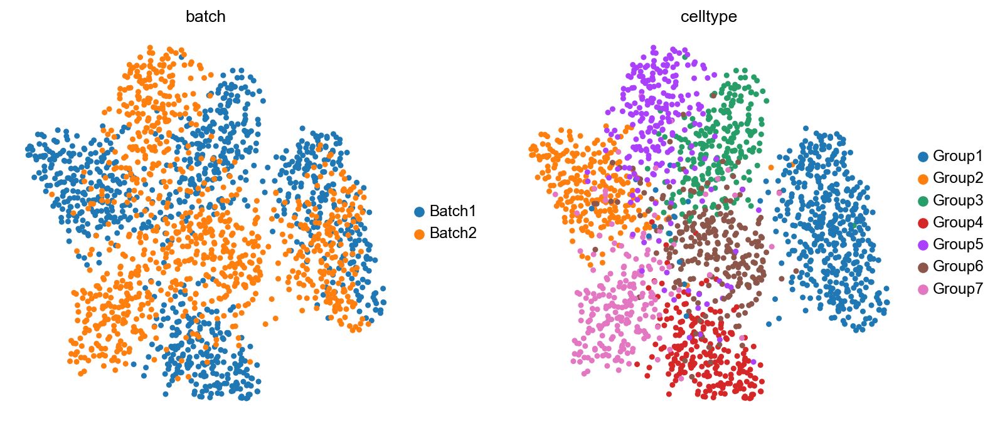

Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group5 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group4 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group3 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group2 contains only one batch or has less than 10 cells. Skip.
9


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.377671
cASW                        0.515694
F1 ASW                      0.436020
bLISI                       0.473566
1-cLISI                     0.865096
F1 LISI                     0.612074
kBET Accept Rate            0.291087
graph connectivity          0.978725
ARI                         0.672551
NMI                         0.644716
CC score                         NaN
HVG score                   0.673267
knn sim                     0.053418
cell-cell sim preservation  0.696905
exp sim                     0.463580
pos rate                    0.829626
true pos rate               0.718394
DEG precision               0.178097
DEG recall                  0.064954
DEG F1                      0.092413
Avg score (batch)           0.567889
Avg score (bio)             0.550727
Weighted score              0.557591




common_1 200




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 522
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 26100.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.7149, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0021, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-19.5033, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(6.9492, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-18.0557, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(4.2170, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-18.0944, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.9791, device='cuda:0', grad_fn=<NegB

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

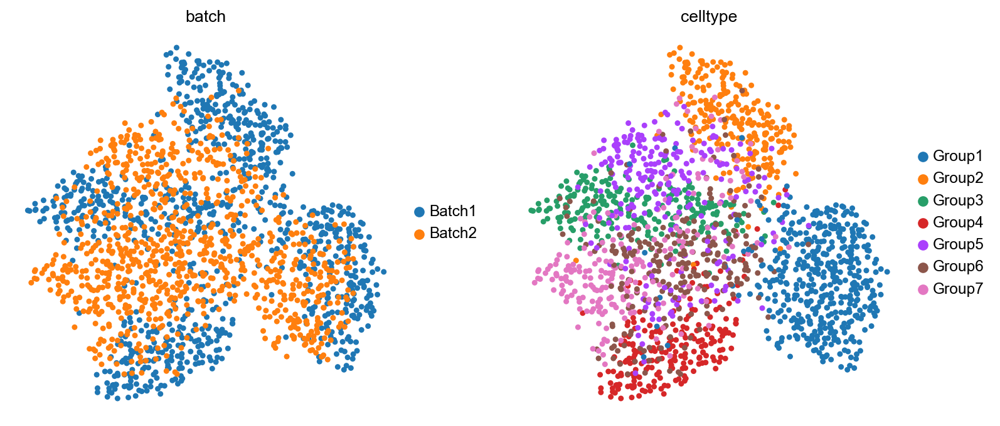

Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group5 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group4 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group3 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group2 contains only one batch or has less than 10 cells. Skip.
9


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.380367
cASW                        0.509487
F1 ASW                      0.435559
bLISI                       0.523110
1-cLISI                     0.805847
F1 LISI                     0.634402
kBET Accept Rate            0.323913
graph connectivity          0.948781
ARI                         0.458364
NMI                         0.487028
CC score                         NaN
HVG score                   0.670297
knn sim                     0.044295
cell-cell sim preservation  0.690998
exp sim                     0.458825
pos rate                    0.695605
true pos rate               0.635920
DEG precision               0.180359
DEG recall                  0.061634
DEG F1                      0.088946
Avg score (batch)           0.562418
Avg score (bio)             0.490969
Weighted score              0.519549




common_1 300




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 522
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 26100.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.7149, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0021, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-19.5033, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(6.9492, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-18.0557, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(4.2170, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-18.0944, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.9791, device='cuda:0', grad_fn=<NegB

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

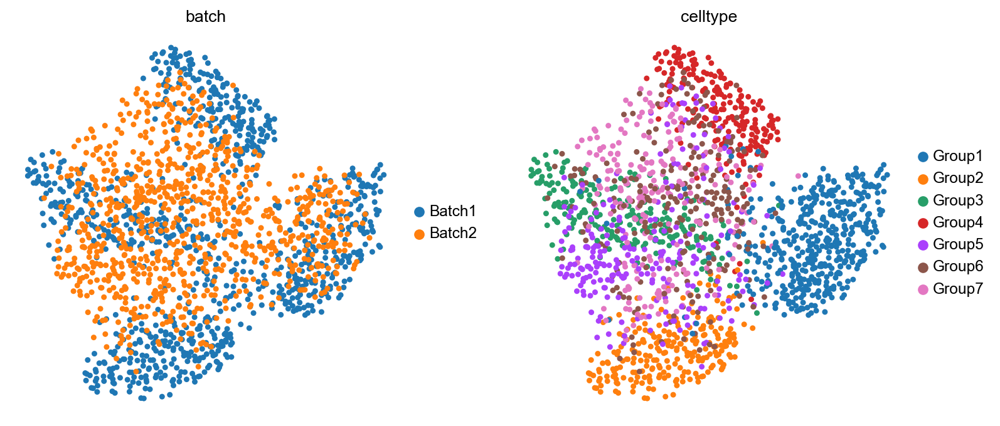

Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group5 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group4 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group3 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group2 contains only one batch or has less than 10 cells. Skip.
9


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.384108
cASW                        0.513123
F1 ASW                      0.439340
bLISI                       0.565872
1-cLISI                     0.784042
F1 LISI                     0.657327
kBET Accept Rate            0.289348
graph connectivity          0.923575
ARI                         0.507721
NMI                         0.496371
CC score                         NaN
HVG score                   0.661386
knn sim                     0.041111
cell-cell sim preservation  0.685894
exp sim                     0.458336
pos rate                    0.612588
true pos rate               0.574607
DEG precision               0.194301
DEG recall                  0.060000
DEG F1                      0.089489
Avg score (batch)           0.547502
Avg score (bio)             0.485006
Weighted score              0.510005




batch1_1000 50




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 601
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 30050.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6388, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0002, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

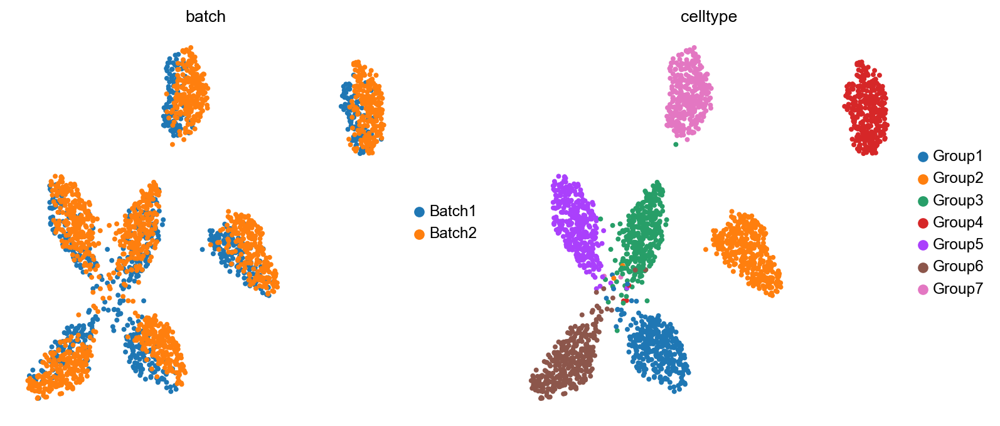

7


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.344085
cASW                        0.611707
F1 ASW                      0.440429
bLISI                       0.259080
1-cLISI                     0.982150
F1 LISI                     0.410005
kBET Accept Rate            0.240155
graph connectivity          0.996995
ARI                         0.965419
NMI                         0.954538
CC score                         NaN
HVG score                   0.701000
knn sim                     0.066974
cell-cell sim preservation  0.715045
exp sim                     0.902699
pos rate                    0.984700
true pos rate               0.388865
DEG precision               0.263083
DEG recall                  0.065166
DEG F1                      0.104308
Avg score (batch)           0.445836
Avg score (bio)             0.698854
Weighted score              0.597647




batch1_1000 100




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 601
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 30050.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6388, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0002, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-17.9030, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(9.0481, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

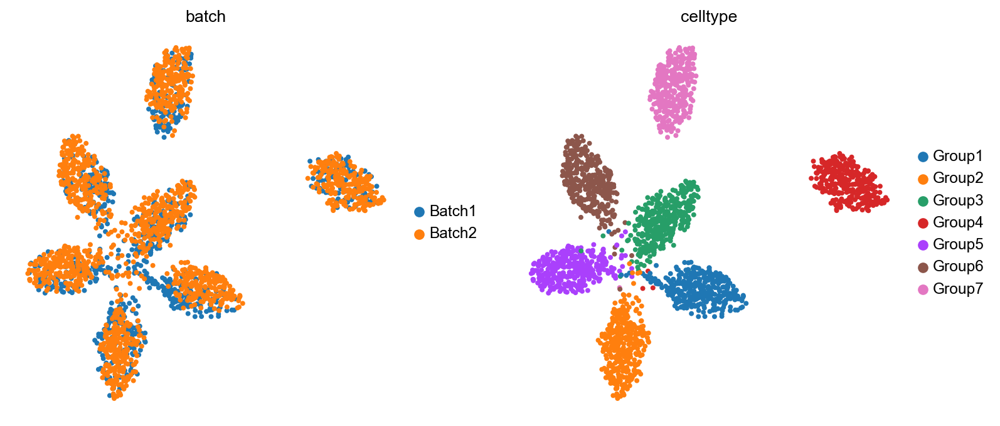

7


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.365236
cASW                        0.602646
F1 ASW                      0.454824
bLISI                       0.315634
1-cLISI                     0.977454
F1 LISI                     0.477180
kBET Accept Rate            0.287380
graph connectivity          0.998738
ARI                         0.952768
NMI                         0.937937
CC score                         NaN
HVG score                   0.694000
knn sim                     0.061226
cell-cell sim preservation  0.709613
exp sim                     0.859733
pos rate                    0.981300
true pos rate               0.599660
DEG precision               0.304531
DEG recall                  0.063897
DEG F1                      0.105430
Avg score (batch)           0.513330
Avg score (bio)             0.688211
Weighted score              0.618258




batch1_1000 200




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 601
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 30050.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6388, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0002, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-17.9030, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(9.0481, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-17.2165, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(6.6303, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-17.4616, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(2.1141, device='cuda:0', grad_fn=<NegB

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

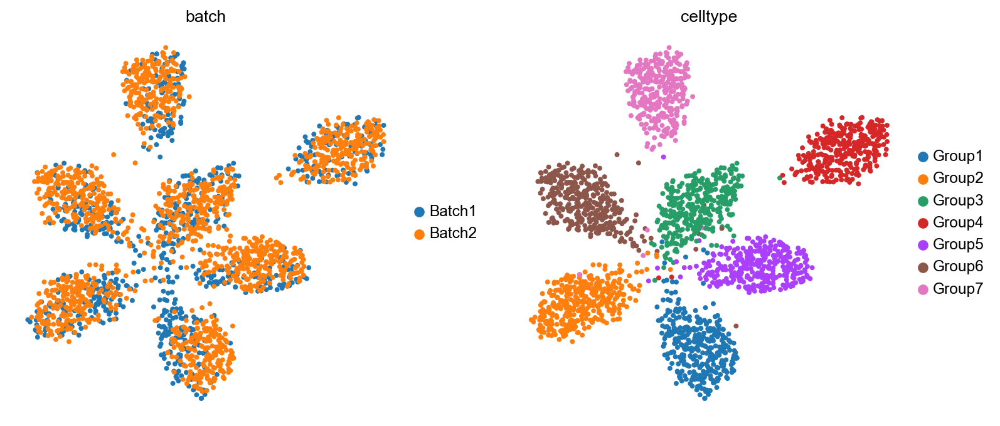

7


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.373721
cASW                        0.596571
F1 ASW                      0.459554
bLISI                       0.372821
1-cLISI                     0.970162
F1 LISI                     0.538647
kBET Accept Rate            0.345340
graph connectivity          0.996573
ARI                         0.935952
NMI                         0.919296
CC score                         NaN
HVG score                   0.684000
knn sim                     0.053669
cell-cell sim preservation  0.702417
exp sim                     0.818137
pos rate                    0.977051
true pos rate               0.781555
DEG precision               0.355465
DEG recall                  0.060886
DEG F1                      0.103743
Avg score (batch)           0.574002
Avg score (bio)             0.676100
Weighted score              0.635261




batch1_1000 300




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 601
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 30050.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6388, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0002, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-17.9030, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(9.0481, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-17.2165, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(6.6303, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-17.4616, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(2.1141, device='cuda:0', grad_fn=<NegB

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

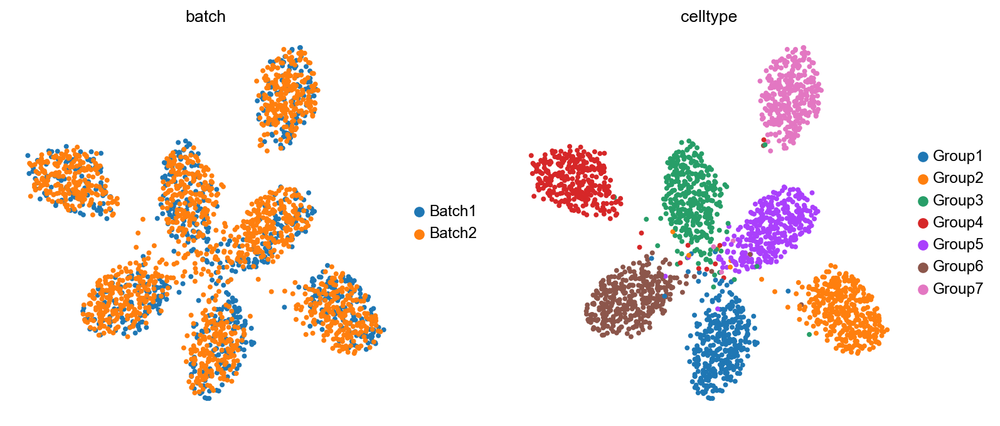

7


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.375099
cASW                        0.595555
F1 ASW                      0.460292
bLISI                       0.365027
1-cLISI                     0.966370
F1 LISI                     0.529897
kBET Accept Rate            0.376937
graph connectivity          0.995294
ARI                         0.924096
NMI                         0.903793
CC score                         NaN
HVG score                   0.677000
knn sim                     0.054483
cell-cell sim preservation  0.695395
exp sim                     0.792153
pos rate                    0.973226
true pos rate               0.895878
DEG precision               0.384032
DEG recall                  0.058759
DEG F1                      0.101771
Avg score (batch)           0.601647
Avg score (bio)             0.668384
Weighted score              0.641689




batch1_500 50




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 105
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 5250.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(9.1174, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0049, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

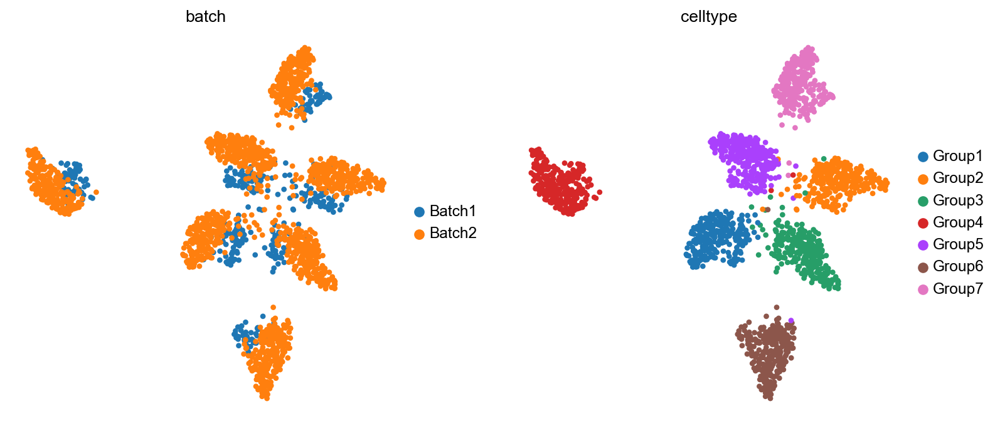

5


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.264453
cASW                        0.611591
F1 ASW                      0.369244
bLISI                       0.134177
1-cLISI                     0.982013
F1 LISI                     0.236095
kBET Accept Rate            0.121336
graph connectivity          0.997910
ARI                         0.956301
NMI                         0.943538
CC score                         NaN
HVG score                   0.722000
knn sim                     0.072706
cell-cell sim preservation  0.751782
exp sim                     0.930536
pos rate                    0.984168
true pos rate               0.191522
DEG precision               0.253928
DEG recall                  0.059864
DEG F1                      0.096792
Avg score (batch)           0.341879
Avg score (bio)             0.705143
Weighted score              0.559837




batch1_500 100




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 105
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 5250.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(9.1174, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0049, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-26.9008, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(6.5010, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

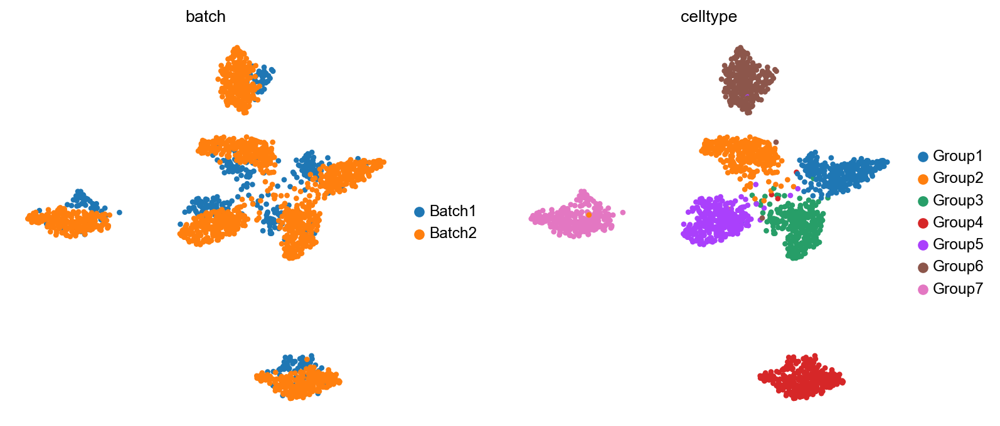

5


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.257711
cASW                        0.615215
F1 ASW                      0.363255
bLISI                       0.129317
1-cLISI                     0.982175
F1 LISI                     0.228543
kBET Accept Rate            0.112652
graph connectivity          0.996039
ARI                         0.957482
NMI                         0.943108
CC score                         NaN
HVG score                   0.731000
knn sim                     0.064449
cell-cell sim preservation  0.747119
exp sim                     0.880616
pos rate                    0.977017
true pos rate               0.164454
DEG precision               0.234870
DEG recall                  0.055480
DEG F1                      0.089675
Avg score (batch)           0.332034
Avg score (bio)             0.698786
Weighted score              0.552085




batch1_500 200




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 105
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 5250.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(9.1174, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0049, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-26.9008, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(6.5010, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-25.6406, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(1.1746, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-25.8137, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.1594, device='cuda:0', grad_fn=<NegBa

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

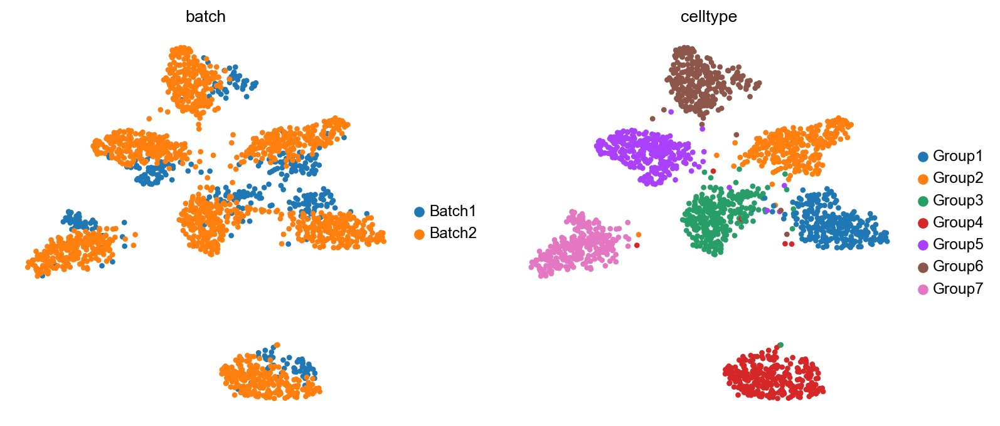

5


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.255741
cASW                        0.611567
F1 ASW                      0.360662
bLISI                       0.132252
1-cLISI                     0.979719
F1 LISI                     0.233046
kBET Accept Rate            0.126517
graph connectivity          0.994989
ARI                         0.949545
NMI                         0.934398
CC score                         NaN
HVG score                   0.743000
knn sim                     0.066798
cell-cell sim preservation  0.748972
exp sim                     0.863947
pos rate                    0.974974
true pos rate               0.150664
DEG precision               0.240824
DEG recall                  0.053559
DEG F1                      0.087546
Avg score (batch)           0.332033
Avg score (bio)             0.696047
Weighted score              0.550441




batch1_500 300




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 105
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 5250.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(9.1174, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0049, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-26.9008, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(6.5010, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-25.6406, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(1.1746, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-25.8137, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.1594, device='cuda:0', grad_fn=<NegBa

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

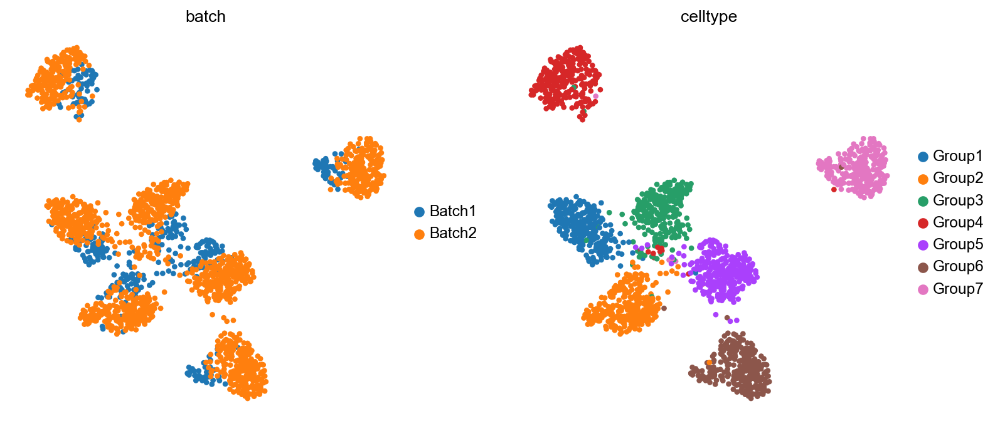

5


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.240042
cASW                        0.616028
F1 ASW                      0.345469
bLISI                       0.136331
1-cLISI                     0.977476
F1 LISI                     0.239288
kBET Accept Rate            0.122065
graph connectivity          0.994347
ARI                         0.925349
NMI                         0.907677
CC score                         NaN
HVG score                   0.738000
knn sim                     0.066174
cell-cell sim preservation  0.747708
exp sim                     0.860318
pos rate                    0.963739
true pos rate               0.144025
DEG precision               0.266156
DEG recall                  0.051390
DEG F1                      0.086023
Avg score (batch)           0.327362
Avg score (bio)             0.688849
Weighted score              0.544254




batch1_250 50




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 95
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 4750.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(9.3115, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0013, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

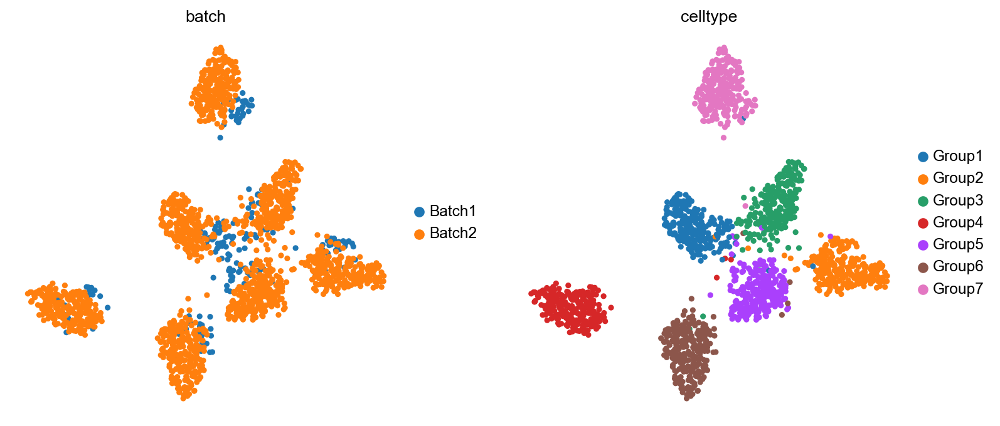

5


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.246547
cASW                        0.599846
F1 ASW                      0.349460
bLISI                       0.055932
1-cLISI                     0.972558
F1 LISI                     0.105781
kBET Accept Rate            0.369525
graph connectivity          0.994947
ARI                         0.924999
NMI                         0.906010
CC score                         NaN
HVG score                   0.694000
knn sim                     0.079743
cell-cell sim preservation  0.762688
exp sim                     0.934033
pos rate                    0.971607
true pos rate               0.579216
DEG precision               0.240590
DEG recall                  0.055883
DEG F1                      0.090365
Avg score (batch)           0.449234
Avg score (bio)             0.693585
Weighted score              0.595844




batch1_250 100




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 95
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 4750.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(9.3115, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0013, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-31.6575, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.6146, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

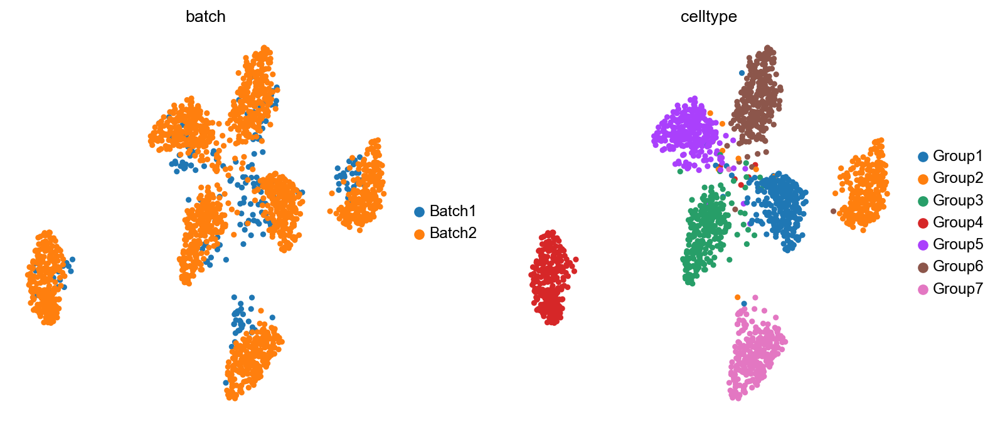

5


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.207480
cASW                        0.612501
F1 ASW                      0.309962
bLISI                       0.057011
1-cLISI                     0.975126
F1 LISI                     0.107724
kBET Accept Rate            0.367490
graph connectivity          0.991945
ARI                         0.926869
NMI                         0.912450
CC score                         NaN
HVG score                   0.748000
knn sim                     0.081164
cell-cell sim preservation  0.758102
exp sim                     0.896707
pos rate                    0.961953
true pos rate               0.457694
DEG precision               0.249439
DEG recall                  0.050176
DEG F1                      0.083181
Avg score (batch)           0.416324
Avg score (bio)             0.695605
Weighted score              0.583893




batch1_250 200




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 95
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 4750.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(9.3115, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0013, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-31.6575, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.6146, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-29.8423, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(3.1263, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-31.4911, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(1.5862, device='cuda:0', grad_fn=<NegBack

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

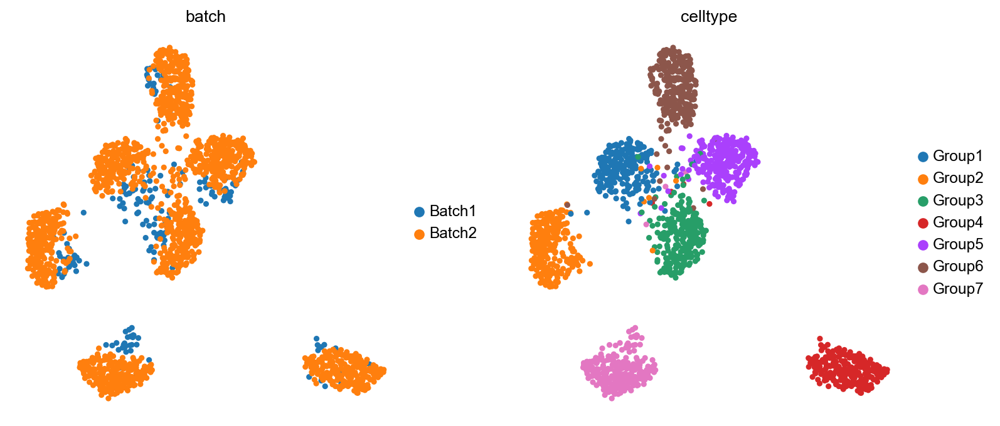

5


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.177654
cASW                        0.622758
F1 ASW                      0.276447
bLISI                       0.055374
1-cLISI                     0.976325
F1 LISI                     0.104805
kBET Accept Rate            0.354414
graph connectivity          0.990930
ARI                         0.915472
NMI                         0.897769
CC score                         NaN
HVG score                   0.778000
knn sim                     0.084786
cell-cell sim preservation  0.762459
exp sim                     0.900103
pos rate                    0.961953
true pos rate               0.387848
DEG precision               0.291649
DEG recall                  0.043051
DEG F1                      0.074882
Avg score (batch)           0.393244
Avg score (bio)             0.697451
Weighted score              0.575768




batch1_250 300




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 95
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 4750.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(9.3115, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0013, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-31.6575, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.6146, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-29.8423, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(3.1263, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-31.4911, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(1.5862, device='cuda:0', grad_fn=<NegBack

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

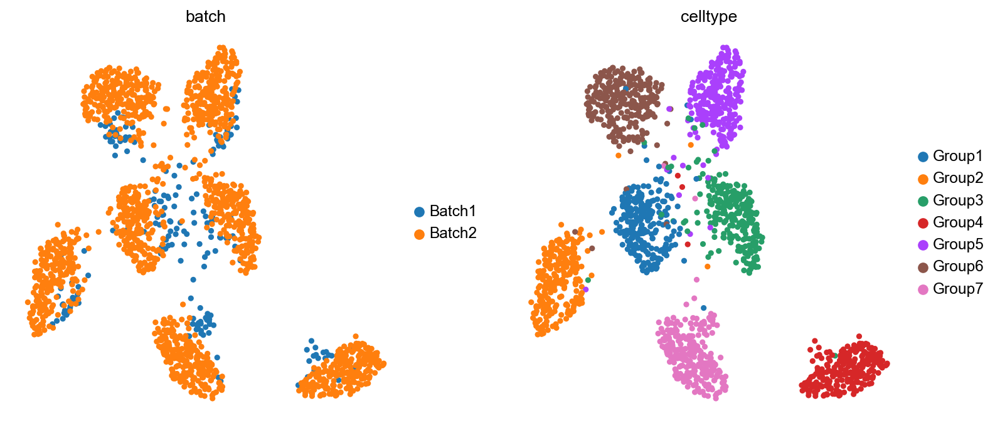

5


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.182176
cASW                        0.628010
F1 ASW                      0.282424
bLISI                       0.058950
1-cLISI                     0.978604
F1 LISI                     0.111201
kBET Accept Rate            0.366033
graph connectivity          0.990447
ARI                         0.926035
NMI                         0.907805
CC score                         NaN
HVG score                   0.765000
knn sim                     0.080173
cell-cell sim preservation  0.765351
exp sim                     0.894538
pos rate                    0.956843
true pos rate               0.345258
DEG precision               0.274788
DEG recall                  0.045295
DEG F1                      0.077634
Avg score (batch)           0.388573
Avg score (bio)             0.697999
Weighted score              0.574229


In [12]:
# 2022.5.10
from benchmark_scripts.wgan_resnet_standard import sequencing_train
folders = ['rare1_0.2', 'rare1_0.1', 'common_5', 'common_3', 'common_1', 'batch1_1000', 'batch1_500', 'batch1_250']
simulation_list = ['Sim2']
epochs = [50, 100, 200, 300]
print(simulation_list)
for dataname in simulation_list:
    for folder in folders:
        # Parameters
        npcs = 20
        reduction='pca'
        mode='rwMNN'
        for epoch in epochs:
            print('\n')
            print('\n')
            print(folder, epoch)
            print('\n')
            if folder == 'baseline':
                adata = sc.read_loom('/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/Sim/%s/%s_raw.loom' % (dataname, dataname), 
                                     sparse=False)  #Load cell line dataset(-> count data). 
            else:
                adata = sc.read_loom('/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/Sim/%s/%s/%s_raw.loom' % (dataname, folder, dataname), 
                                     sparse=False)
            sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
            sc.pp.log1p(adata)

            adata_raw = adata.copy()
            adata_raw.raw = adata_raw
            sc.pp.scale(adata_raw, max_value=10)
            sc.tl.pca(adata_raw, 20, svd_solver='arpack')

            sc.pp.highly_variable_genes(adata, n_top_genes=2000, batch_key='batch')
            adata = adata[:, adata.var['highly_variable']]
            
#             if folder.startswith('common'):
#                 epoch = 200
#             elif folder == 'real':
#                 epoch = 300
#             else:
#                 epoch = 600
            adata_new = sequencing_train(adata, key='batch', epoch=epoch, batch=1024, reduction='pca', mode='rwMNN', 
                                     metric='angular', subsample=3000, opt='AdamW',
                                     filtering=False, lr=0.0001, b1=0.9)

            adata_new.raw = adata_new
            sc.pp.scale(adata_new, max_value=10)
            sc.tl.pca(adata_new, 20, svd_solver='arpack')
            sc.pp.neighbors(adata_new)
            sc.tl.umap(adata_new)
            sc.set_figure_params(figsize=(5,5),fontsize=12)
            sc.pl.umap(adata_new, color=['batch', 'celltype'], frameon=False)

            savepath = None
            DEGpath = '/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/Sim/%s/geneinfo.txt' % (dataname)
            res = calculate_metrics(adata_new, adata_raw=adata_raw, savepath=savepath, is_raw=False, is_embed=False, 
                                    embed='X_pca', is_simul=True, org='human', dataname=dataname, DEGpath=DEGpath,
                                   verbose=False)

            batch_metrics = ['1-bASW', 'bLISI', 'kBET Accept Rate', 'graph connectivity', 'true pos rate']
            bio_metrics = ['cASW', '1-cLISI', 'ARI', 'NMI', 'HVG score', 'knn sim', 
                           'cell-cell sim preservation', 'exp sim', 'pos rate', 'DEG F1']
            res['Avg score (batch)'] = res[batch_metrics].mean(1)
            res['Avg score (bio)'] = res[bio_metrics].mean(1)
            res['Weighted score'] = 0.4*res['Avg score (batch)'] + 0.6*res['Avg score (bio)']
            print(res.T)

['Sim2']




common_5 50




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 1360
Calculating Random Walk Pairs...
Start filtering of selected pairs


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Number of rwMNN pairs after filtering is 20898.
Done.
Dimension of paired data is 20898.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6771, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0018, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

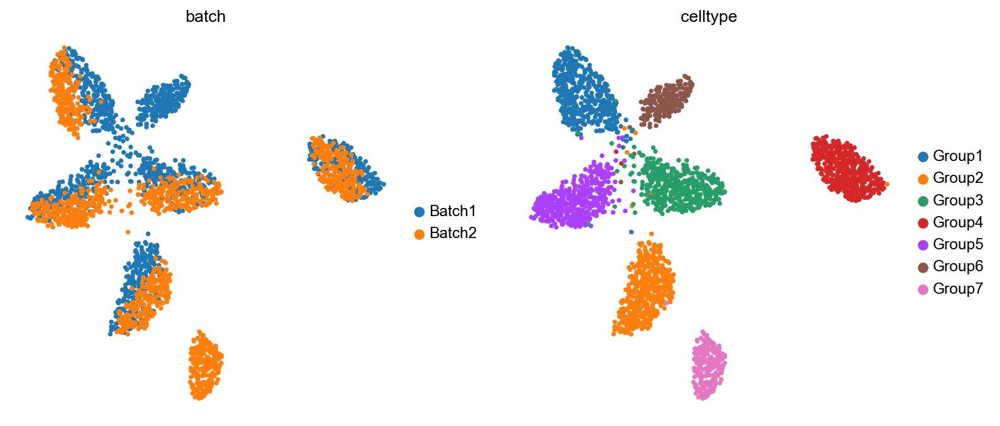

Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.371847
cASW                        0.607713
F1 ASW                      0.461383
bLISI                       0.360548
1-cLISI                     0.984294
F1 LISI                     0.527772
kBET Accept Rate            0.204350
graph connectivity          0.995513
ARI                         0.953823
NMI                         0.939683
CC score                         NaN
HVG score                   0.703000
knn sim                     0.081928
cell-cell sim preservation  0.703818
exp sim                     0.494200
pos rate                    0.983290
true pos rate               0.410694
DEG precision               0.294505
DEG recall                  0.071137
DEG F1                      0.111662
Avg score (batch)           0.468590
Avg score (bio)             0.656341
Weighted score              0.581241




common_3 50




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 889
Calculating Random Walk Pairs...
Start filtering of selected pairs


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Number of rwMNN pairs after filtering is 10182.
Done.
Dimension of paired data is 10182.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6720, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0093, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

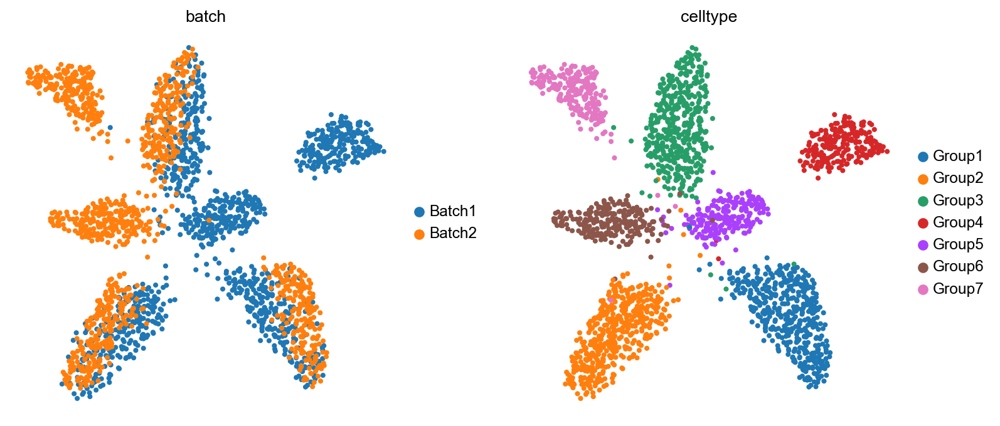

Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group5 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group4 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
11


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.374204
cASW                        0.580993
F1 ASW                      0.455215
bLISI                       0.367259
1-cLISI                     0.974246
F1 LISI                     0.533431
kBET Accept Rate            0.210662
graph connectivity          0.998021
ARI                         0.952756
NMI                         0.930037
CC score                         NaN
HVG score                   0.697000
knn sim                     0.073610
cell-cell sim preservation  0.708318
exp sim                     0.512671
pos rate                    0.979700
true pos rate               0.567961
DEG precision               0.237864
DEG recall                  0.067510
DEG F1                      0.102963
Avg score (batch)           0.503621
Avg score (bio)             0.651229
Weighted score              0.592186




common_1 50




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 522
Calculating Random Walk Pairs...
Start filtering of selected pairs


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Number of rwMNN pairs after filtering is 4768.
Done.
Dimension of paired data is 4768.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(9.3270, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0026, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

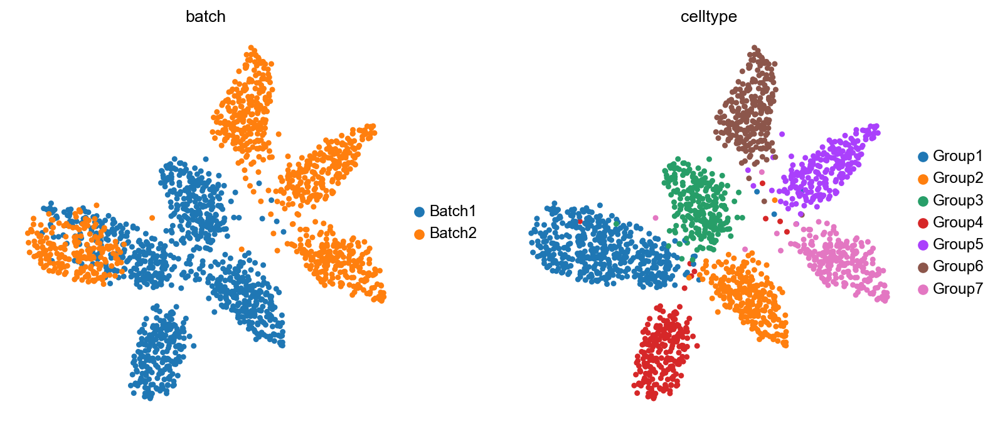

Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group5 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group4 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group3 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group2 contains only one batch or has less than 10 cells. Skip.
9


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.366479
cASW                        0.563100
F1 ASW                      0.443995
bLISI                       0.343415
1-cLISI                     0.959961
F1 LISI                     0.505863
kBET Accept Rate            0.166304
graph connectivity          0.995858
ARI                         0.925920
NMI                         0.911517
CC score                         NaN
HVG score                   0.719802
knn sim                     0.061223
cell-cell sim preservation  0.723644
exp sim                     0.470205
pos rate                    0.977754
true pos rate               0.800868
DEG precision               0.173551
DEG recall                  0.071635
DEG F1                      0.098672
Avg score (batch)           0.534585
Avg score (bio)             0.641180
Weighted score              0.598542


In [13]:
# 2022.5.10
from benchmark_scripts.wgan_resnet_standard import sequencing_train
folders = ['common_5', 'common_3', 'common_1']
simulation_list = ['Sim2']
epochs = [50]
print(simulation_list)
for dataname in simulation_list:
    for folder in folders:
        # Parameters
        npcs = 20
        reduction='pca'
        mode='rwMNN'
        for epoch in epochs:
            print('\n')
            print('\n')
            print(folder, epoch)
            print('\n')
            if folder == 'baseline':
                adata = sc.read_loom('/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/Sim/%s/%s_raw.loom' % (dataname, dataname), 
                                     sparse=False)  #Load cell line dataset(-> count data). 
            else:
                adata = sc.read_loom('/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/Sim/%s/%s/%s_raw.loom' % (dataname, folder, dataname), 
                                     sparse=False)
            sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
            sc.pp.log1p(adata)

            adata_raw = adata.copy()
            adata_raw.raw = adata_raw
            sc.pp.scale(adata_raw, max_value=10)
            sc.tl.pca(adata_raw, 20, svd_solver='arpack')

            sc.pp.highly_variable_genes(adata, n_top_genes=2000, batch_key='batch')
            adata = adata[:, adata.var['highly_variable']]
            
#             if folder.startswith('common'):
#                 epoch = 200
#             elif folder == 'real':
#                 epoch = 300
#             else:
#                 epoch = 600
            adata_new = sequencing_train(adata, key='batch', epoch=epoch, batch=1024, reduction='pca', mode='rwMNN', 
                                     metric='angular', subsample=3000, opt='AdamW',
                                     filtering=True, lr=0.0001, b1=0.9)

            adata_new.raw = adata_new
            sc.pp.scale(adata_new, max_value=10)
            sc.tl.pca(adata_new, 20, svd_solver='arpack')
            sc.pp.neighbors(adata_new)
            sc.tl.umap(adata_new)
            sc.set_figure_params(figsize=(5,5),fontsize=12)
            sc.pl.umap(adata_new, color=['batch', 'celltype'], frameon=False)

            savepath = None
            DEGpath = '/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/Sim/%s/geneinfo.txt' % (dataname)
            res = calculate_metrics(adata_new, adata_raw=adata_raw, savepath=savepath, is_raw=False, is_embed=False, 
                                    embed='X_pca', is_simul=True, org='human', dataname=dataname, DEGpath=DEGpath,
                                   verbose=False)

            batch_metrics = ['1-bASW', 'bLISI', 'kBET Accept Rate', 'graph connectivity', 'true pos rate']
            bio_metrics = ['cASW', '1-cLISI', 'ARI', 'NMI', 'HVG score', 'knn sim', 
                           'cell-cell sim preservation', 'exp sim', 'pos rate', 'DEG F1']
            res['Avg score (batch)'] = res[batch_metrics].mean(1)
            res['Avg score (bio)'] = res[bio_metrics].mean(1)
            res['Weighted score'] = 0.4*res['Avg score (batch)'] + 0.6*res['Avg score (bio)']
            print(res.T)

['Sim2']




baseline 50




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 3623
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 181150.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.5886, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0024, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

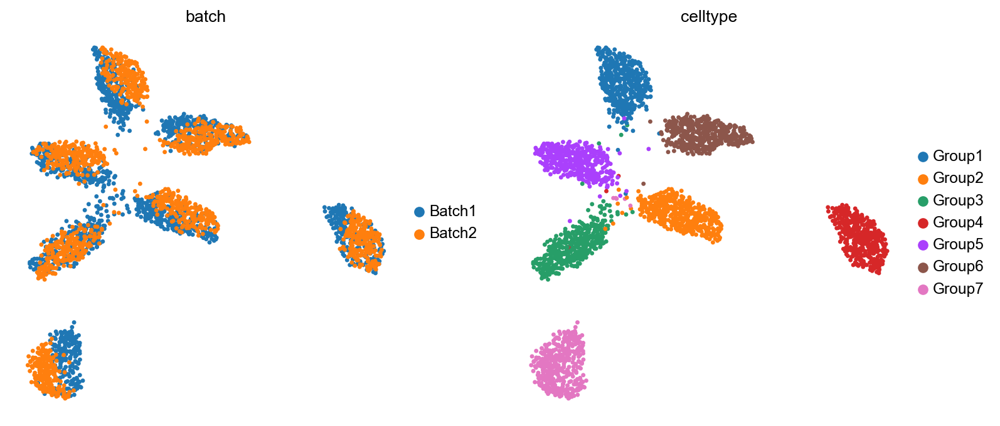

15


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.375762
cASW                        0.615479
F1 ASW                      0.466634
bLISI                       0.426706
1-cLISI                     0.987482
F1 LISI                     0.595910
kBET Accept Rate            0.242967
graph connectivity          0.998747
ARI                         0.971115
NMI                         0.959880
CC score                         NaN
HVG score                   0.687000
knn sim                     0.090673
cell-cell sim preservation  0.690218
exp sim                     0.912512
pos rate                    0.989500
true pos rate               0.408209
DEG precision               0.325556
DEG recall                  0.065891
DEG F1                      0.109363
Avg score (batch)           0.490478
Avg score (bio)             0.701322
Weighted score              0.616985




baseline 100




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 3623
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 181150.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.5886, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0024, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-13.7046, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.4056, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

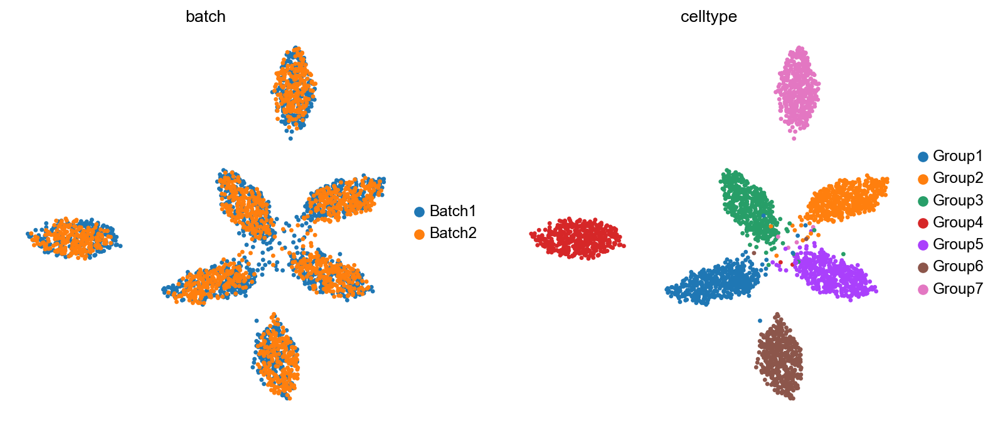

15


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.389611
cASW                        0.610800
F1 ASW                      0.475753
bLISI                       0.541308
1-cLISI                     0.986687
F1 LISI                     0.699089
kBET Accept Rate            0.206548
graph connectivity          0.996217
ARI                         0.967687
NMI                         0.954226
CC score                         NaN
HVG score                   0.678000
knn sim                     0.089639
cell-cell sim preservation  0.679516
exp sim                     0.886553
pos rate                    0.987591
true pos rate               0.782055
DEG precision               0.430539
DEG recall                  0.064377
DEG F1                      0.111735
Avg score (batch)           0.583148
Avg score (bio)             0.695243
Weighted score              0.650405




baseline 200




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 3623
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 181150.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.5886, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0024, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-13.7046, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.4056, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-13.9525, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(3.1279, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-14.3519, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.6101, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

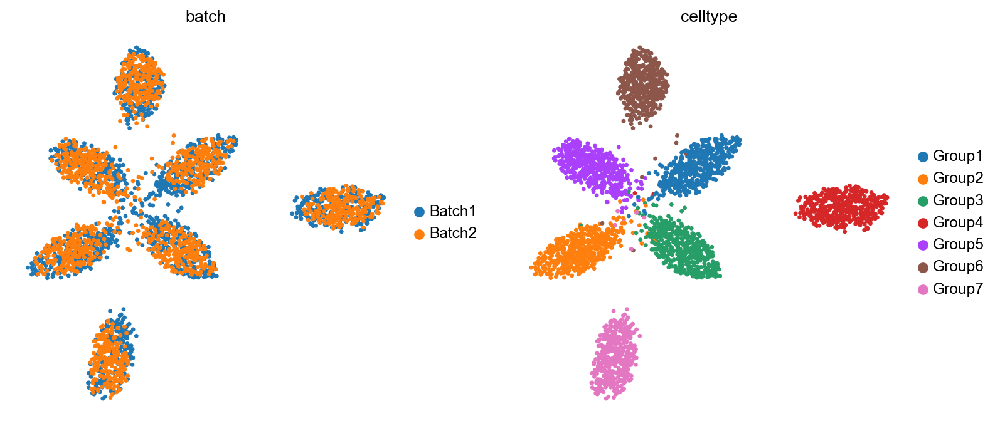

15


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.391482
cASW                        0.607143
F1 ASW                      0.476025
bLISI                       0.598176
1-cLISI                     0.982713
F1 LISI                     0.743677
kBET Accept Rate            0.287482
graph connectivity          0.998442
ARI                         0.954860
NMI                         0.940557
CC score                         NaN
HVG score                   0.660000
knn sim                     0.080620
cell-cell sim preservation  0.679356
exp sim                     0.851811
pos rate                    0.984092
true pos rate               0.822144
DEG precision               0.462567
DEG recall                  0.063380
DEG F1                      0.111326
Avg score (batch)           0.619545
Avg score (bio)             0.685248
Weighted score              0.658967




baseline 300




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 3623
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 181150.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.5886, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0024, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-13.7046, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.4056, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-13.9525, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(3.1279, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-14.3519, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.6101, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  200
d step loss:  tensor(-13.0659, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tenso

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

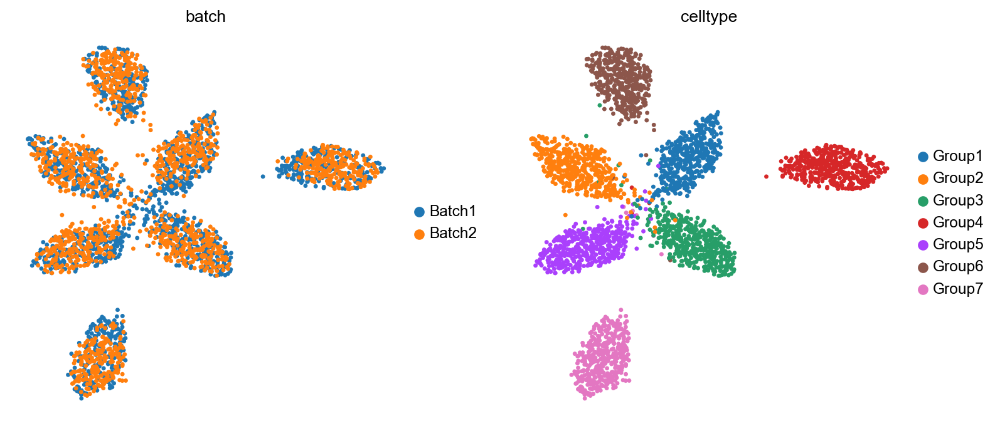

15


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.394219
cASW                        0.602666
F1 ASW                      0.476650
bLISI                       0.736061
1-cLISI                     0.978218
F1 LISI                     0.840036
kBET Accept Rate            0.513690
graph connectivity          0.996510
ARI                         0.938897
NMI                         0.920224
CC score                         NaN
HVG score                   0.653000
knn sim                     0.077195
cell-cell sim preservation  0.680839
exp sim                     0.829684
pos rate                    0.980910
true pos rate               0.855552
DEG precision               0.512663
DEG recall                  0.062509
DEG F1                      0.111201
Avg score (batch)           0.699206
Avg score (bio)             0.677283
Weighted score              0.686053




rare1_0.5 50




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 3601
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 180050.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6192, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0006, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

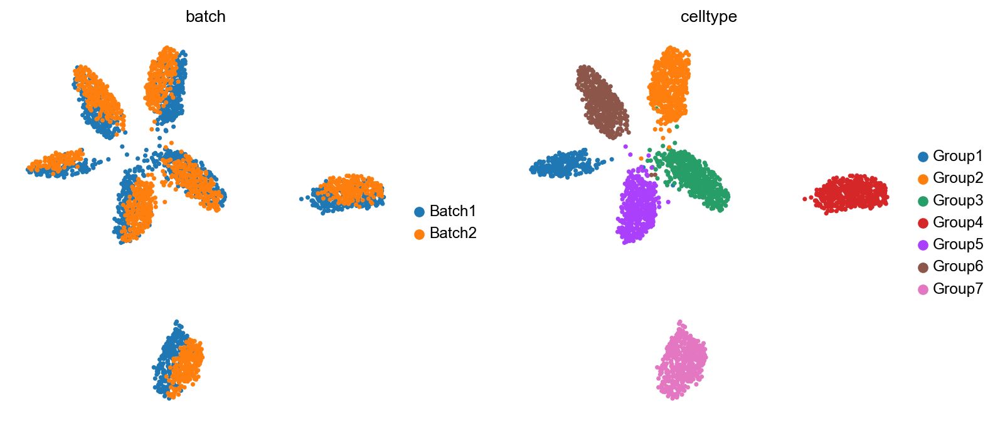

14


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.373606
cASW                        0.617168
F1 ASW                      0.465450
bLISI                       0.409759
1-cLISI                     0.988263
F1 LISI                     0.579318
kBET Accept Rate            0.262228
graph connectivity          0.998428
ARI                         0.968217
NMI                         0.957027
CC score                         NaN
HVG score                   0.692000
knn sim                     0.095960
cell-cell sim preservation  0.692493
exp sim                     0.916442
pos rate                    0.990741
true pos rate               0.420782
DEG precision               0.346512
DEG recall                  0.065440
DEG F1                      0.109296
Avg score (batch)           0.492961
Avg score (bio)             0.702761
Weighted score              0.618841




rare1_0.5 100




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 3601
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 180050.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6192, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0006, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-13.8441, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.2600, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

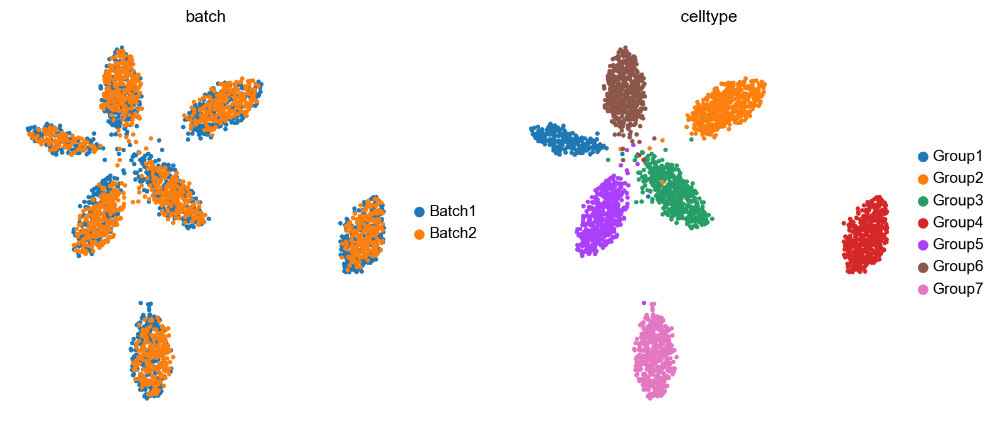

14


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.387930
cASW                        0.612987
F1 ASW                      0.475157
bLISI                       0.529655
1-cLISI                     0.987914
F1 LISI                     0.689595
kBET Accept Rate            0.236068
graph connectivity          0.998764
ARI                         0.972501
NMI                         0.962963
CC score                         NaN
HVG score                   0.692000
knn sim                     0.089282
cell-cell sim preservation  0.682654
exp sim                     0.889794
pos rate                    0.990741
true pos rate               0.733539
DEG precision               0.454234
DEG recall                  0.061999
DEG F1                      0.108632
Avg score (batch)           0.577192
Avg score (bio)             0.698947
Weighted score              0.650245




rare1_0.5 200




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 3601
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 180050.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6192, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0006, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-13.8441, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.2600, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-13.8479, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(3.1110, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-14.2504, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(1.1802, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

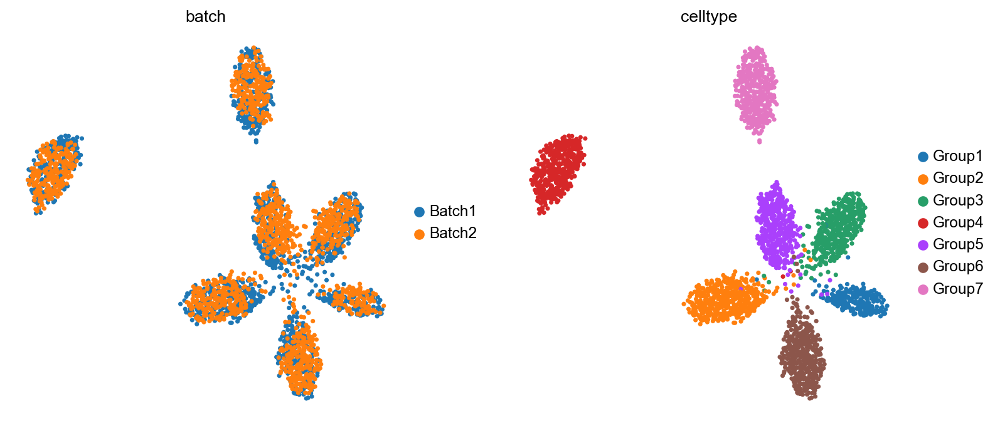

14


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.390159
cASW                        0.608833
F1 ASW                      0.475562
bLISI                       0.582509
1-cLISI                     0.983460
F1 LISI                     0.731655
kBET Accept Rate            0.290698
graph connectivity          0.997780
ARI                         0.965212
NMI                         0.952975
CC score                         NaN
HVG score                   0.669000
knn sim                     0.083384
cell-cell sim preservation  0.681381
exp sim                     0.855410
pos rate                    0.985254
true pos rate               0.803498
DEG precision               0.485231
DEG recall                  0.061763
DEG F1                      0.109053
Avg score (batch)           0.612929
Avg score (bio)             0.689396
Weighted score              0.658809




rare1_0.5 300




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 3601
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 180050.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6192, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0006, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-13.8441, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.2600, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-13.8479, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(3.1110, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-14.2504, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(1.1802, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  200
d step loss:  tensor(-12.9977, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tenso

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

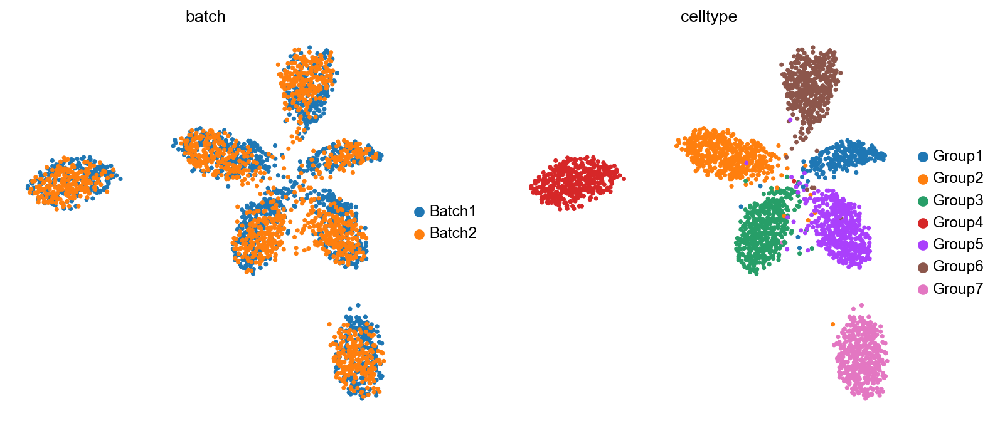

14


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.394099
cASW                        0.606412
F1 ASW                      0.477729
bLISI                       0.725845
1-cLISI                     0.978728
F1 LISI                     0.833528
kBET Accept Rate            0.485365
graph connectivity          0.996231
ARI                         0.946116
NMI                         0.933289
CC score                         NaN
HVG score                   0.661000
knn sim                     0.078046
cell-cell sim preservation  0.682349
exp sim                     0.831814
pos rate                    0.981481
true pos rate               0.858025
DEG precision               0.521775
DEG recall                  0.060752
DEG F1                      0.108339
Avg score (batch)           0.691913
Avg score (bio)             0.680757
Weighted score              0.685220




rare1_0.2 50




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 3373
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 168650.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6939, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0090, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

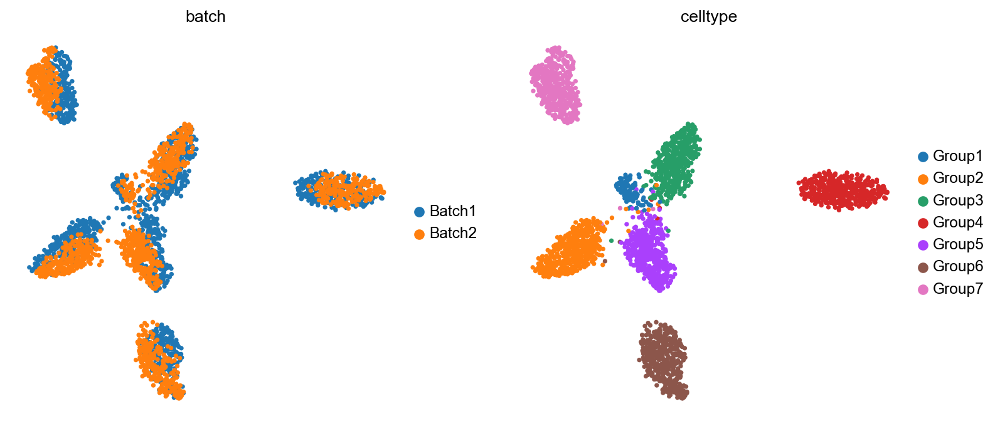

13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.374985
cASW                        0.602003
F1 ASW                      0.462119
bLISI                       0.417328
1-cLISI                     0.984284
F1 LISI                     0.586138
kBET Accept Rate            0.253016
graph connectivity          0.999061
ARI                         0.973066
NMI                         0.957220
CC score                         NaN
HVG score                   0.692000
knn sim                     0.088496
cell-cell sim preservation  0.691882
exp sim                     0.911881
pos rate                    0.985606
true pos rate               0.397625
DEG precision               0.356725
DEG recall                  0.062818
DEG F1                      0.102809
Avg score (batch)           0.488403
Avg score (bio)             0.698925
Weighted score              0.614716




rare1_0.2 100




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 3373
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 168650.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6939, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0090, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-13.9511, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.0182, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

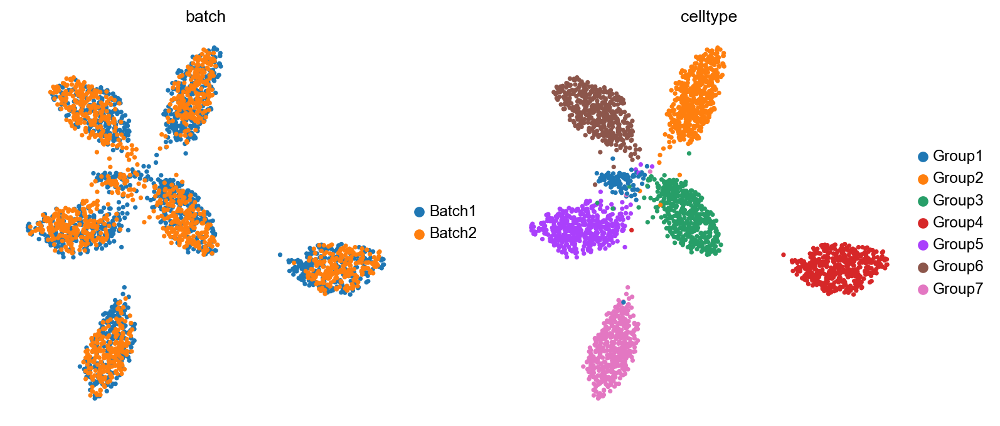

13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.389151
cASW                        0.594915
F1 ASW                      0.470521
bLISI                       0.538427
1-cLISI                     0.981560
F1 LISI                     0.695398
kBET Accept Rate            0.250029
graph connectivity          0.997785
ARI                         0.963746
NMI                         0.945518
CC score                         NaN
HVG score                   0.698000
knn sim                     0.083394
cell-cell sim preservation  0.682763
exp sim                     0.883568
pos rate                    0.984887
true pos rate               0.695934
DEG precision               0.438748
DEG recall                  0.061441
DEG F1                      0.105783
Avg score (batch)           0.574265
Avg score (bio)             0.692413
Weighted score              0.645154




rare1_0.2 200




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 3373
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 168650.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6939, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0090, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-13.9511, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.0182, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-14.0439, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(2.9859, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-14.2863, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(1.0722, device='cuda:0', grad_fn=<Ne

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

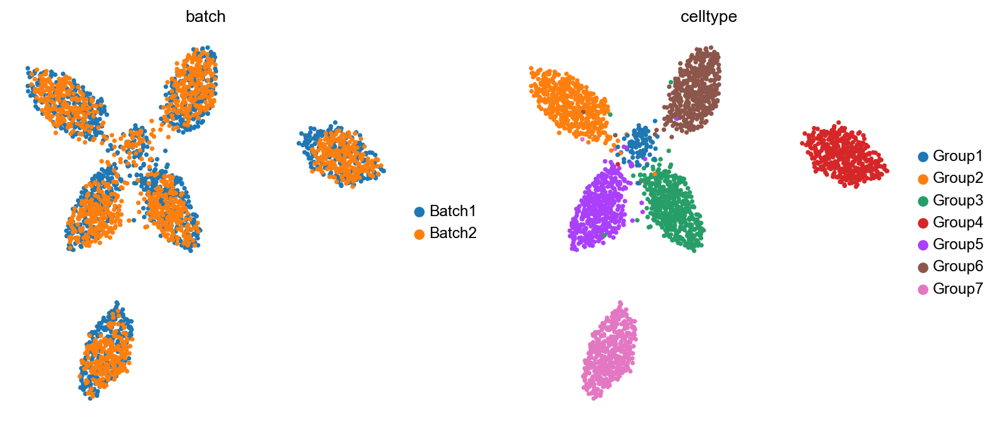

13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.389775
cASW                        0.591086
F1 ASW                      0.469772
bLISI                       0.562870
1-cLISI                     0.978408
F1 LISI                     0.714624
kBET Accept Rate            0.273396
graph connectivity          0.998094
ARI                         0.955606
NMI                         0.934769
CC score                         NaN
HVG score                   0.664000
knn sim                     0.076253
cell-cell sim preservation  0.681464
exp sim                     0.846275
pos rate                    0.981288
true pos rate               0.780137
DEG precision               0.516330
DEG recall                  0.058377
DEG F1                      0.102867
Avg score (batch)           0.600854
Avg score (bio)             0.681202
Weighted score              0.649063




rare1_0.2 300




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 3373
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 168650.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6939, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0090, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-13.9511, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.0182, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-14.0439, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(2.9859, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-14.2863, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(1.0722, device='cuda:0', grad_fn=<Ne

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

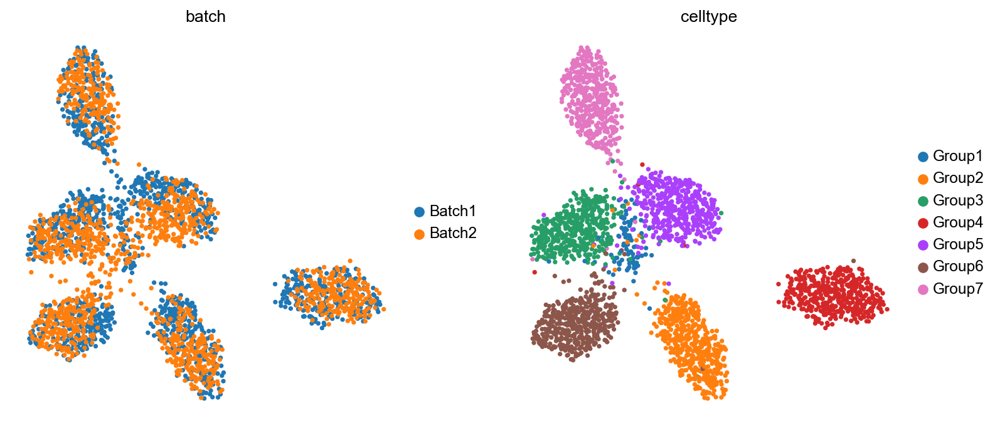

13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.393365
cASW                        0.570668
F1 ASW                      0.465712
bLISI                       0.711803
1-cLISI                     0.969191
F1 LISI                     0.820792
kBET Accept Rate            0.468152
graph connectivity          0.982964
ARI                         0.915315
NMI                         0.886335
CC score                         NaN
HVG score                   0.656000
knn sim                     0.069299
cell-cell sim preservation  0.682779
exp sim                     0.821936
pos rate                    0.967614
true pos rate               0.828356
DEG precision               0.556799
DEG recall                  0.058159
DEG F1                      0.103096
Avg score (batch)           0.676928
Avg score (bio)             0.664223
Weighted score              0.669305




rare1_0.1 50




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 3440
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 172000.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6037, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0049, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

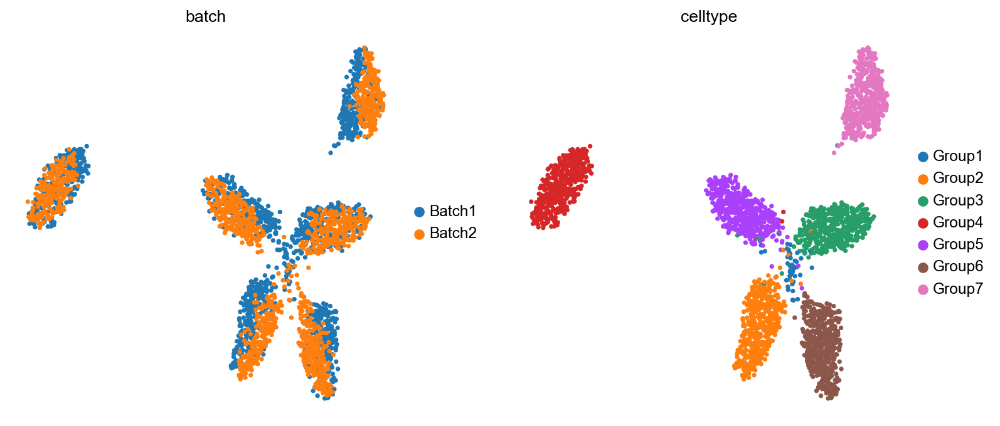

13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.375130
cASW                        0.600807
F1 ASW                      0.461876
bLISI                       0.413733
1-cLISI                     0.983035
F1 LISI                     0.582365
kBET Accept Rate            0.257127
graph connectivity          0.990066
ARI                         0.960281
NMI                         0.939783
CC score                         NaN
HVG score                   0.705000
knn sim                     0.082636
cell-cell sim preservation  0.691876
exp sim                     0.912806
pos rate                    0.980614
true pos rate               0.376737
DEG precision               0.386999
DEG recall                  0.059442
DEG F1                      0.098558
Avg score (batch)           0.482559
Avg score (bio)             0.695540
Weighted score              0.610347




rare1_0.1 100




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 3440
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 172000.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6037, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0049, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-13.9800, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(8.8948, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

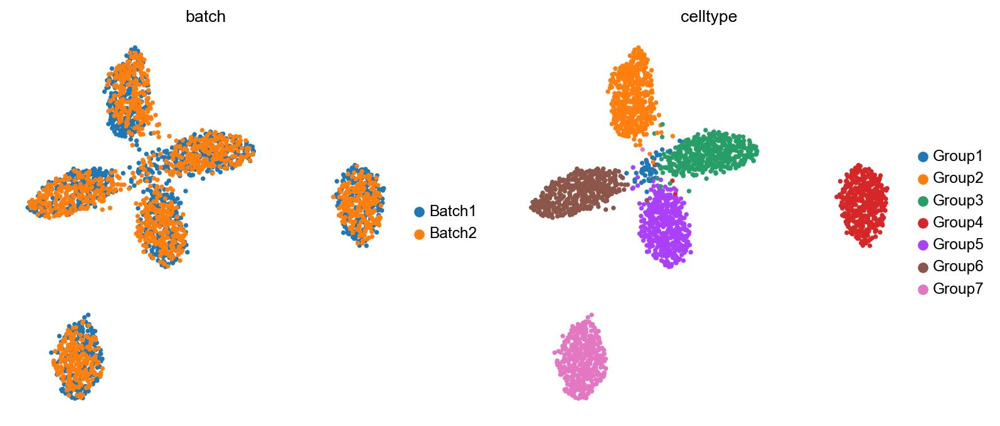

13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.389674
cASW                        0.587995
F1 ASW                      0.468720
bLISI                       0.526869
1-cLISI                     0.982003
F1 LISI                     0.685793
kBET Accept Rate            0.218481
graph connectivity          0.992507
ARI                         0.963842
NMI                         0.946134
CC score                         NaN
HVG score                   0.703000
knn sim                     0.076686
cell-cell sim preservation  0.681623
exp sim                     0.884947
pos rate                    0.977688
true pos rate               0.729700
DEG precision               0.488632
DEG recall                  0.058121
DEG F1                      0.100697
Avg score (batch)           0.571446
Avg score (bio)             0.690461
Weighted score              0.642855




rare1_0.1 200




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 3440
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 172000.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6037, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0049, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-13.9800, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(8.8948, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-14.1823, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(4.3885, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-14.3805, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(1.5952, device='cuda:0', grad_fn=<Ne

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

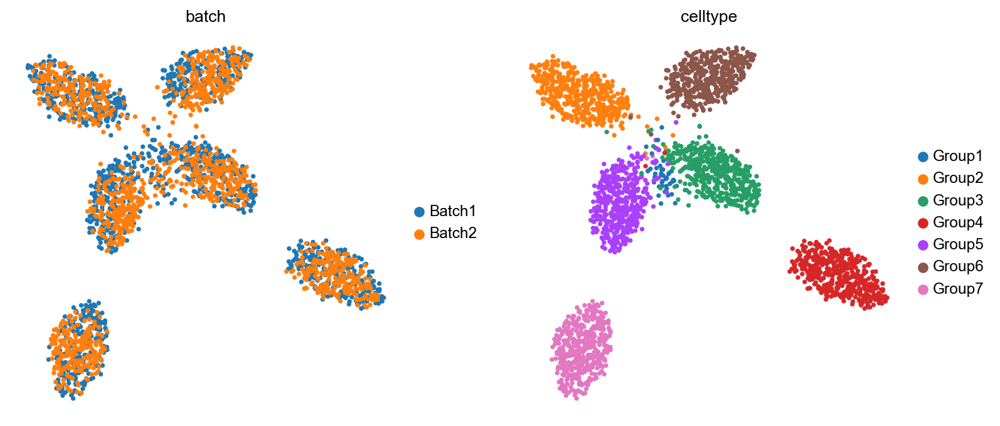

13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.390772
cASW                        0.587620
F1 ASW                      0.469394
bLISI                       0.559793
1-cLISI                     0.977943
F1 LISI                     0.712015
kBET Accept Rate            0.259309
graph connectivity          0.986656
ARI                         0.951655
NMI                         0.930167
CC score                         NaN
HVG score                   0.680000
knn sim                     0.069187
cell-cell sim preservation  0.680266
exp sim                     0.848768
pos rate                    0.974762
true pos rate               0.850402
DEG precision               0.526983
DEG recall                  0.057669
DEG F1                      0.101287
Avg score (batch)           0.609386
Avg score (bio)             0.680166
Weighted score              0.651854




rare1_0.1 300




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 3440
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 172000.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6037, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0049, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-13.9800, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(8.8948, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-14.1823, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(4.3885, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-14.3805, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(1.5952, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  200
d step loss:  tensor(-13.4839, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tens

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

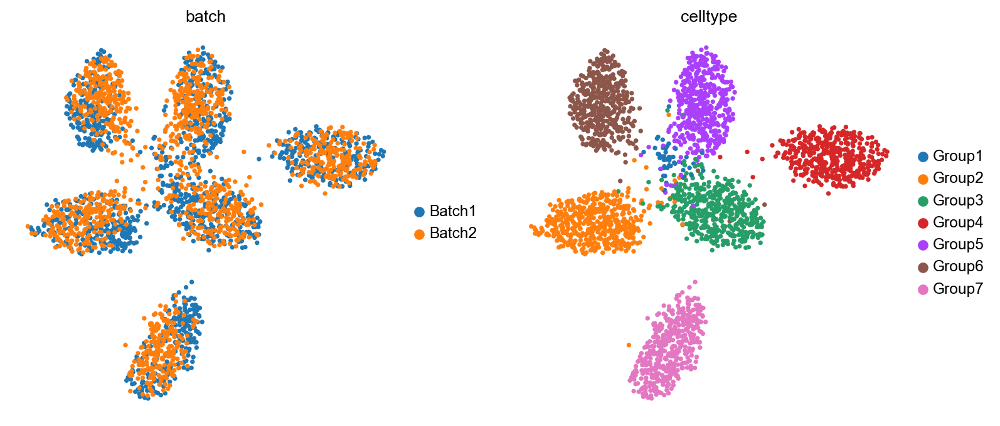

13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.393558
cASW                        0.575804
F1 ASW                      0.467549
bLISI                       0.676515
1-cLISI                     0.972516
F1 LISI                     0.797950
kBET Accept Rate            0.401394
graph connectivity          0.990066
ARI                         0.941847
NMI                         0.919409
CC score                         NaN
HVG score                   0.661000
knn sim                     0.066021
cell-cell sim preservation  0.682191
exp sim                     0.822958
pos rate                    0.971105
true pos rate               0.847476
DEG precision               0.576946
DEG recall                  0.055717
DEG F1                      0.098836
Avg score (batch)           0.661802
Avg score (bio)             0.671169
Weighted score              0.667422




common_5 50




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 2913
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 145650.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6768, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0018, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

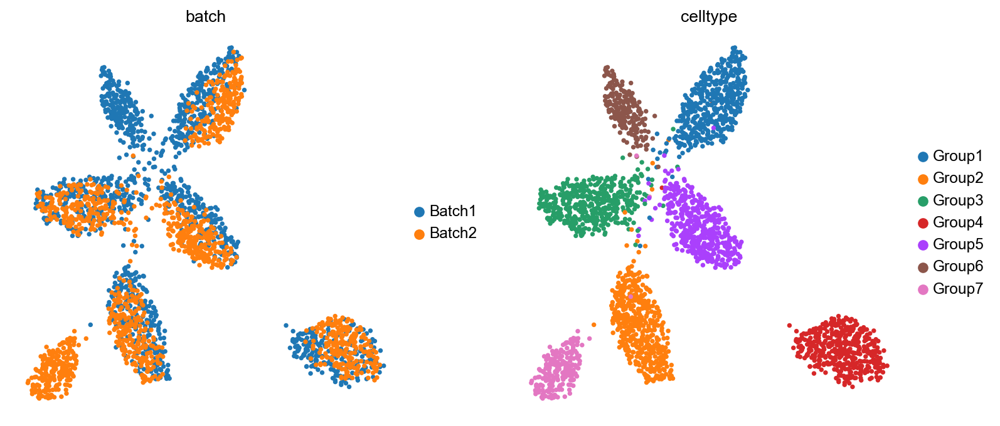

Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.377673
cASW                        0.604329
F1 ASW                      0.464843
bLISI                       0.415336
1-cLISI                     0.981904
F1 LISI                     0.583751
kBET Accept Rate            0.229760
graph connectivity          0.995806
ARI                         0.944858
NMI                         0.930877
CC score                         NaN
HVG score                   0.707000
knn sim                     0.083053
cell-cell sim preservation  0.694951
exp sim                     0.490258
pos rate                    0.981433
true pos rate               0.486075
DEG precision               0.281898
DEG recall                  0.072016
DEG F1                      0.112071
Avg score (batch)           0.500930
Avg score (bio)             0.653073
Weighted score              0.592216




common_5 100




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 2913
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 145650.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6768, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0018, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-15.1431, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.7343, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

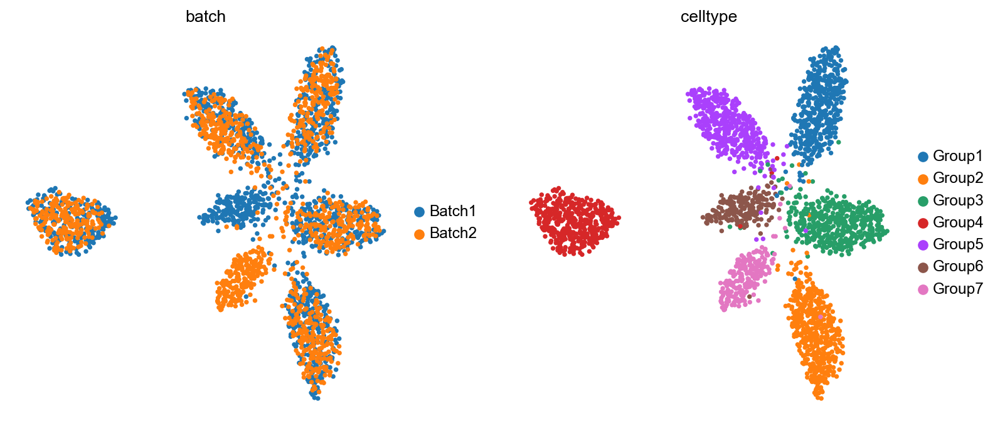

Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.387891
cASW                        0.577798
F1 ASW                      0.464171
bLISI                       0.469637
1-cLISI                     0.973819
F1 LISI                     0.633675
kBET Accept Rate            0.157226
graph connectivity          0.995404
ARI                         0.939806
NMI                         0.915404
CC score                         NaN
HVG score                   0.706000
knn sim                     0.078972
cell-cell sim preservation  0.684797
exp sim                     0.487092
pos rate                    0.975121
true pos rate               0.714074
DEG precision               0.364950
DEG recall                  0.067901
DEG F1                      0.110901
Avg score (batch)           0.544846
Avg score (bio)             0.644971
Weighted score              0.604921




common_5 200




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 2913
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 145650.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6768, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0018, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-15.1431, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.7343, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-14.6989, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(4.2108, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-15.2293, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(2.1874, device='cuda:0', grad_fn=<Neg

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

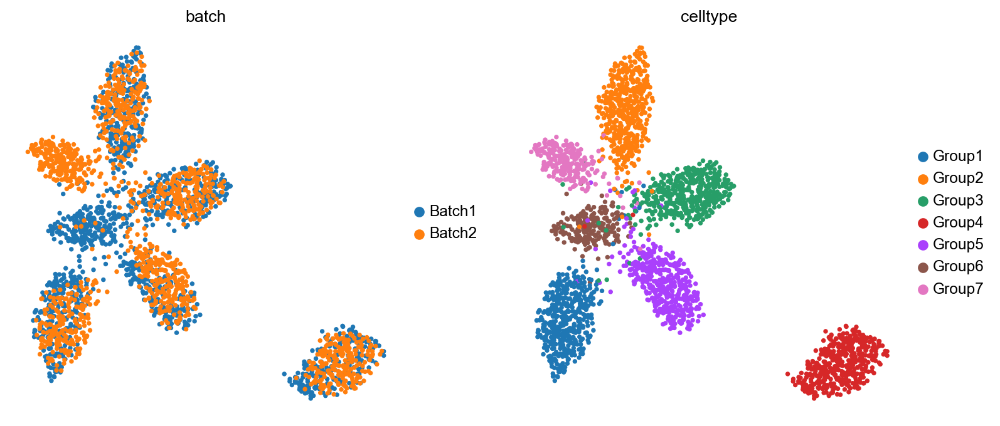

Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.389703
cASW                        0.568533
F1 ASW                      0.462431
bLISI                       0.500987
1-cLISI                     0.965759
F1 LISI                     0.659736
kBET Accept Rate            0.220951
graph connectivity          0.993234
ARI                         0.925839
NMI                         0.902343
CC score                         NaN
HVG score                   0.667000
knn sim                     0.069156
cell-cell sim preservation  0.682976
exp sim                     0.486367
pos rate                    0.965466
true pos rate               0.800594
DEG precision               0.401125
DEG recall                  0.064136
DEG F1                      0.106341
Avg score (batch)           0.581094
Avg score (bio)             0.633978
Weighted score              0.612824




common_5 300




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 2913
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 145650.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6768, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0018, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-15.1431, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.7343, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-14.6989, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(4.2108, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-15.2293, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(2.1874, device='cuda:0', grad_fn=<Neg

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

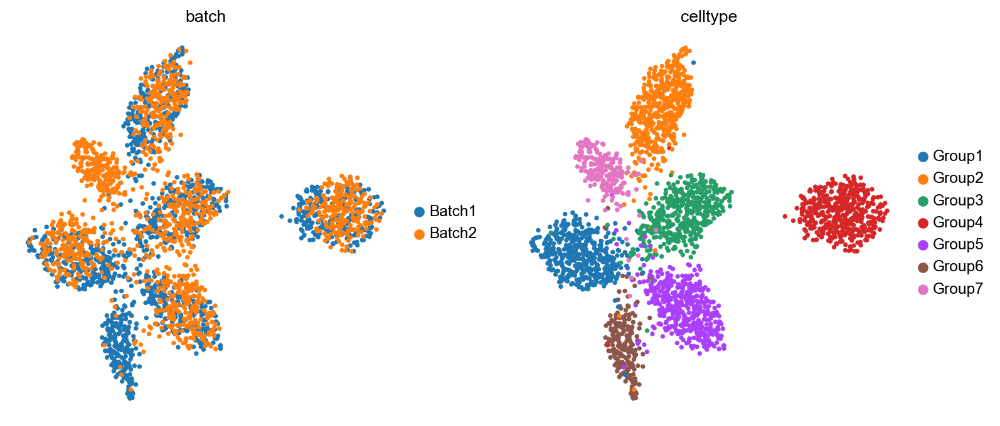

Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
13


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.393955
cASW                        0.570653
F1 ASW                      0.466120
bLISI                       0.662122
1-cLISI                     0.960869
F1 LISI                     0.784000
kBET Accept Rate            0.405829
graph connectivity          0.992316
ARI                         0.912218
NMI                         0.881852
CC score                         NaN
HVG score                   0.656000
knn sim                     0.065597
cell-cell sim preservation  0.683814
exp sim                     0.481676
pos rate                    0.960267
true pos rate               0.822503
DEG precision               0.433117
DEG recall                  0.063151
DEG F1                      0.106648
Avg score (batch)           0.655345
Avg score (bio)             0.627960
Weighted score              0.638914




common_3 50




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 2484
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 124200.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6855, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0078, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

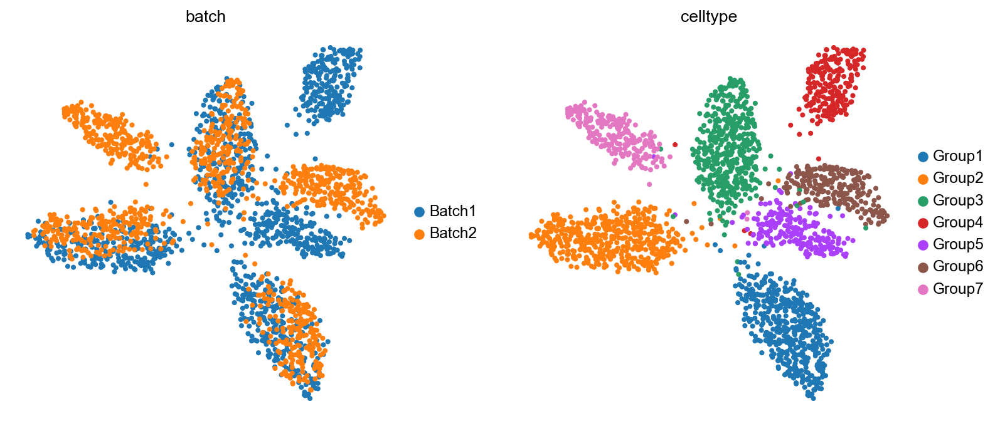

Cell cluster Group4 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group5 contains only one batch or has less than 10 cells. Skip.
11


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.380238
cASW                        0.556922
F1 ASW                      0.451925
bLISI                       0.422016
1-cLISI                     0.965330
F1 LISI                     0.587286
kBET Accept Rate            0.218377
graph connectivity          0.995044
ARI                         0.928690
NMI                         0.906135
CC score                         NaN
HVG score                   0.705000
knn sim                     0.071543
cell-cell sim preservation  0.692937
exp sim                     0.507207
pos rate                    0.975728
true pos rate               0.661959
DEG precision               0.227271
DEG recall                  0.067106
DEG F1                      0.101864
Avg score (batch)           0.535527
Avg score (bio)             0.641136
Weighted score              0.598892




common_3 100




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 2484
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 124200.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6855, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0078, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-16.0515, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.2983, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

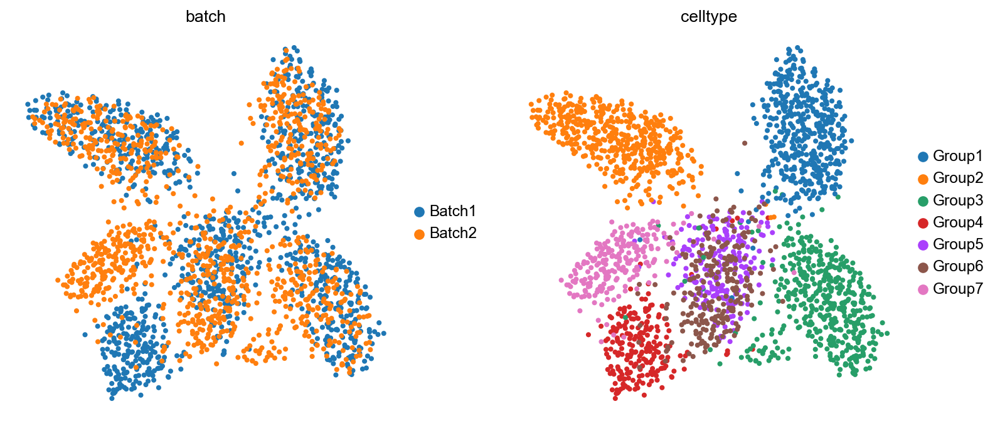

Cell cluster Group4 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group5 contains only one batch or has less than 10 cells. Skip.
11


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.385379
cASW                        0.534133
F1 ASW                      0.447723
bLISI                       0.431580
1-cLISI                     0.931752
F1 LISI                     0.589916
kBET Accept Rate            0.118488
graph connectivity          0.979653
ARI                         0.815799
NMI                         0.797384
CC score                         NaN
HVG score                   0.689000
knn sim                     0.065489
cell-cell sim preservation  0.682503
exp sim                     0.503290
pos rate                    0.897176
true pos rate               0.675199
DEG precision               0.258338
DEG recall                  0.064362
DEG F1                      0.100324
Avg score (batch)           0.518060
Avg score (bio)             0.601685
Weighted score              0.568235




common_3 200




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 2484
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 124200.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6855, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0078, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-16.0515, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.2983, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-15.9024, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(3.3819, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-16.4113, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(1.5061, device='cuda:0', grad_fn=<Ne

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

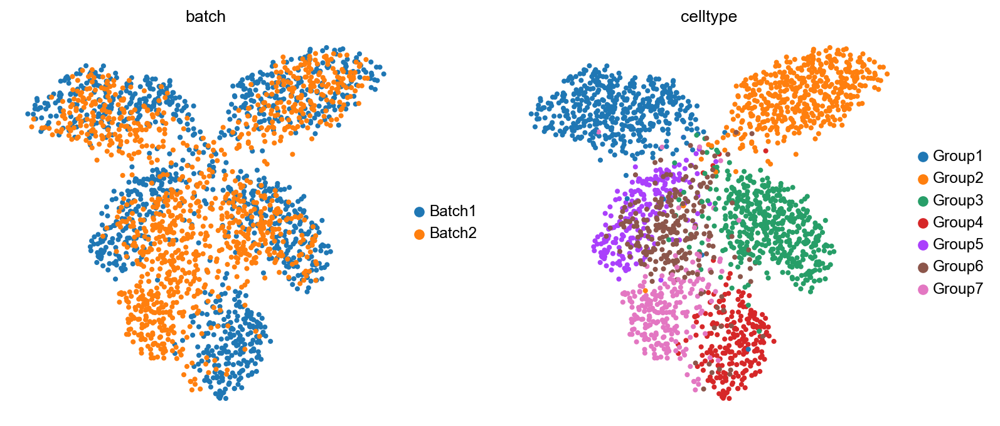

Cell cluster Group4 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group5 contains only one batch or has less than 10 cells. Skip.
11


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.387062
cASW                        0.537508
F1 ASW                      0.450044
bLISI                       0.459093
1-cLISI                     0.907569
F1 LISI                     0.609746
kBET Accept Rate            0.157457
graph connectivity          0.974398
ARI                         0.767606
NMI                         0.749382
CC score                         NaN
HVG score                   0.658000
knn sim                     0.057093
cell-cell sim preservation  0.679316
exp sim                     0.504185
pos rate                    0.850397
true pos rate               0.777582
DEG precision               0.284142
DEG recall                  0.065221
DEG F1                      0.102056
Avg score (batch)           0.551118
Avg score (bio)             0.581311
Weighted score              0.569234




common_3 300




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 2484
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 124200.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6855, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0078, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-16.0515, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.2983, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-15.9024, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(3.3819, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-16.4113, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(1.5061, device='cuda:0', grad_fn=<Ne

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

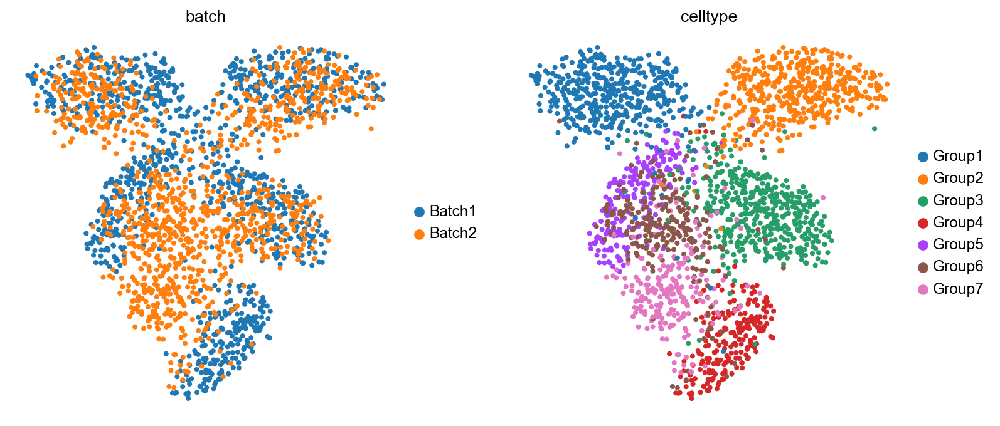

Cell cluster Group4 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group5 contains only one batch or has less than 10 cells. Skip.
11


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.393906
cASW                        0.544601
F1 ASW                      0.457155
bLISI                       0.678897
1-cLISI                     0.886851
F1 LISI                     0.769064
kBET Accept Rate            0.400310
graph connectivity          0.968824
ARI                         0.701628
NMI                         0.693957
CC score                         NaN
HVG score                   0.643000
knn sim                     0.055460
cell-cell sim preservation  0.679358
exp sim                     0.498379
pos rate                    0.823477
true pos rate               0.739188
DEG precision               0.294852
DEG recall                  0.061167
DEG F1                      0.097041
Avg score (batch)           0.636225
Avg score (bio)             0.562375
Weighted score              0.591915




common_1 50




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 1913
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 95650.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.7105, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0017, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

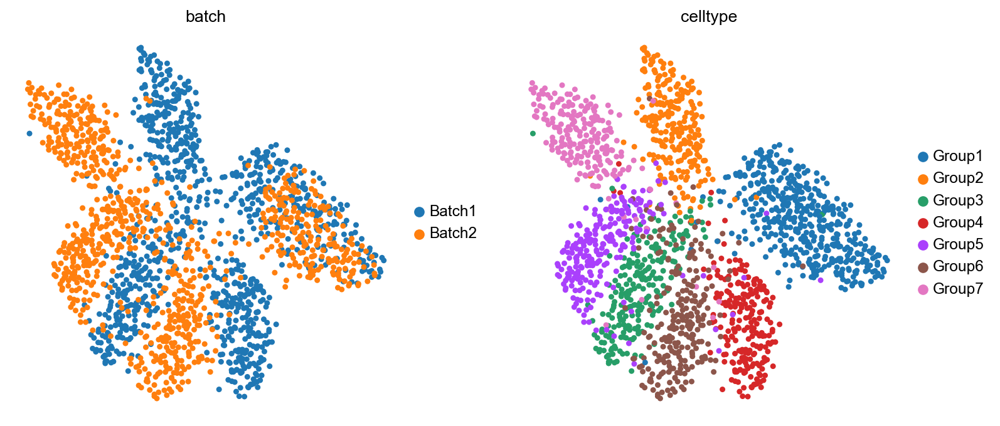

Cell cluster Group4 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group2 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group3 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group5 contains only one batch or has less than 10 cells. Skip.
8


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.376467
cASW                        0.525661
F1 ASW                      0.438727
bLISI                       0.448810
1-cLISI                     0.900241
F1 LISI                     0.598994
kBET Accept Rate            0.231087
graph connectivity          0.987942
ARI                         0.731307
NMI                         0.708048
CC score                         NaN
HVG score                   0.703960
knn sim                     0.051460
cell-cell sim preservation  0.696242
exp sim                     0.463944
pos rate                    0.909387
true pos rate               0.776994
DEG precision               0.167567
DEG recall                  0.064405
DEG F1                      0.090712
Avg score (batch)           0.564260
Avg score (bio)             0.578096
Weighted score              0.572562




common_1 100




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 1913
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 95650.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.7105, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0017, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-17.5707, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.6032, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

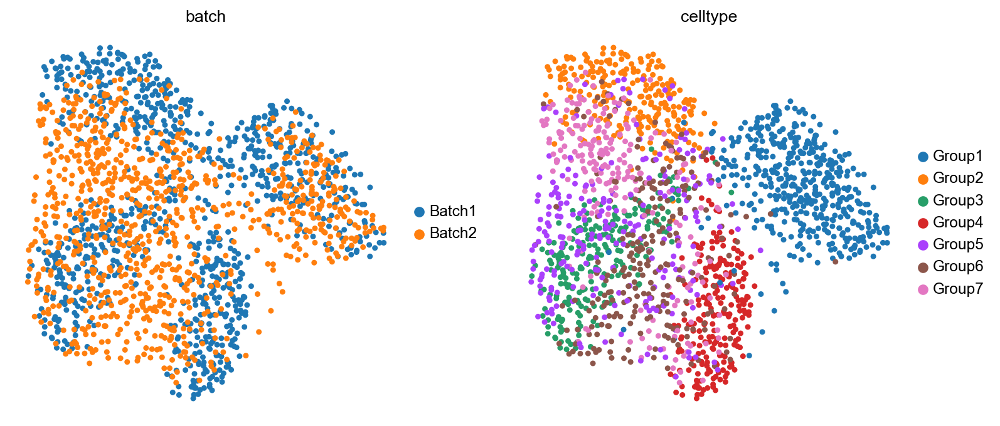

Cell cluster Group4 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group2 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group3 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group5 contains only one batch or has less than 10 cells. Skip.
8


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.379671
cASW                        0.506008
F1 ASW                      0.433829
bLISI                       0.460585
1-cLISI                     0.821680
F1 LISI                     0.590289
kBET Accept Rate            0.227391
graph connectivity          0.957363
ARI                         0.466353
NMI                         0.520163
CC score                         NaN
HVG score                   0.681188
knn sim                     0.046801
cell-cell sim preservation  0.686882
exp sim                     0.460346
pos rate                    0.667390
true pos rate               0.561584
DEG precision               0.171991
DEG recall                  0.061802
DEG F1                      0.088333
Avg score (batch)           0.517319
Avg score (bio)             0.494514
Weighted score              0.503636




common_1 200




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 1913
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 95650.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.7105, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0017, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-17.5707, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.6032, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-16.6452, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(4.2023, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-16.9495, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(2.1099, device='cuda:0', grad_fn=<Neg

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

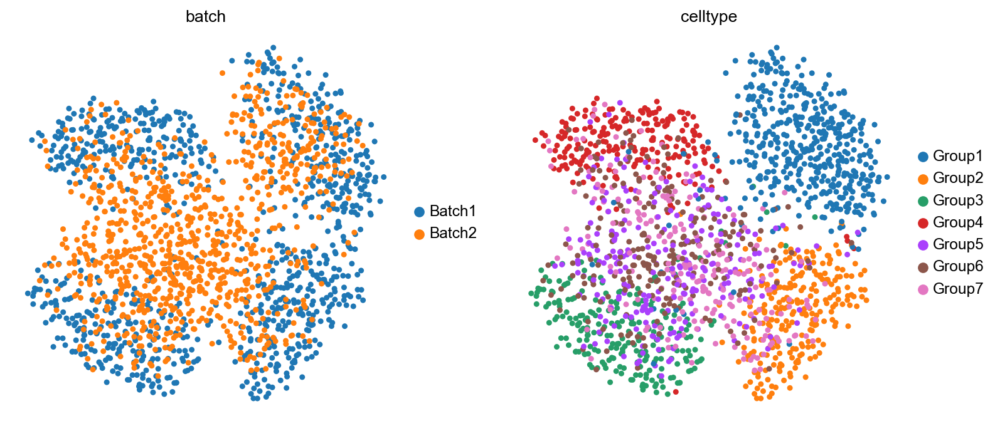

Cell cluster Group4 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group2 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group3 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group5 contains only one batch or has less than 10 cells. Skip.
8


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.380135
cASW                        0.499641
F1 ASW                      0.431772
bLISI                       0.471684
1-cLISI                     0.773942
F1 LISI                     0.586141
kBET Accept Rate            0.224565
graph connectivity          0.933938
ARI                         0.447123
NMI                         0.493994
CC score                         NaN
HVG score                   0.655446
knn sim                     0.040936
cell-cell sim preservation  0.685202
exp sim                     0.458826
pos rate                    0.558871
true pos rate               0.515464
DEG precision               0.185061
DEG recall                  0.059960
DEG F1                      0.087744
Avg score (batch)           0.505157
Avg score (bio)             0.470172
Weighted score              0.484166




common_1 300




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 1913
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 95650.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.7105, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0017, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-17.5707, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.6032, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-16.6452, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(4.2023, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-16.9495, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(2.1099, device='cuda:0', grad_fn=<Neg

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

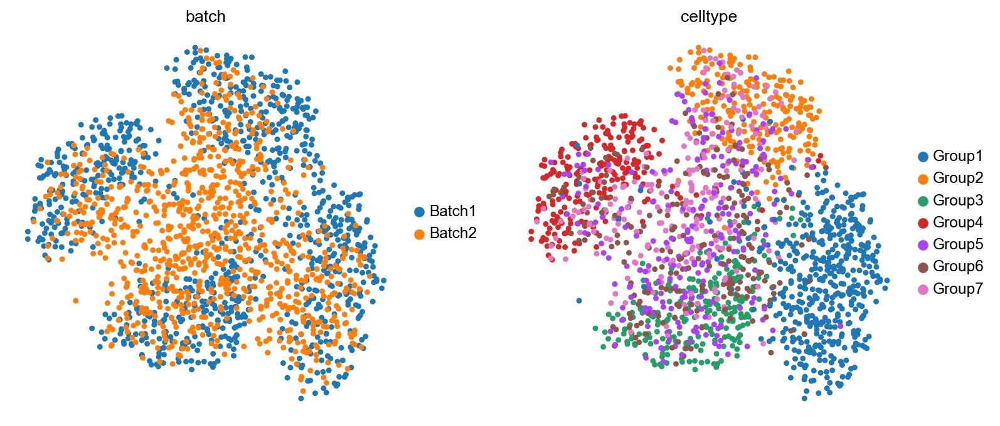

Cell cluster Group4 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group6 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group7 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group2 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group3 contains only one batch or has less than 10 cells. Skip.
Cell cluster Group5 contains only one batch or has less than 10 cells. Skip.
8


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.385276
cASW                        0.505019
F1 ASW                      0.437095
bLISI                       0.559436
1-cLISI                     0.738316
F1 LISI                     0.636548
kBET Accept Rate            0.286522
graph connectivity          0.902173
ARI                         0.434964
NMI                         0.472308
CC score                         NaN
HVG score                   0.646535
knn sim                     0.039012
cell-cell sim preservation  0.679357
exp sim                     0.457564
pos rate                    0.506240
true pos rate               0.476397
DEG precision               0.206922
DEG recall                  0.055789
DEG F1                      0.084963
Avg score (batch)           0.521961
Avg score (bio)             0.456428
Weighted score              0.482641




batch1_1000 50




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 3337
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 166850.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6229, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0001, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

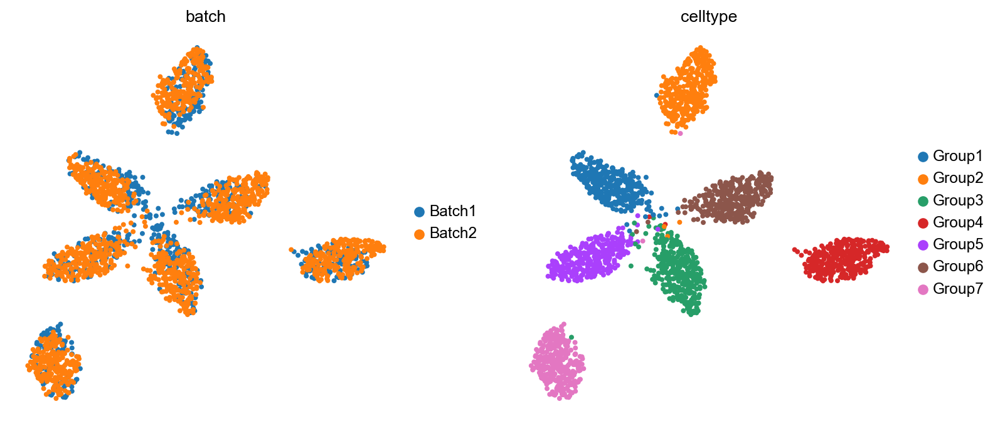

15


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.356150
cASW                        0.614572
F1 ASW                      0.450963
bLISI                       0.260888
1-cLISI                     0.984527
F1 LISI                     0.412476
kBET Accept Rate            0.227231
graph connectivity          0.998257
ARI                         0.962538
NMI                         0.950134
CC score                         NaN
HVG score                   0.694000
knn sim                     0.111720
cell-cell sim preservation  0.706871
exp sim                     0.889162
pos rate                    0.986825
true pos rate               0.446239
DEG precision               0.259684
DEG recall                  0.068054
DEG F1                      0.107597
Avg score (batch)           0.457753
Avg score (bio)             0.700795
Weighted score              0.603578




batch1_1000 100




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 3337
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 166850.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6229, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0001, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-16.3657, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.4368, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

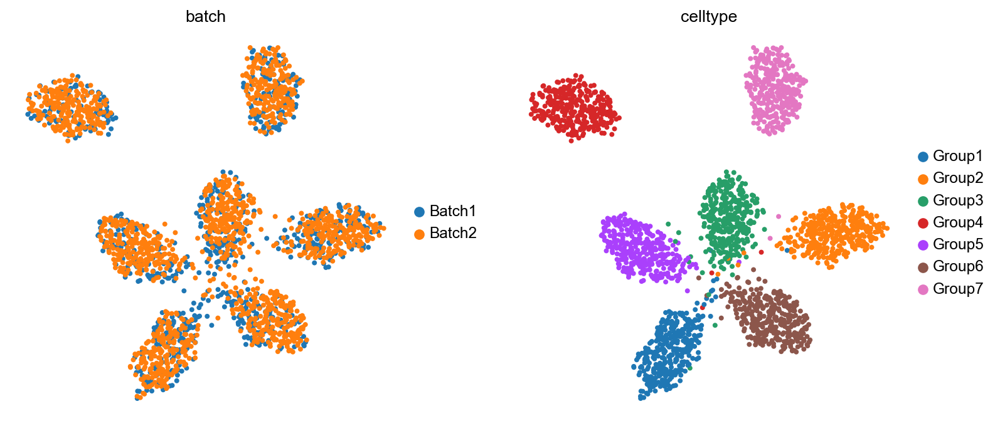

15


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.374199
cASW                        0.603137
F1 ASW                      0.461854
bLISI                       0.334841
1-cLISI                     0.979119
F1 LISI                     0.499024
kBET Accept Rate            0.310930
graph connectivity          0.997900
ARI                         0.948716
NMI                         0.934630
CC score                         NaN
HVG score                   0.693000
knn sim                     0.103880
cell-cell sim preservation  0.698468
exp sim                     0.846755
pos rate                    0.983850
true pos rate               0.883553
DEG precision               0.329467
DEG recall                  0.062246
DEG F1                      0.104325
Avg score (batch)           0.580285
Avg score (bio)             0.689588
Weighted score              0.645867




batch1_1000 200




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 3337
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 166850.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6229, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0001, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-16.3657, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.4368, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-16.1621, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(3.4996, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-16.3545, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(1.5771, device='cuda:0', grad_fn=<Neg

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

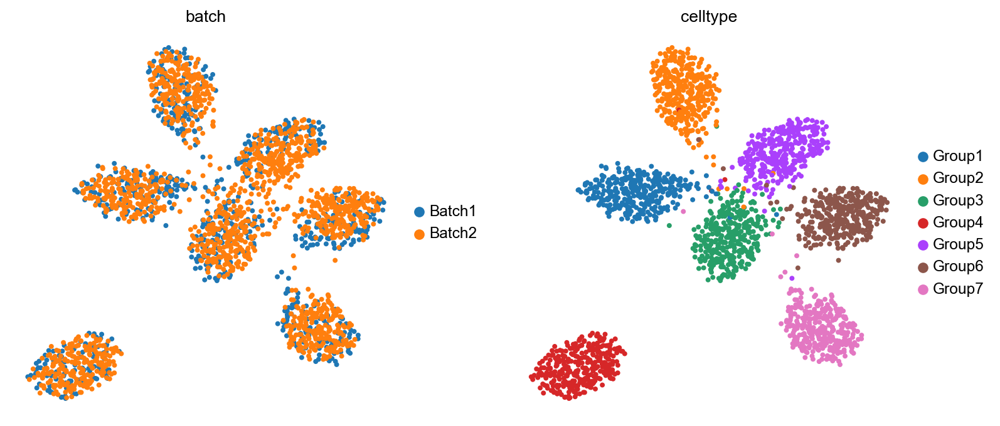

15


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.364883
cASW                        0.593752
F1 ASW                      0.451997
bLISI                       0.268381
1-cLISI                     0.970149
F1 LISI                     0.420450
kBET Accept Rate            0.227854
graph connectivity          0.997415
ARI                         0.945927
NMI                         0.930423
CC score                         NaN
HVG score                   0.665000
knn sim                     0.098419
cell-cell sim preservation  0.694274
exp sim                     0.798157
pos rate                    0.977901
true pos rate               0.931152
DEG precision               0.395827
DEG recall                  0.054630
DEG F1                      0.095853
Avg score (batch)           0.557937
Avg score (bio)             0.676985
Weighted score              0.629366




batch1_1000 300




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 3337
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 166850.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6229, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0001, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-16.3657, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.4368, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-16.1621, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(3.4996, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-16.3545, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(1.5771, device='cuda:0', grad_fn=<Neg

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

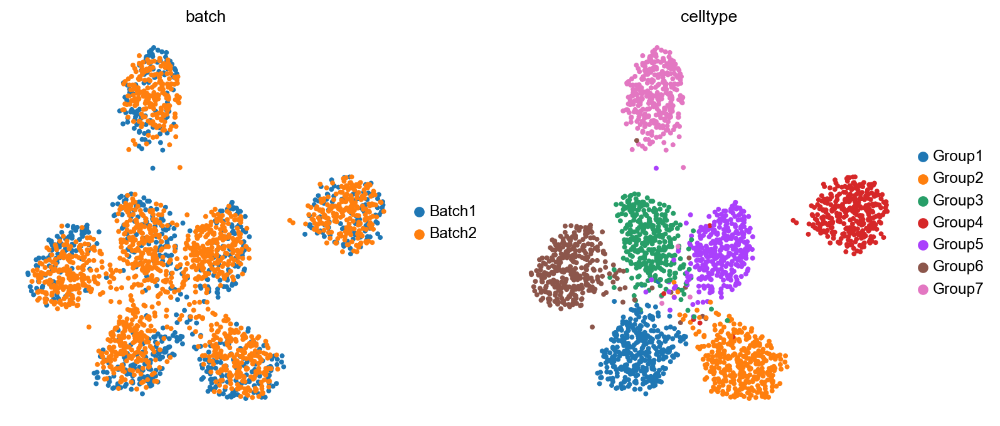

15


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.367387
cASW                        0.588176
F1 ASW                      0.452274
bLISI                       0.283957
1-cLISI                     0.958369
F1 LISI                     0.438107
kBET Accept Rate            0.269601
graph connectivity          0.995756
ARI                         0.904061
NMI                         0.884755
CC score                         NaN
HVG score                   0.660000
knn sim                     0.094448
cell-cell sim preservation  0.693825
exp sim                     0.768667
pos rate                    0.961326
true pos rate               0.903527
DEG precision               0.446980
DEG recall                  0.054702
DEG F1                      0.097324
Avg score (batch)           0.564046
Avg score (bio)             0.661095
Weighted score              0.622275




batch1_500 50




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 2553
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 127650.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6845, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0055, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

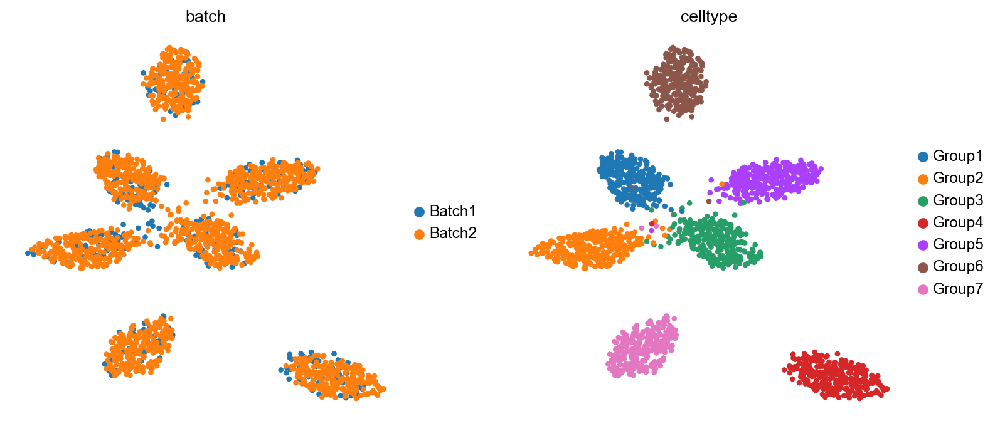

15


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.322896
cASW                        0.619113
F1 ASW                      0.424431
bLISI                       0.088239
1-cLISI                     0.983567
F1 LISI                     0.161949
kBET Accept Rate            0.222011
graph connectivity          0.998942
ARI                         0.963526
NMI                         0.951473
CC score                         NaN
HVG score                   0.701000
knn sim                     0.144447
cell-cell sim preservation  0.713820
exp sim                     0.864342
pos rate                    0.986721
true pos rate               0.624106
DEG precision               0.234480
DEG recall                  0.070466
DEG F1                      0.108250
Avg score (batch)           0.451239
Avg score (bio)             0.703626
Weighted score              0.602671




batch1_500 100




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 2553
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 127650.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6845, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0055, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-21.7865, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(6.9674, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

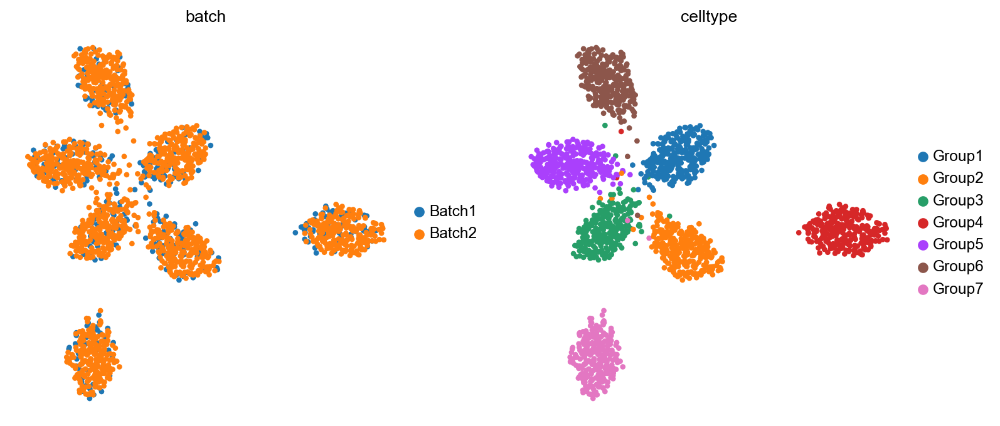

15


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.348698
cASW                        0.605119
F1 ASW                      0.442441
bLISI                       0.116792
1-cLISI                     0.976542
F1 LISI                     0.208632
kBET Accept Rate            0.336671
graph connectivity          0.996944
ARI                         0.956405
NMI                         0.943058
CC score                         NaN
HVG score                   0.676000
knn sim                     0.137335
cell-cell sim preservation  0.713145
exp sim                     0.811975
pos rate                    0.988253
true pos rate               0.908580
DEG precision               0.257878
DEG recall                  0.069958
DEG F1                      0.109823
Avg score (batch)           0.541537
Avg score (bio)             0.691766
Weighted score              0.631674




batch1_500 200




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 2553
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 127650.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6845, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0055, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-21.7865, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(6.9674, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-20.7571, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(3.3494, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-20.9352, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(1.8280, device='cuda:0', grad_fn=<Ne

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

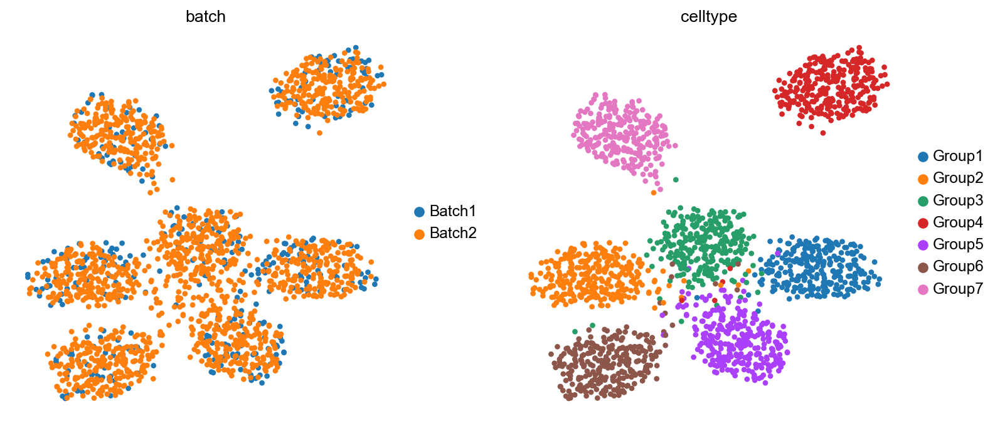

15


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.330675
cASW                        0.582442
F1 ASW                      0.421850
bLISI                       0.108663
1-cLISI                     0.950076
F1 LISI                     0.195021
kBET Accept Rate            0.273132
graph connectivity          0.996941
ARI                         0.908380
NMI                         0.892694
CC score                         NaN
HVG score                   0.658000
knn sim                     0.130638
cell-cell sim preservation  0.702854
exp sim                     0.750966
pos rate                    0.963739
true pos rate               0.955056
DEG precision               0.335108
DEG recall                  0.057071
DEG F1                      0.097254
Avg score (batch)           0.532894
Avg score (bio)             0.663704
Weighted score              0.611380




batch1_500 300




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 2553
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 127650.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.6845, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0055, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-21.7865, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(6.9674, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-20.7571, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(3.3494, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-20.9352, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(1.8280, device='cuda:0', grad_fn=<Ne

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

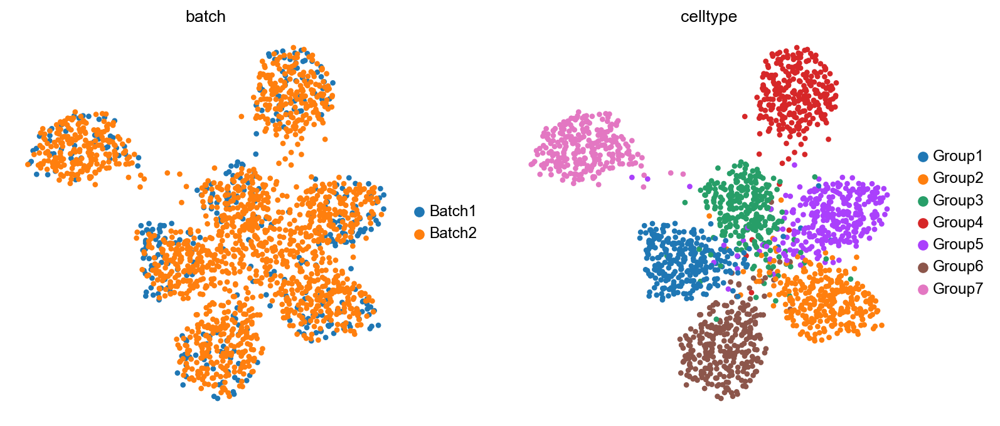

15


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.318031
cASW                        0.570611
F1 ASW                      0.408425
bLISI                       0.092990
1-cLISI                     0.918307
F1 LISI                     0.168878
kBET Accept Rate            0.241250
graph connectivity          0.990717
ARI                         0.822247
NMI                         0.810766
CC score                         NaN
HVG score                   0.661000
knn sim                     0.125804
cell-cell sim preservation  0.699849
exp sim                     0.714066
pos rate                    0.923391
true pos rate               0.912666
DEG precision               0.381893
DEG recall                  0.052783
DEG F1                      0.092392
Avg score (batch)           0.511131
Avg score (bio)             0.633843
Weighted score              0.584758




batch1_250 50




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 1752
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 87600.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.5992, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0001, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

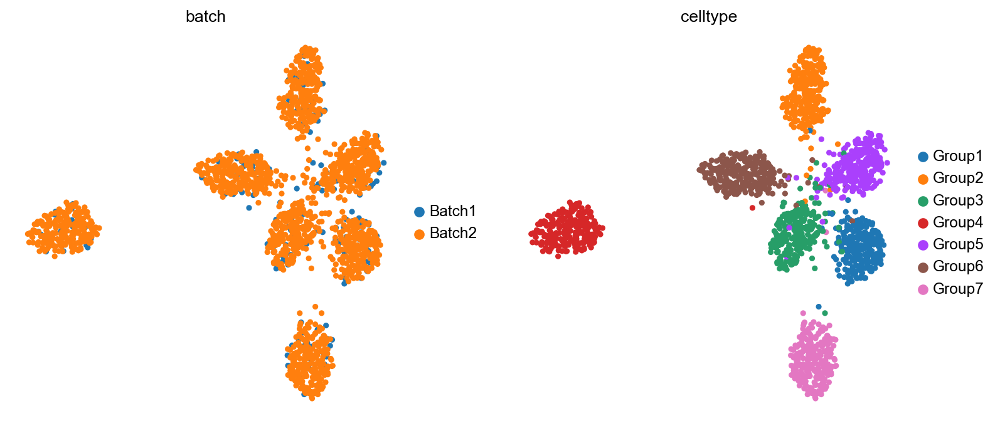

15


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.298024
cASW                        0.610308
F1 ASW                      0.400485
bLISI                       0.017847
1-cLISI                     0.974354
F1 LISI                     0.035052
kBET Accept Rate            0.447749
graph connectivity          0.992591
ARI                         0.932489
NMI                         0.918695
CC score                         NaN
HVG score                   0.696000
knn sim                     0.157996
cell-cell sim preservation  0.719251
exp sim                     0.853822
pos rate                    0.973311
true pos rate               0.910846
DEG precision               0.204425
DEG recall                  0.064651
DEG F1                      0.097933
Avg score (batch)           0.533411
Avg score (bio)             0.693416
Weighted score              0.629414




batch1_250 100




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 1752
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 87600.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.5992, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0001, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-26.0860, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(9.2995, device='cuda:0', grad_fn=<NegBackward0>)
Train step finished
###################### Finish Training ###########################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

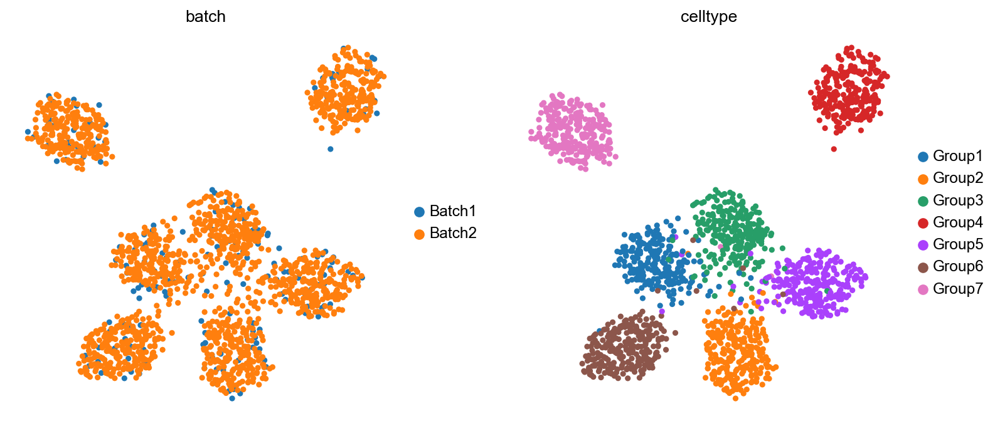

15


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.303774
cASW                        0.597477
F1 ASW                      0.402769
bLISI                       0.023125
1-cLISI                     0.963849
F1 LISI                     0.045167
kBET Accept Rate            0.520317
graph connectivity          0.993851
ARI                         0.903669
NMI                         0.886770
CC score                         NaN
HVG score                   0.684000
knn sim                     0.150980
cell-cell sim preservation  0.712999
exp sim                     0.785275
pos rate                    0.966496
true pos rate               0.962521
DEG precision               0.223851
DEG recall                  0.064033
DEG F1                      0.099197
Avg score (batch)           0.560718
Avg score (bio)             0.675071
Weighted score              0.629330




batch1_250 200




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 1752
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 87600.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.5992, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0001, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-26.0860, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(9.2995, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-25.4586, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(3.5833, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-26.2829, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.8625, device='cuda:0', grad_fn=<NegB

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

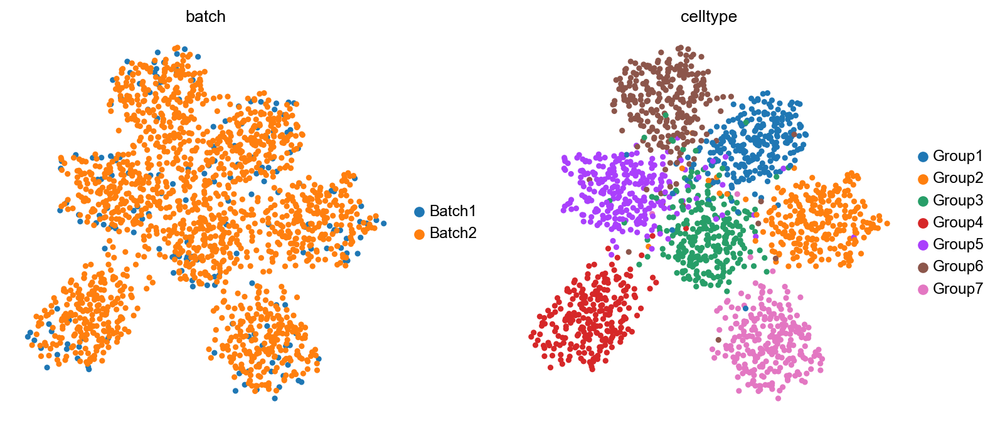

15


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.281299
cASW                        0.558693
F1 ASW                      0.374194
bLISI                       0.030897
1-cLISI                     0.889546
F1 LISI                     0.059720
kBET Accept Rate            0.508838
graph connectivity          0.987177
ARI                         0.765425
NMI                         0.740791
CC score                         NaN
HVG score                   0.663000
knn sim                     0.133964
cell-cell sim preservation  0.698725
exp sim                     0.709158
pos rate                    0.884725
true pos rate               0.884725
DEG precision               0.259125
DEG recall                  0.045258
DEG F1                      0.077006
Avg score (batch)           0.538587
Avg score (bio)             0.612103
Weighted score              0.582697




batch1_250 300




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################
Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 1752
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 87600.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.5992, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0001, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-26.0860, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(9.2995, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-25.4586, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(3.5833, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-26.2829, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.8625, device='cuda:0', grad_fn=<NegB

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

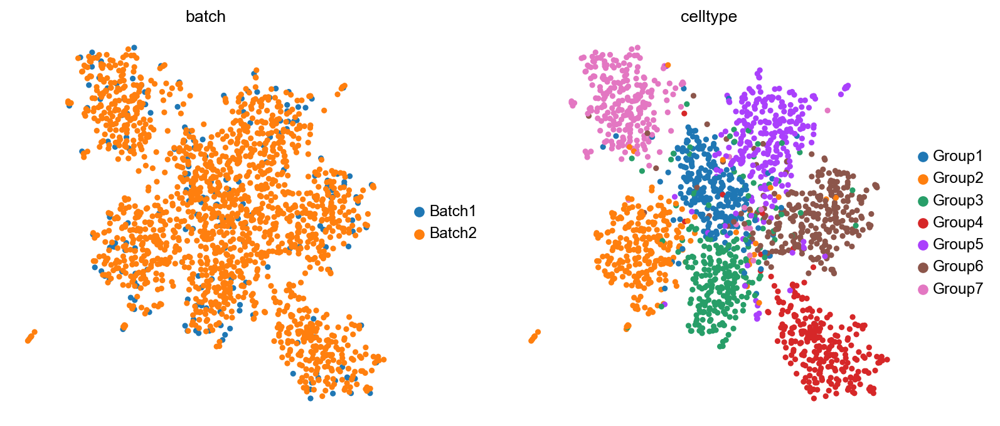

15


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.302523
cASW                        0.542022
F1 ASW                      0.388314
bLISI                       0.074906
1-cLISI                     0.881463
F1 LISI                     0.138078
kBET Accept Rate            0.568689
graph connectivity          0.946709
ARI                         0.652170
NMI                         0.656690
CC score                         NaN
HVG score                   0.661000
knn sim                     0.132300
cell-cell sim preservation  0.700142
exp sim                     0.661541
pos rate                    0.842135
true pos rate               0.839296
DEG precision               0.266096
DEG recall                  0.045512
DEG F1                      0.077606
Avg score (batch)           0.546425
Avg score (bio)             0.580707
Weighted score              0.566994


In [36]:
# 2022.5.9
folders = ['baseline', 'batch1_1000', 'batch1_500', 'batch1_250']
folders = ['rare1_0.5', 'rare1_0.2', 'rare1_0.1']
folders = ['baseline']
folders = ['baseline', 'rare1_0.5', 'rare1_0.2', 'rare1_0.1', 'common_5', 'common_3', 'common_1', 'batch1_1000', 'batch1_500', 'batch1_250']
simulation_list = ['Sim2']
epochs = [50, 100, 200, 300]
print(simulation_list)
for dataname in simulation_list:
    for folder in folders:
        # Parameters
        npcs = 20
        reduction='pca'
        mode='rwMNN'
        for epoch in epochs:
            print('\n')
            print('\n')
            print(folder, epoch)
            print('\n')
            if folder == 'baseline':
                adata = sc.read_loom('/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/Sim/%s/%s_raw.loom' % (dataname, dataname), 
                                     sparse=False)  #Load cell line dataset(-> count data). 
            else:
                adata = sc.read_loom('/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/Sim/%s/%s/%s_raw.loom' % (dataname, folder, dataname), 
                                     sparse=False)
            sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
            sc.pp.log1p(adata)

            adata_raw = adata.copy()
            adata_raw.raw = adata_raw
            sc.pp.scale(adata_raw, max_value=10)
            sc.tl.pca(adata_raw, 20, svd_solver='arpack')

            sc.pp.highly_variable_genes(adata, n_top_genes=2000, batch_key='batch')
            adata = adata[:, adata.var['highly_variable']]
            
#             if folder.startswith('common'):
#                 epoch = 200
#             elif folder == 'real':
#                 epoch = 300
#             else:
#                 epoch = 600
            adata_new = sequencing_train(adata, key='batch', epoch=epoch, batch=1024, reduction='pca', mode='rwMNN', 
                                     metric='angular', k1=10, k2=20, subsample=3000, opt='AdamW',
                                     filtering=False, lr=0.0001, b1=0.9)

            adata_new.raw = adata_new
            sc.pp.scale(adata_new, max_value=10)
            sc.tl.pca(adata_new, 20, svd_solver='arpack')
            sc.pp.neighbors(adata_new)
            sc.tl.umap(adata_new)
            sc.set_figure_params(figsize=(5,5),fontsize=12)
            sc.pl.umap(adata_new, color=['batch', 'celltype'], frameon=False)

            savepath = None
            DEGpath = '/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/Sim/%s/geneinfo.txt' % (dataname)
            res = calculate_metrics(adata_new, adata_raw=adata_raw, savepath=savepath, is_raw=False, is_embed=False, 
                                    embed='X_pca', is_simul=True, org='human', dataname=dataname, DEGpath=DEGpath,
                                   verbose=False)

            batch_metrics = ['1-bASW', 'bLISI', 'kBET Accept Rate', 'graph connectivity', 'true pos rate']
            bio_metrics = ['cASW', '1-cLISI', 'ARI', 'NMI', 'HVG score', 'knn sim', 
                           'cell-cell sim preservation', 'exp sim', 'pos rate', 'DEG F1']
            res['Avg score (batch)'] = res[batch_metrics].mean(1)
            res['Avg score (bio)'] = res[bio_metrics].mean(1)
            res['Weighted score'] = 0.4*res['Avg score (batch)'] + 0.6*res['Avg score (bio)']
            print(res.T)

In [ ]:
# Sim2 baseline
# lr=0.0002 epoch=300 b1=0.: .66 .64 .65
# lr=0.0001 epoch=300 b1=0.: .60 .67 .64
# lr=0.0002 epoch=300 b1=0.5: .64 .65 .64
# lr=0.0001 epoch=300 b1=0.5: .63 .67 .65
# lr=0.0001 epoch=300 b1=0.9: .70 .67 .68

In [13]:
np.sum(adata.X == 0)/np.prod(adata.shape)

ArrayView(0.23761775)

In [ ]:
# Sim1
# lr=0.0002 epoch=300 b1=0.: .44 .76 .63
# lr=0.0001 epoch=300 b1=0.: .44 .76 .63
# lr=0.0002 epoch=300 b1=0.5: .46 .76 .64
# lr=0.0001 epoch=300 b1=0.5: .28 .71 .54
# lr=0.0001 epoch=300 b1=0.9: .44 .75 .63

['Sim1']




rare1_0.5 None




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 2493
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 124650.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(-15.8775, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.9521, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-2.2846, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-24.5811, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(0.0185, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(8.1436, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-0.0538, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(15.0439, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  200
d step loss:  tensor(-0.2891, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tenso

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

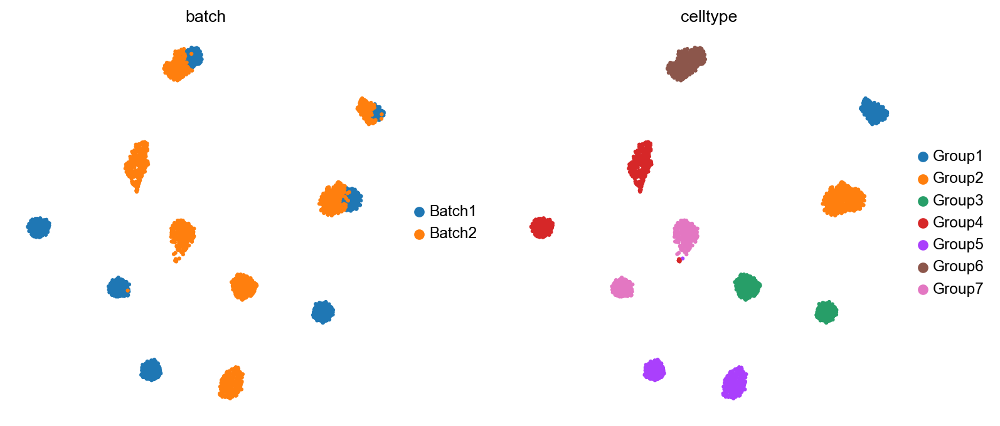

18


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.270966
cASW                        0.701911
F1 ASW                      0.390993
bLISI                       0.110042
1-cLISI                     0.999130
F1 LISI                     0.198249
kBET Accept Rate            0.073422
graph connectivity          0.928691
ARI                         0.777833
NMI                         0.895482
CC score                         NaN
HVG score                   0.704000
knn sim                     0.046698
cell-cell sim preservation  0.704890
exp sim                     0.990870
pos rate                    0.997837
true pos rate               0.094891
DEG precision               0.226910
DEG recall                  0.229734
DEG F1                      0.225859
Avg score (batch)           0.295602
Avg score (bio)             0.704451
Weighted score              0.540911




rare1_0.2 None




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 2478
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 123900.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(-14.7650, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.9871, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-1.5139, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.5828, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(5.9083, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(16.3610, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-0.3202, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(22.0585, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  200
d step loss:  tensor(1.0204, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

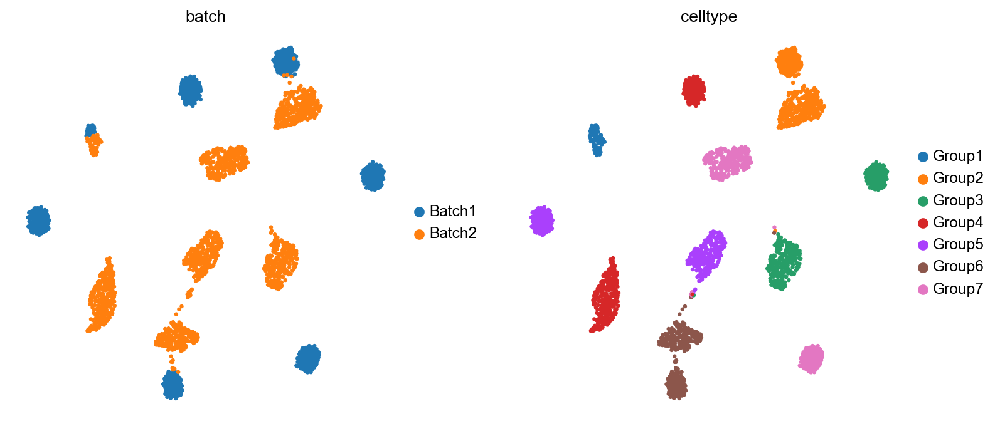

17


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.245015
cASW                        0.649303
F1 ASW                      0.355777
bLISI                       0.036210
1-cLISI                     0.998054
F1 LISI                     0.069885
kBET Accept Rate            0.022580
graph connectivity          0.717232
ARI                         0.624271
NMI                         0.838135
CC score                         NaN
HVG score                   0.674000
knn sim                     0.046470
cell-cell sim preservation  0.693913
exp sim                     0.988860
pos rate                    0.994317
true pos rate               0.049162
DEG precision               0.223165
DEG recall                  0.225645
DEG F1                      0.219362
Avg score (batch)           0.214040
Avg score (bio)             0.672668
Weighted score              0.489217




rare1_0.1 None




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 2429
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 121450.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(-16.8748, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.9961, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-1.5061, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-51.3390, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-0.1754, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(7.4982, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-0.3451, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(9.7824, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  200
d step loss:  tensor(-0.1919, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tenso

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

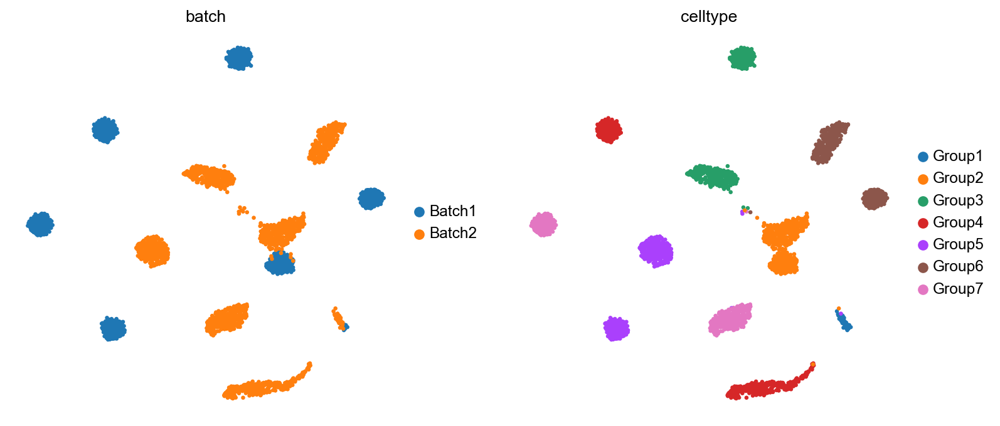

17


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.203384
cASW                        0.631242
F1 ASW                      0.307645
bLISI                       0.025096
1-cLISI                     0.997682
F1 LISI                     0.048961
kBET Accept Rate            0.017369
graph connectivity          0.716062
ARI                         0.708712
NMI                         0.859480
CC score                         NaN
HVG score                   0.674000
knn sim                     0.046979
cell-cell sim preservation  0.716047
exp sim                     0.986085
pos rate                    0.994796
true pos rate               0.023417
DEG precision               0.221678
DEG recall                  0.220650
DEG F1                      0.212269
Avg score (batch)           0.197066
Avg score (bio)             0.682729
Weighted score              0.488464


In [5]:
# 2022.5.6
folders = ['baseline', 'batch1_1000', 'batch1_500', 'batch1_250']
folders = ['rare1_0.5', 'rare1_0.2', 'rare1_0.1']
simulation_list = ['Sim1']
epochs = [None]
print(simulation_list)
for dataname in simulation_list:
    for folder in folders:
        # Parameters
        npcs = 20
        reduction='pca'
        mode='rwMNN'
        for epoch in epochs:
            print('\n')
            print('\n')
            print(folder, epoch)
            print('\n')
            if folder == 'baseline':
                adata = sc.read_loom('/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/Sim/%s/%s_raw.loom' % (dataname, dataname), 
                                     sparse=False)  #Load cell line dataset(-> count data). 
            else:
                adata = sc.read_loom('/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/Sim/%s/%s/%s_raw.loom' % (dataname, folder, dataname), 
                                     sparse=False)
            sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
            sc.pp.log1p(adata)

            adata_raw = adata.copy()
            adata_raw.raw = adata_raw
            sc.pp.scale(adata_raw, max_value=10)
            sc.tl.pca(adata_raw, 20, svd_solver='arpack')

            sc.pp.highly_variable_genes(adata, n_top_genes=2000, batch_key='batch')
            adata = adata[:, adata.var['highly_variable']]
            
            if folder.startswith('common'):
                epoch = 200
            elif folder == 'real':
                epoch = 300
            else:
                epoch = 600
            adata_new = sequencing_train(adata, key='batch', epoch=600, batch=1024, reduction='pca', mode='rwMNN', 
                                     metric='angular', k1=10, k2=20, subsample=3000, opt='AdamW',
                                     filtering=False, lr=0.001, b1=0.)

            adata_new.raw = adata_new
            sc.pp.scale(adata_new, max_value=10)
            sc.tl.pca(adata_new, 20, svd_solver='arpack')
            sc.pp.neighbors(adata_new)
            sc.tl.umap(adata_new)
            sc.set_figure_params(figsize=(5,5),fontsize=12)
            sc.pl.umap(adata_new, color=['batch', 'celltype'], frameon=False)

            savepath = None
            DEGpath = '/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/Sim/%s/geneinfo.txt' % (dataname)
            res = calculate_metrics(adata_new, adata_raw=adata_raw, savepath=savepath, is_raw=False, is_embed=False, 
                                    embed='X_pca', is_simul=True, org='human', dataname=dataname, DEGpath=DEGpath,
                                   verbose=False)

            batch_metrics = ['1-bASW', 'bLISI', 'kBET Accept Rate', 'graph connectivity', 'true pos rate']
            bio_metrics = ['cASW', '1-cLISI', 'ARI', 'NMI', 'HVG score', 'knn sim', 
                           'cell-cell sim preservation', 'exp sim', 'pos rate', 'DEG F1']
            res['Avg score (batch)'] = res[batch_metrics].mean(1)
            res['Avg score (bio)'] = res[bio_metrics].mean(1)
            res['Weighted score'] = 0.4*res['Avg score (batch)'] + 0.6*res['Avg score (bio)']
            print(res.T)

['Sim1']




rare1_0.5 None




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 2493
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 124650.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.1965, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0120, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-4.8381, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(1.1656, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-3.4455, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0518, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-2.7578, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-2.4933, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  200
d step loss:  tensor(-2.5950, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

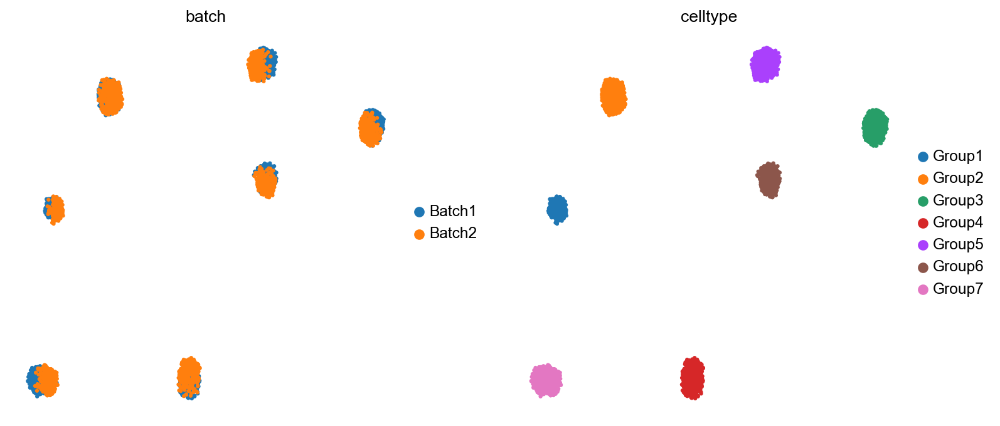

18


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.365176
cASW                        0.764526
F1 ASW                      0.494266
bLISI                       0.378484
1-cLISI                     0.999997
F1 LISI                     0.549130
kBET Accept Rate            0.204309
graph connectivity          1.000000
ARI                         0.999324
NMI                         0.998966
CC score                         NaN
HVG score                   0.785000
knn sim                     0.047875
cell-cell sim preservation  0.690178
exp sim                     0.986001
pos rate                    1.000000
true pos rate               0.328467
DEG precision               0.271860
DEG recall                  0.228866
DEG F1                      0.245662
Avg score (batch)           0.455287
Avg score (bio)             0.751753
Weighted score              0.633167




rare1_0.2 None




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 2478
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 123900.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.1528, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0156, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-5.1248, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(1.9380, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-3.3175, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.2837, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-2.7514, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.2005, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  200
d step loss:  tensor(-2.6139, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(2.

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

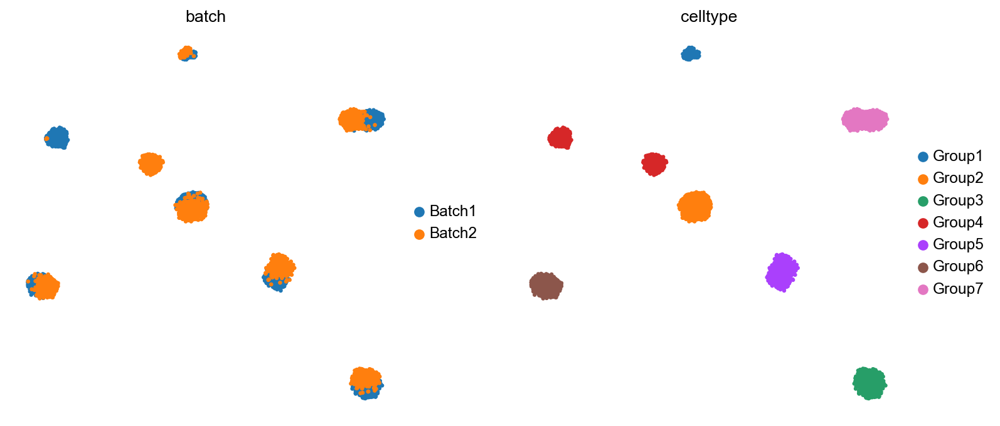

17


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.343996
cASW                        0.760598
F1 ASW                      0.473736
bLISI                       0.313022
1-cLISI                     0.999959
F1 LISI                     0.476791
kBET Accept Rate            0.177751
graph connectivity          1.000000
ARI                         0.942986
NMI                         0.968608
CC score                         NaN
HVG score                   0.790000
knn sim                     0.046965
cell-cell sim preservation  0.690105
exp sim                     0.988146
pos rate                    1.000000
true pos rate               0.270816
DEG precision               0.265777
DEG recall                  0.224143
DEG F1                      0.239141
Avg score (batch)           0.421117
Avg score (bio)             0.742651
Weighted score              0.614037




rare1_0.1 None




/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

The sequential mapping order will be:  ['Batch1', 'Batch2']
##########################Training Batch2#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 2429
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 121450.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.2024, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0149, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-4.9865, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(1.6228, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-3.5397, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(0.0463, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-2.9592, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-6.2600, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  200
d step loss:  tensor(-2.7283, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

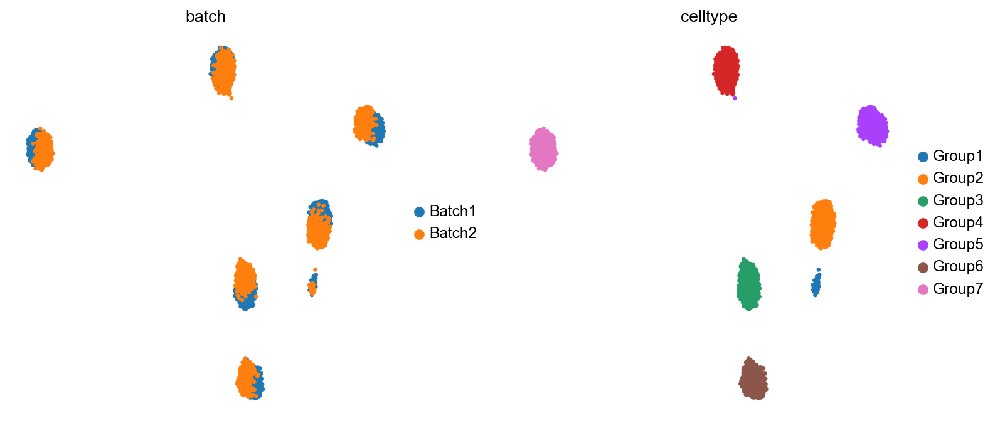

17


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


                                   0
1-bASW                      0.362441
cASW                        0.761375
F1 ASW                      0.491101
bLISI                       0.366417
1-cLISI                     0.998755
F1 LISI                     0.536139
kBET Accept Rate            0.227921
graph connectivity          1.000000
ARI                         0.998869
NMI                         0.997866
CC score                         NaN
HVG score                   0.802000
knn sim                     0.046983
cell-cell sim preservation  0.692198
exp sim                     0.985952
pos rate                    0.999422
true pos rate               0.336224
DEG precision               0.282436
DEG recall                  0.220219
DEG F1                      0.240863
Avg score (batch)           0.458601
Avg score (bio)             0.752428
Weighted score              0.634897


In [3]:
# 2022.5.3
folders = ['baseline', 'batch1_1000', 'batch1_500', 'batch1_250']
folders = ['rare1_0.5', 'rare1_0.2', 'rare1_0.1']
simulation_list = ['Sim1']
epochs = [None]
print(simulation_list)
for dataname in simulation_list:
    for folder in folders:
        # Parameters
        npcs = 20
        reduction='pca'
        mode='rwMNN'
        for epoch in epochs:
            print('\n')
            print('\n')
            print(folder, epoch)
            print('\n')
            if folder == 'baseline':
                adata = sc.read_loom('/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/Sim/%s/%s_raw.loom' % (dataname, dataname), 
                                     sparse=False)  #Load cell line dataset(-> count data). 
            else:
                adata = sc.read_loom('/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/Sim/%s/%s/%s_raw.loom' % (dataname, folder, dataname), 
                                     sparse=False)
            sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
            sc.pp.log1p(adata)

            adata_raw = adata.copy()
            adata_raw.raw = adata_raw
            sc.pp.scale(adata_raw, max_value=10)
            sc.tl.pca(adata_raw, 20, svd_solver='arpack')

            sc.pp.highly_variable_genes(adata, n_top_genes=2000, batch_key='batch')
            adata = adata[:, adata.var['highly_variable']]
            
            if folder.startswith('common'):
                epoch = 200
            elif folder == 'real':
                epoch = 300
            else:
                epoch = 600
            adata_new = sequencing_train(adata, key='batch', epoch=1000, batch=1024, reduction='pca', mode='rwMNN', 
                                     metric='angular', k1=10, k2=20, subsample=3000, opt='AdamW',
                                     filtering=False, lr=0.0001)

            adata_new.raw = adata_new
            sc.pp.scale(adata_new, max_value=10)
            sc.tl.pca(adata_new, 20, svd_solver='arpack')
            sc.pp.neighbors(adata_new)
            sc.tl.umap(adata_new)
            sc.set_figure_params(figsize=(5,5),fontsize=12)
            sc.pl.umap(adata_new, color=['batch', 'celltype'], frameon=False)

            savepath = None
            DEGpath = '/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/Sim/%s/geneinfo.txt' % (dataname)
            res = calculate_metrics(adata_new, adata_raw=adata_raw, savepath=savepath, is_raw=False, is_embed=False, 
                                    embed='X_pca', is_simul=True, org='human', dataname=dataname, DEGpath=DEGpath,
                                   verbose=False)

            batch_metrics = ['1-bASW', 'bLISI', 'kBET Accept Rate', 'graph connectivity', 'true pos rate']
            bio_metrics = ['cASW', '1-cLISI', 'ARI', 'NMI', 'HVG score', 'knn sim', 
                           'cell-cell sim preservation', 'exp sim', 'pos rate', 'DEG F1']
            res['Avg score (batch)'] = res[batch_metrics].mean(1)
            res['Avg score (bio)'] = res[bio_metrics].mean(1)
            res['Weighted score'] = 0.4*res['Avg score (batch)'] + 0.6*res['Avg score (bio)']
            print(res.T)

In [3]:
dataname = 'MCA'
folder = 'real'
npcs = 20
is_raw = False
is_embed = False
embed = 'X_pca'
if dataname.startswith('Sim'):
    is_simul = True
else:
    is_simul = False
if dataname in ['MCA', 'MouseRetina', 'MouseBrain', 'MHSP']:
    org = 'mouse'
else:
    org = 'human'

# Read data and preprocess
if folder != 'real':
    if folder == 'baseline':
        adata = sc.read_loom('/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/Sim/%s/%s_raw.loom' % (dataname, dataname), 
                             sparse=False)  #Load cell line dataset(-> count data). 
    else:
        adata = sc.read_loom('/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/Sim/%s/%s/%s_raw.loom' % (dataname, folder, dataname), 
                             sparse=False)  #Load cell line dataset(-> count data). 
else:
    if dataname == 'HCA' or dataname == 'MouseBrain':
        adata = sc.read_h5ad('/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/%s/%s_raw.h5ad' % (dataname, dataname))
    else:
        adata = sc.read_loom('/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/%s/%s_raw.loom' % (dataname, dataname), 
                             sparse=False)  #Load cell line dataset(-> count data).  
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
sc.pp.log1p(adata)

adata_raw = adata.copy()
adata_raw.raw = adata_raw
sc.pp.scale(adata_raw, max_value=10)
if 'X_pca' not in adata_raw.obsm.keys():
    try:
        adata_raw.obsm['X_pca'] = np.load('/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/%s/%s_raw_20pc.npy' % (dataname, dataname))
    except:
        sc.tl.pca(adata_raw, 20, svd_solver='arpack')

sc.pp.highly_variable_genes(adata, n_top_genes=2000, batch_key='batch')
adata = adata[:, adata.var['highly_variable']]

if isinstance(adata.X, scipy.sparse.csr.csr_matrix): 
    adata_new = sc.AnnData(adata.X.todense())
    adata_new.obs = adata.obs.copy()
    adata_new.obs_names = adata.obs_names
    adata_new.var_names = adata.var_names
    adata_new.obs_names.name = 'CellID'
    adata_new.var_names.name = 'Gene'
    del adata
    adata = adata_new

if folder.startswith('common'):
    epoch = 200
elif folder == 'real':
    epoch = 300
else:
    epoch = 600

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

In [4]:
# Run WGAN
adata_new = sequencing_train(adata, key='batch', epoch=600, batch=1024, reduction='pca', mode='rwMNN', 
                         metric='angular', subsample=3000, filtering=False, opt='AdamW', lr=0.0001)

The sequential mapping order will be:  ['Batch2_smartseq2', 'Batch1_microwellseq']
##########################Training Batch1_microwellseq#####################


/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


Calculating Anchor Pairs...
Calculating Query Pairs...
Calculating KNN Pairs...
Number of MNN pairs is 5153
Calculating Random Walk Pairs...
Done.
Dimension of paired data is 257650.
#################Finish Pair finding##########################
This is epoch:  0
d step loss:  tensor(7.8659, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-0.0093, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  50
d step loss:  tensor(-9.0443, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-3.5430, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  100
d step loss:  tensor(-9.7118, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-2.6086, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  150
d step loss:  tensor(-9.6493, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tensor(-2.2278, device='cuda:0', grad_fn=<NegBackward0>)
This is epoch:  200
d step loss:  tensor(-8.1353, device='cuda:0', grad_fn=<AddBackward0>)
g step loss:  tenso

/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/gpfs/gibbs/pi/zhao/yw599/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(na

[<AxesSubplot:title={'center':'batch'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'celltype'}, xlabel='UMAP1', ylabel='UMAP2'>]

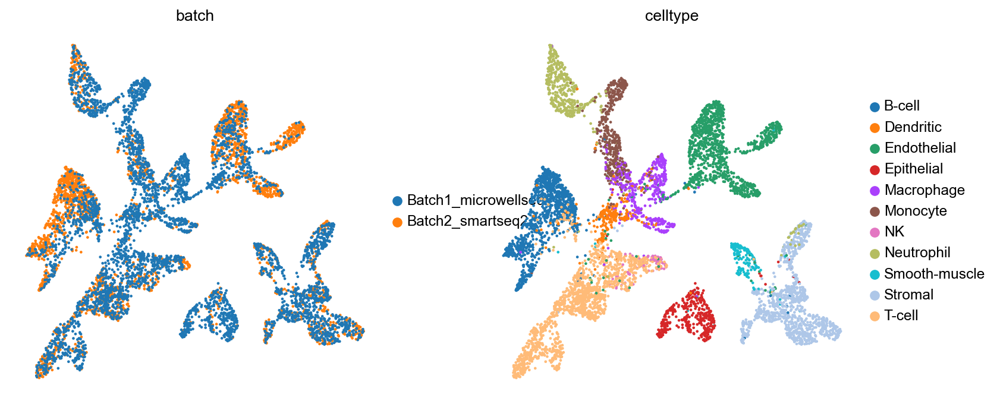

In [5]:
# Draw UMAP
adata_new.raw = adata_new
sc.pp.scale(adata_new, max_value=10)
sc.tl.pca(adata_new, 20, svd_solver='arpack')
sc.pp.neighbors(adata_new)
sc.tl.umap(adata_new)
sc.set_figure_params(figsize=(5,5),fontsize=12)
sc.pl.umap(adata_new, color=['batch', 'celltype'], frameon=False, show=False)

In [6]:
# Calculate metrics
adata_new = adata_new[adata_raw.obs_names, :].copy()
savepath = None
if dataname == 'HCA':
    adata_new.obs['celltype'] = 'NA'
    adata_new.obs['celltype'] = adata_new.obs['celltype'].astype('category')

if dataname == 'HCA':
    res=calculate_metrics(adata_new, adata_raw=adata_raw, celltype_key=None, savepath=savepath, is_raw=is_raw, 
                          is_embed=is_embed, embed=embed, is_simul=is_simul, org=org, dataname=dataname, 
                          subsample=0.1, seed=seed)
elif dataname == 'MouseBrain':
    res=calculate_metrics(adata_new, adata_raw=adata_raw, savepath=savepath, is_raw=is_raw, is_embed=is_embed, 
                          embed=embed, is_simul=is_simul, org=org, dataname=dataname, subsample=0.1, seed=seed)
elif folder == 'real':
    res=calculate_metrics(adata_new, adata_raw=adata_raw, savepath=savepath, is_raw=is_raw, is_embed=is_embed, embed=embed,
                      is_simul=is_simul, org=org, dataname=dataname)
else:  
    DEGpath = '/gpfs/gibbs/pi/zhao/yw599/AWGAN/datasets/Sim/%s/geneinfo.txt' % (dataname)
    res=calculate_metrics(adata_new, adata_raw=adata_raw, savepath=savepath, is_raw=is_raw, is_embed=is_embed, embed=embed,
                      is_simul=is_simul, org=org, dataname=dataname, DEGpath=DEGpath)


--------------------Start calculating ASW--------------------
cASW: 0.6219, 1-bASW: 0.3744, F1 ASW: 0.4674
--------------------Start calculating LISI--------------------
1-clisi: 0.9843, blisi: 0.4665, F1 lisi: 0.6330
--------------------Start calculating kBET--------------------
kBET: 0.4248
--------------------Start calculating graph connectivity--------------------
graph_conn: 0.8985
--------------------Start calculating NMI--------------------
NMI 0.7756
--------------------Start calculating ARI--------------------
ARI 0.6435
--------------------Start calculating positive and true positive rate--------------------
pos rate: 0.9234, true pos rate: 0.5486
--------------------Start calculating CC score--------------------


Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.


CC score 0.4684
--------------------Start calculating knn similarity--------------------
27
knn similarity 0.1874
--------------------Start calculating cell-cell similarity--------------------
Similarity of raw and corrected cell-cell similarity 0.8067
--------------------Start calculating expression similarity--------------------


/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:230: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_pre.X, scipy.sparse.csr.csr_matrix):
/gpfs/gibbs/pi/zhao/yw599/AWGAN/benchmark_scripts/metrics.py:234: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  if isinstance(adata_post.X, scipy.sparse.csr.csr_matrix):


exp similarity 0.7997
--------------------Start calculating HVG score--------------------
HVG score 0.7590
--------------------Combining results--------------------
--------------------Finished--------------------


In [7]:
# MCA, lr=0.0001, epoch=600, BN for both enc and dec
batch_metrics = ['1-bASW', 'bLISI', 'kBET Accept Rate', 'graph connectivity', 'true pos rate']
bio_metrics = ['cASW', '1-cLISI', 'ARI', 'NMI', 'HVG score', 'knn sim', 
               'cell-cell sim preservation', 'exp sim', 'pos rate', 'DEG F1']
res['Avg score (batch)'] = res[batch_metrics].mean(1)
res['Avg score (bio)'] = res[bio_metrics].mean(1)
res['Weighted score'] = 0.4*res['Avg score (batch)'] + 0.6*res['Avg score (bio)']
print(res.T)

                                   0
1-bASW                      0.374401
cASW                        0.621898
F1 ASW                      0.467408
bLISI                       0.466498
1-cLISI                     0.984349
F1 LISI                     0.633005
kBET Accept Rate            0.424847
graph connectivity          0.898469
ARI                         0.643543
NMI                         0.775592
CC score                    0.468420
HVG score                   0.759000
knn sim                     0.187360
cell-cell sim preservation  0.806683
exp sim                     0.799671
pos rate                    0.923353
true pos rate               0.548605
DEG precision                    NaN
DEG recall                       NaN
DEG F1                           NaN
Avg score (batch)           0.542564
Avg score (bio)             0.722383
Weighted score              0.650456


In [25]:
# HumanPBMC, lr=0.0001, epoch=200, BN for both enc and dec
batch_metrics = ['1-bASW', 'bLISI', 'kBET Accept Rate', 'graph connectivity', 'true pos rate']
bio_metrics = ['cASW', '1-cLISI', 'ARI', 'NMI', 'HVG score', 'knn sim', 
               'cell-cell sim preservation', 'exp sim', 'pos rate', 'DEG F1']
res['Avg score (batch)'] = res[batch_metrics].mean(1)
res['Avg score (bio)'] = res[bio_metrics].mean(1)
res['Weighted score'] = 0.4*res['Avg score (batch)'] + 0.6*res['Avg score (bio)']
print(res.T)

                                   0
1-bASW                      0.393368
cASW                        0.655619
F1 ASW                      0.491712
bLISI                       0.650892
1-cLISI                     0.993164
F1 LISI                     0.786400
kBET Accept Rate            0.429868
graph connectivity          0.962760
ARI                         0.754185
NMI                         0.831442
CC score                    0.858133
HVG score                   0.770000
knn sim                     0.139646
cell-cell sim preservation  0.829933
exp sim                     0.948372
pos rate                    0.977643
true pos rate               0.601964
DEG precision                    NaN
DEG recall                       NaN
DEG F1                           NaN
Avg score (batch)           0.607771
Avg score (bio)             0.766667
Weighted score              0.703109


In [20]:
# PBMC368k, lr=0.0001, epoch=200, BN for both enc and dec
batch_metrics = ['1-bASW', 'bLISI', 'kBET Accept Rate', 'graph connectivity', 'true pos rate']
bio_metrics = ['cASW', '1-cLISI', 'ARI', 'NMI', 'HVG score', 'knn sim', 
               'cell-cell sim preservation', 'exp sim', 'pos rate', 'DEG F1']
res['Avg score (batch)'] = res[batch_metrics].mean(1)
res['Avg score (bio)'] = res[bio_metrics].mean(1)
res['Weighted score'] = 0.4*res['Avg score (batch)'] + 0.6*res['Avg score (bio)']
print(res.T)

                                   0
1-bASW                      0.390055
cASW                        0.623493
F1 ASW                      0.479891
bLISI                       0.680442
1-cLISI                     0.976631
F1 LISI                     0.802066
kBET Accept Rate            0.581600
graph connectivity          0.933631
ARI                         0.840383
NMI                         0.792249
CC score                    0.737495
HVG score                   0.689000
knn sim                     0.068429
cell-cell sim preservation  0.805808
exp sim                     0.882256
pos rate                    0.931436
true pos rate               0.704830
DEG precision                    NaN
DEG recall                       NaN
DEG F1                           NaN
Avg score (batch)           0.658111
Avg score (bio)             0.734409
Weighted score              0.703890


In [16]:
# PBMC368k, lr=0.0001, epoch=400, BN for both enc and dec
batch_metrics = ['1-bASW', 'bLISI', 'kBET Accept Rate', 'graph connectivity', 'true pos rate']
bio_metrics = ['cASW', '1-cLISI', 'ARI', 'NMI', 'HVG score', 'knn sim', 
               'cell-cell sim preservation', 'exp sim', 'pos rate', 'DEG F1']
res['Avg score (batch)'] = res[batch_metrics].mean(1)
res['Avg score (bio)'] = res[bio_metrics].mean(1)
res['Weighted score'] = 0.4*res['Avg score (batch)'] + 0.6*res['Avg score (bio)']
print(res.T)

                                   0
1-bASW                      0.390850
cASW                        0.621824
F1 ASW                      0.479996
bLISI                       0.650852
1-cLISI                     0.977245
F1 LISI                     0.781332
kBET Accept Rate            0.578384
graph connectivity          0.937983
ARI                         0.825239
NMI                         0.785700
CC score                    0.758883
HVG score                   0.690000
knn sim                     0.070275
cell-cell sim preservation  0.808734
exp sim                     0.893892
pos rate                    0.931436
true pos rate               0.713454
DEG precision                    NaN
DEG recall                       NaN
DEG F1                           NaN
Avg score (batch)           0.654305
Avg score (bio)             0.733816
Weighted score              0.702012


In [12]:
# PBMC368k, lr=0.0001, epoch=300, BN for both enc and dec
batch_metrics = ['1-bASW', 'bLISI', 'kBET Accept Rate', 'graph connectivity', 'true pos rate']
bio_metrics = ['cASW', '1-cLISI', 'ARI', 'NMI', 'HVG score', 'knn sim', 
               'cell-cell sim preservation', 'exp sim', 'pos rate', 'DEG F1']
res['Avg score (batch)'] = res[batch_metrics].mean(1)
res['Avg score (bio)'] = res[bio_metrics].mean(1)
res['Weighted score'] = 0.4*res['Avg score (batch)'] + 0.6*res['Avg score (bio)']
print(res.T)

                                   0
1-bASW                      0.390013
cASW                        0.629617
F1 ASW                      0.481663
bLISI                       0.676274
1-cLISI                     0.979861
F1 LISI                     0.800242
kBET Accept Rate            0.637273
graph connectivity          0.921637
ARI                         0.849760
NMI                         0.801552
CC score                    0.668641
HVG score                   0.732000
knn sim                     0.076143
cell-cell sim preservation  0.819481
exp sim                     0.931291
pos rate                    0.940492
true pos rate               0.777706
DEG precision                    NaN
DEG recall                       NaN
DEG F1                           NaN
Avg score (batch)           0.680581
Avg score (bio)             0.751133
Weighted score              0.722912


In [7]:
# MHSP, lr=0.0002, epoch=300, BN for both enc and dec
batch_metrics = ['1-bASW', 'bLISI', 'kBET Accept Rate', 'graph connectivity', 'true pos rate']
bio_metrics = ['cASW', '1-cLISI', 'ARI', 'NMI', 'HVG score', 'knn sim', 
               'cell-cell sim preservation', 'exp sim', 'pos rate', 'DEG F1']
res['Avg score (batch)'] = res[batch_metrics].mean(1)
res['Avg score (bio)'] = res[bio_metrics].mean(1)
res['Weighted score'] = 0.4*res['Avg score (batch)'] + 0.6*res['Avg score (bio)']
print(res.T)

                                   0
1-bASW                      0.326721
cASW                        0.603962
F1 ASW                      0.424048
bLISI                       0.240554
1-cLISI                     0.909645
F1 LISI                     0.380489
kBET Accept Rate            0.192820
graph connectivity          0.817107
ARI                         0.566925
NMI                         0.517670
CC score                    0.833212
HVG score                   0.730000
knn sim                     0.295069
cell-cell sim preservation  0.726810
exp sim                     0.854787
pos rate                    0.742113
true pos rate               0.395315
DEG precision                    NaN
DEG recall                       NaN
DEG F1                           NaN
Avg score (batch)           0.394503
Avg score (bio)             0.660776
Weighted score              0.554267


In [72]:
# MHSP, lr=0.0001, epoch=300, BN for both enc and dec
batch_metrics = ['1-bASW', 'bLISI', 'kBET Accept Rate', 'graph connectivity', 'true pos rate']
bio_metrics = ['cASW', '1-cLISI', 'ARI', 'NMI', 'HVG score', 'knn sim', 
               'cell-cell sim preservation', 'exp sim', 'pos rate', 'DEG F1']
res['Avg score (batch)'] = res[batch_metrics].mean(1)
res['Avg score (bio)'] = res[bio_metrics].mean(1)
res['Weighted score'] = 0.4*res['Avg score (batch)'] + 0.6*res['Avg score (bio)']
print(res.T)

                                   0
1-bASW                      0.349743
cASW                        0.587721
F1 ASW                      0.438527
bLISI                       0.372529
1-cLISI                     0.876232
F1 LISI                     0.522793
kBET Accept Rate            0.458266
graph connectivity          0.708351
ARI                         0.416192
NMI                         0.476957
CC score                    0.667041
HVG score                   0.775000
knn sim                     0.270305
cell-cell sim preservation  0.706599
exp sim                     0.823129
pos rate                    0.637428
true pos rate               0.610182
DEG precision                    NaN
DEG recall                       NaN
DEG F1                           NaN
Avg score (batch)           0.499814
Avg score (bio)             0.618840
Weighted score              0.571230


In [60]:
# MHSP, lr=0.0001, epoch=300, BN for enc
batch_metrics = ['1-bASW', 'bLISI', 'kBET Accept Rate', 'graph connectivity', 'true pos rate']
bio_metrics = ['cASW', '1-cLISI', 'ARI', 'NMI', 'HVG score', 'knn sim', 
               'cell-cell sim preservation', 'exp sim', 'pos rate', 'DEG F1']
res['Avg score (batch)'] = res[batch_metrics].mean(1)
res['Avg score (bio)'] = res[bio_metrics].mean(1)
res['Weighted score'] = 0.4*res['Avg score (batch)'] + 0.6*res['Avg score (bio)']
print(res.T)

                                   0
1-bASW                      0.319059
cASW                        0.612318
F1 ASW                      0.419520
bLISI                       0.198615
1-cLISI                     0.911102
F1 LISI                     0.326134
kBET Accept Rate            0.149978
graph connectivity          0.814760
ARI                         0.513635
NMI                         0.538947
CC score                    0.828142
HVG score                   0.740000
knn sim                     0.291903
cell-cell sim preservation  0.740883
exp sim                     0.878554
pos rate                    0.751673
true pos rate               0.322419
DEG precision                    NaN
DEG recall                       NaN
DEG F1                           NaN
Avg score (batch)           0.360966
Avg score (bio)             0.664335
Weighted score              0.542987


In [55]:
# MCA, lr=0.0001, epoch=400, BN for enc
batch_metrics = ['1-bASW', 'bLISI', 'kBET Accept Rate', 'graph connectivity', 'true pos rate']
bio_metrics = ['cASW', '1-cLISI', 'ARI', 'NMI', 'HVG score', 'knn sim', 
               'cell-cell sim preservation', 'exp sim', 'pos rate', 'DEG F1']
res['Avg score (batch)'] = res[batch_metrics].mean(1)
res['Avg score (bio)'] = res[bio_metrics].mean(1)
res['Weighted score'] = 0.4*res['Avg score (batch)'] + 0.6*res['Avg score (bio)']
print(res.T)

                                   0
1-bASW                      0.379725
cASW                        0.623897
F1 ASW                      0.472108
bLISI                       0.516606
1-cLISI                     0.983232
F1 LISI                     0.677332
kBET Accept Rate            0.499625
graph connectivity          0.901994
ARI                         0.669681
NMI                         0.769045
CC score                    0.507092
HVG score                   0.748000
knn sim                     0.186445
cell-cell sim preservation  0.805450
exp sim                     0.791396
pos rate                    0.921340
true pos rate               0.650705
DEG precision                    NaN
DEG recall                       NaN
DEG F1                           NaN
Avg score (batch)           0.589731
Avg score (bio)             0.722054
Weighted score              0.669125


# MCA

In [17]:
# lr=0.0001, epoch=400
batch_metrics = ['1-bASW', 'bLISI', 'kBET Accept Rate', 'graph connectivity', 'true pos rate']
bio_metrics = ['cASW', '1-cLISI', 'ARI', 'NMI', 'HVG score', 'knn sim', 
               'cell-cell sim preservation', 'exp sim', 'pos rate', 'DEG F1']
res['Avg score (batch)'] = res[batch_metrics].mean(1)
res['Avg score (bio)'] = res[bio_metrics].mean(1)
res['Weighted score'] = 0.4*res['Avg score (batch)'] + 0.6*res['Avg score (bio)']
print(res.T)

                                   0
1-bASW                      0.377704
cASW                        0.622349
F1 ASW                      0.470103
bLISI                       0.488477
1-cLISI                     0.982364
F1 LISI                     0.652501
kBET Accept Rate            0.515503
graph connectivity          0.903454
ARI                         0.711083
NMI                         0.786615
CC score                    0.504024
HVG score                   0.728000
knn sim                     0.244145
cell-cell sim preservation  0.804529
exp sim                     0.812671
pos rate                    0.917314
true pos rate               0.700029
DEG precision                    NaN
DEG recall                       NaN
DEG F1                           NaN
Avg score (batch)           0.597033
Avg score (bio)             0.734341
Weighted score              0.679418


In [21]:
# lr=0.0001, epoch=300
batch_metrics = ['1-bASW', 'bLISI', 'kBET Accept Rate', 'graph connectivity', 'true pos rate']
bio_metrics = ['cASW', '1-cLISI', 'ARI', 'NMI', 'HVG score', 'knn sim', 
               'cell-cell sim preservation', 'exp sim', 'pos rate', 'DEG F1']
res['Avg score (batch)'] = res[batch_metrics].mean(1)
res['Avg score (bio)'] = res[bio_metrics].mean(1)
res['Weighted score'] = 0.4*res['Avg score (batch)'] + 0.6*res['Avg score (bio)']
print(res.T)

                                   0
1-bASW                      0.385439
cASW                        0.630945
F1 ASW                      0.478541
bLISI                       0.542494
1-cLISI                     0.981220
F1 LISI                     0.698696
kBET Accept Rate            0.618086
graph connectivity          0.890758
ARI                         0.709340
NMI                         0.788513
CC score                    0.493622
HVG score                   0.728000
knn sim                     0.239006
cell-cell sim preservation  0.803453
exp sim                     0.808806
pos rate                    0.912281
true pos rate               0.753667
DEG precision                    NaN
DEG recall                       NaN
DEG F1                           NaN
Avg score (batch)           0.638089
Avg score (bio)             0.733507
Weighted score              0.695340


In [11]:
# lr=0.0002, epoch=300
batch_metrics = ['1-bASW', 'bLISI', 'kBET Accept Rate', 'graph connectivity', 'true pos rate']
bio_metrics = ['cASW', '1-cLISI', 'ARI', 'NMI', 'HVG score', 'knn sim', 
               'cell-cell sim preservation', 'exp sim', 'pos rate', 'DEG F1']
res['Avg score (batch)'] = res[batch_metrics].mean(1)
res['Avg score (bio)'] = res[bio_metrics].mean(1)
res['Weighted score'] = 0.4*res['Avg score (batch)'] + 0.6*res['Avg score (bio)']
print(res.T)

                                   0
1-bASW                      0.381765
cASW                        0.628618
F1 ASW                      0.475036
bLISI                       0.516643
1-cLISI                     0.983456
F1 LISI                     0.677416
kBET Accept Rate            0.568482
graph connectivity          0.895100
ARI                         0.705615
NMI                         0.785527
CC score                    0.490669
HVG score                   0.744000
knn sim                     0.187533
cell-cell sim preservation  0.804084
exp sim                     0.784596
pos rate                    0.918033
true pos rate               0.710239
DEG precision                    NaN
DEG recall                       NaN
DEG F1                           NaN
Avg score (batch)           0.614446
Avg score (bio)             0.726829
Weighted score              0.681876


In [15]:
# lr=0.0001, epoch=200
batch_metrics = ['1-bASW', 'bLISI', 'kBET Accept Rate', 'graph connectivity', 'true pos rate']
bio_metrics = ['cASW', '1-cLISI', 'ARI', 'NMI', 'HVG score', 'knn sim', 
               'cell-cell sim preservation', 'exp sim', 'pos rate', 'DEG F1']
res['Avg score (batch)'] = res[batch_metrics].mean(1)
res['Avg score (bio)'] = res[bio_metrics].mean(1)
res['Weighted score'] = 0.4*res['Avg score (batch)'] + 0.6*res['Avg score (bio)']
print(res.T)

                                   0
1-bASW                      0.386484
cASW                        0.621142
F1 ASW                      0.476489
bLISI                       0.533190
1-cLISI                     0.983553
F1 LISI                     0.691509
kBET Accept Rate            0.610116
graph connectivity          0.885318
ARI                         0.670166
NMI                         0.781724
CC score                    0.489253
HVG score                   0.750000
knn sim                     0.189475
cell-cell sim preservation  0.802630
exp sim                     0.779479
pos rate                    0.918177
true pos rate               0.741444
DEG precision                    NaN
DEG recall                       NaN
DEG F1                           NaN
Avg score (batch)           0.631310
Avg score (bio)             0.721816
Weighted score              0.685614
